# Исследование данных о клиентах Благотворительного фонда АиФ

### О проекте
Благотворительный фонд АиФ Доброе сердце хочет лучше узнать своих благотворителей, чтобы максимально эффективно выстроить свою работу с ними.

### Задачи:
    • Изучить сегменты пользователей: RFM-анализ, описание сегментов; 
    • Вывести портрет типичного пользователя (пол, регион, прочие параметры);
    • исследовать каналы привлечения пользователей и их эффективность;
    • Узнать эффективность рассылок;
    • Вывести информацию об исторических пользователях.

### Для анализа представлены следующие данные:

    • данные о каналах привлечения пользователей;
    • кодировка каналов привлечения пользователей;
    • данные о платежах пользователей;
    • данные о пользователях;
    • данные об историческом импорте (давние пользователи).

# Оглавление
* [Шаг 1.Подготовка и очистка данных](#Шаг_1.Подготовка_и_очистка_данных)
   
* [Шаг 2.Исследовательский анализ данных](#Шаг_2.Исследовательский_анализ_данных)
* [Шаг 3. RFM - анализ](#Шаг_3._RFM_анализ)
* [Шаг 4. Когортный анализ](#Шаг_4._Когортный_анализ)
* [Шаг_5._Выводы](#Шаг_5._Выводы)
* [Шаг_6._Презентация](#Шаг_6._Презентация)

# Шаг 1.Подготовка и очистка данных <a class="anchor" id="Шаг_1.Подготовка_и_очистка_данных"></a>

In [5]:
#импортируем библиотеки
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px
import matplotlib.colors as mcolors
import os
import warnings

In [7]:
!pip -q install ydata-profiling
from ydata_profiling import ProfileReport

In [3]:
# Создадим функция для исследования данных.

def first_look_data(data):
    display(data.head())
    print('Колонки')
    print(data.columns)
#     Данный print позволяет красиво выделять данные,

    print(50*'-')
    print('Содержимое колонок')
    print(20*'*')

    for col in data:
        print(col)
# Не все колонки могут быть прочитаны
# unique и nunique
        try:
            print(data[col].unique())
            print(data[col].nunique())


        except TypeError:
            print('Списковое исключение')

            print(data[col][:5])



        print(20*'*')
    print('Общая информация')
    print(data.info())

    print(50*"-")
    print('Пропуски,%')
    print(round(data.isna().sum()/
          len(data[col])*100, 2))
    print(50*"-")

In [9]:
#чтобы показывались все столбцы
pd.set_option('display.max_columns', 40)

In [11]:

os.chdir(r'C:\Users\Elena\Documents\analitik\fond_blag\part_2')

In [13]:
#Откроем таблицу
df_donor = pd.read_csv('id_donor.csv', encoding='cp1251', sep=';')


In [8]:
#выведем информацию о данных
first_look_data(df_donor)

,CustomerCustomFieldsRecurrent = Рекуррент,CustomerCustomFieldsVolunteer = Волонтер да/нет,CustomerSex = Пол,CustomerAreaIdsExternalId = Идентификатор географической зоны клиента,CustomerAreaName = Название географической зоны клиента,CustomerIanaTimeZone = Часовой пояс,CustomerTimeZoneSource = Источник информации о часовом поясе,CustomerIdsMindboxId = Идентификатор Mindbox,CustomerIsEmailInvalid = Адрес электронной почты невалиден,CustomerChangeDateTimeUtc = Дата регистрации/редактирования в формате yyyy-MM-dd HH:mm:ss.fff,CustomerCustomerSubscriptionsDobroaifIsSubscribed = Подписка,CustomerCustomerSubscriptionsDobroaifSmsIsSubscribed = Подписка в точке контакта SMS,CustomerCustomerSubscriptionsDobroaifEmailIsSubscribed = Подписка в точке контакта Email,CustomerCustomerSubscriptionsDobroaifViberIsSubscribed = Подписка в точке контакта Viber,CustomerCustomerSubscriptionsDobroaifMobilePushIsSubscribed = Подписка в точке контакта MobilePush,CustomerCustomerSubscriptionsDobroaifWebPushIsSubscribed = Подписка в точке контакта WebPush
0,NaN,NaN,female,75,Ульяновская область,Europe/Samara,Определили в трекере,2734,False,21.05.2023 13:19,NaN,NaN,True,NaN,NaN,NaN
1,False,NaN,female,63,Санкт-Петербург и ЛО,Europe/Moscow,Определили в трекере,2847,False,24.12.2023 5:41,NaN,NaN,True,NaN,NaN,NaN
2,NaN,NaN,female,Москва и МО,Москва и МО,Europe/Moscow,Определили в трекере,2861,False,10.03.2023 8:16,NaN,True,True,NaN,NaN,NaN
3,NaN,NaN,female,60,Ростовская область,Europe/Moscow,Определили в трекере,3361,True,20.12.2022 9:36,NaN,NaN,False,NaN,NaN,NaN
4,False,NaN,male,31,Москва и МО,Europe/Moscow,Определили в трекере,4982,False,18.12.2023 19:43,NaN,NaN,True,NaN,NaN,NaN


Колонки
Index(['CustomerCustomFieldsRecurrent = Рекуррент',
       'CustomerCustomFieldsVolunteer =  Волонтер да/нет', 'CustomerSex = Пол',
       'CustomerAreaIdsExternalId = Идентификатор географической зоны клиента',
       'CustomerAreaName = Название географической зоны клиента',
       'CustomerIanaTimeZone = Часовой пояс',
       'CustomerTimeZoneSource = Источник информации о часовом поясе',
       'CustomerIdsMindboxId = Идентификатор Mindbox',
       'CustomerIsEmailInvalid = Адрес электронной почты невалиден',
       'CustomerChangeDateTimeUtc = Дата регистрации/редактирования в формате yyyy-MM-dd HH:mm:ss.fff',
       'CustomerCustomerSubscriptionsDobroaifIsSubscribed = Подписка',
       'CustomerCustomerSubscriptionsDobroaifSmsIsSubscribed = Подписка в точке контакта SMS',
       'CustomerCustomerSubscriptionsDobroaifEmailIsSubscribed = Подписка в точке контакта Email',
       'CustomerCustomerSubscriptionsDobroaifViberIsSubscribed = Подписка в точке контакта Viber',
     

В первой таблице id_donor видим 23820 строк и 16 колонок. Название колонок очень длинное, содержит и английские и расские буквы.  Идентификатор географической зоны клиента содержит значения и цифр и городов. Название географической зоны клиента 191 названий городов, которые можно проверить на наличие дублей. Есть столбцы содержащие True, False. В таблице много пропусков, которые нужно изучить. Столбец с датой переведем в нужный тип данных.

In [15]:
#переименуем колонки
df_donor = df_donor.rename(columns= {'CustomerCustomFieldsRecurrent = Рекуррент': 'recurrent', 
                                      'CustomerCustomFieldsVolunteer =  Волонтер да/нет': 'volunteer',
                                      'CustomerSex = Пол':'sex',
                                      'CustomerAreaIdsExternalId = Идентификатор географической зоны клиента':'area_id',
                                      'CustomerAreaName = Название географической зоны клиента':'area_name',
                                      'CustomerIanaTimeZone = Часовой пояс':'timezone',
                                      'CustomerTimeZoneSource = Источник информации о часовом поясе':'timezone_source',
                                      'CustomerIdsMindboxId = Идентификатор Mindbox':'mindbox_id',
                                      'CustomerIsEmailInvalid = Адрес электронной почты невалиден':'email_invalid',
                                      'CustomerChangeDateTimeUtc = Дата регистрации/редактирования в формате yyyy-MM-dd HH:mm:ss.fff':'datetime',
                                      'CustomerCustomerSubscriptionsDobroaifIsSubscribed = Подписка':'subs',
                                      'CustomerCustomerSubscriptionsDobroaifSmsIsSubscribed = Подписка в точке контакта SMS':'subs_sms',
                                      'CustomerCustomerSubscriptionsDobroaifEmailIsSubscribed = Подписка в точке контакта Email':'subs_email',
                                      'CustomerCustomerSubscriptionsDobroaifViberIsSubscribed = Подписка в точке контакта Viber':'subs_viber',
                                      'CustomerCustomerSubscriptionsDobroaifMobilePushIsSubscribed = Подписка в точке контакта MobilePush':'subs_mobile',
                                      'CustomerCustomerSubscriptionsDobroaifWebPushIsSubscribed = Подписка в точке контакта WebPush':'subs_web'})


In [17]:
#поменяем тип данных 
df_donor['datetime']  = pd.to_datetime(df_donor.datetime, dayfirst=True)
df_donor.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23820 entries, 0 to 23819
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   recurrent        5923 non-null   object        
 1   volunteer        6 non-null      object        
 2   sex              18715 non-null  object        
 3   area_id          5044 non-null   object        
 4   area_name        5044 non-null   object        
 5   timezone         11623 non-null  object        
 6   timezone_source  11623 non-null  object        
 7   mindbox_id       23820 non-null  int64         
 8   email_invalid    23396 non-null  object        
 9   datetime         23820 non-null  datetime64[ns]
 10  subs             20 non-null     object        
 11  subs_sms         44 non-null     object        
 12  subs_email       23478 non-null  object        
 13  subs_viber       20 non-null     object        
 14  subs_mobile      20 non-null     objec

In [19]:
#проверим на наличие явных дубликатов
print('Количество дубликатов:', df_donor.duplicated().sum())

Количество дубликатов: 0


In [22]:
#Откроем таблицу
df_import = pd.read_csv('import.csv', encoding='cp1251', sep=';')


In [12]:
#выведем информацию о данных
first_look_data(df_import)

,CustomerActionIdsMindboxId,CustomerActionActionTemplateIdsSystemName,CustomerActionActionTemplateName,CustomerActionDateTimeUtc,CustomerActionCreationDateTimeUtc,CustomerActionBrandIdsSystemName,CustomerActionChannelIdsMindboxId,CustomerActionChannelName,CustomerActionChannelIdsExternalId,CustomerActionChannelIdsSystemName,CustomerActionChannelUtmCampaign,CustomerActionChannelUtmSource,CustomerActionChannelUtmMedium,CustomerActionChannelUtmContent,CustomerActionChannelUtmTerm,CustomerActionCustomerIdsBackendID,CustomerActionCustomerIdsWebsiteID,CustomerActionCustomerIdsMindboxId
0,2734,ImportPriPerenoseIstoricheskoj,Импорт при переносе исторической базы клиентов,19.03.2022 21:30,19.03.2022 21:30,Dobroaif,9,Сайт,Site,Sajt,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2734
1,2847,ImportPriPerenoseIstoricheskoj,Импорт при переносе исторической базы клиентов,19.03.2022 21:31,19.03.2022 21:31,Dobroaif,9,Сайт,Site,Sajt,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2847
2,241801,ImportPriPerenoseIstoricheskoj,Импорт при переносе исторической базы клиентов,30.06.2022 11:10,30.06.2022 11:10,Dobroaif,9,Сайт,Site,Sajt,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2861
3,2861,ImportPriPerenoseIstoricheskoj,Импорт при переносе исторической базы клиентов,19.03.2022 21:31,19.03.2022 21:31,Dobroaif,9,Сайт,Site,Sajt,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2861
4,3361,ImportPriPerenoseIstoricheskoj,Импорт при переносе исторической базы клиентов,19.03.2022 21:31,19.03.2022 21:31,Dobroaif,9,Сайт,Site,Sajt,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3361


Колонки
Index(['CustomerActionIdsMindboxId',
       'CustomerActionActionTemplateIdsSystemName',
       'CustomerActionActionTemplateName', 'CustomerActionDateTimeUtc',
       'CustomerActionCreationDateTimeUtc', 'CustomerActionBrandIdsSystemName',
       'CustomerActionChannelIdsMindboxId', 'CustomerActionChannelName',
       'CustomerActionChannelIdsExternalId',
       'CustomerActionChannelIdsSystemName',
       'CustomerActionChannelUtmCampaign', 'CustomerActionChannelUtmSource',
       'CustomerActionChannelUtmMedium', 'CustomerActionChannelUtmContent',
       'CustomerActionChannelUtmTerm', 'CustomerActionCustomerIdsBackendID',
       'CustomerActionCustomerIdsWebsiteID',
       'CustomerActionCustomerIdsMindboxId'],
      dtype='object')
--------------------------------------------------
Содержимое колонок
********************
CustomerActionIdsMindboxId
[  2734   2847 241801 ... 168863 168727  11006]
7651
********************
CustomerActionActionTemplateIdsSystemName
['ImportPri

В таблице id_import видим 7651 строк и 18 колонок. Название колонок очень длинное.  В таблице есть пропуски, 7 колонок пустых, их можно удалить. Столбец с датой переведем в нужный тип данных.

In [24]:
#переименум колонки покороче
df_import = df_import.rename (columns= {'CustomerActionIdsMindboxId':'action_ids',
       'CustomerActionDateTimeUtc':'datetime_action',
       'CustomerActionCreationDateTimeUtc':'datetime_creation', 
       'CustomerActionChannelIdsMindboxId':'customer_ids', 
       'CustomerActionChannelName':'channel_name',
       'CustomerActionChannelIdsExternalId':'external_id',
       'CustomerActionChannelIdsSystemName':'system_name',
       'CustomerActionCustomerIdsMindboxId':'mindbox_id'}) 

In [26]:
#поменяем тип данных 
for col in ['datetime_action', 'datetime_creation']:
    df_import[col] = pd.to_datetime(df_import[col], dayfirst=True)

In [28]:
#удалим пустые колонки и не нужные колонки
df_import.drop([   
       'CustomerActionActionTemplateIdsSystemName',
       'CustomerActionBrandIdsSystemName',
       'CustomerActionActionTemplateName',
       'CustomerActionChannelUtmCampaign',
       'CustomerActionChannelUtmSource',
       'CustomerActionChannelUtmMedium', 
       'CustomerActionChannelUtmContent',
       'CustomerActionChannelUtmTerm', 
       'CustomerActionCustomerIdsBackendID',
       'CustomerActionCustomerIdsWebsiteID',
                                        ],axis=1,inplace = True)
df_import.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7651 entries, 0 to 7650
Data columns (total 8 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   action_ids         7651 non-null   int64         
 1   datetime_action    7651 non-null   datetime64[ns]
 2   datetime_creation  7651 non-null   datetime64[ns]
 3   customer_ids       7651 non-null   int64         
 4   channel_name       7651 non-null   object        
 5   external_id        7651 non-null   object        
 6   system_name        7651 non-null   object        
 7   mindbox_id         7651 non-null   int64         
dtypes: datetime64[ns](2), int64(3), object(3)
memory usage: 478.3+ KB


In [11]:
#проверим на наличие явных дубликатов
print('Количество дубликатов:', df_import.duplicated().sum())

Количество дубликатов: 0


In [30]:
#Откроем таблицу
df_order = pd.read_csv('order.csv', encoding='cp1251', sep=';',low_memory=False)


In [14]:
#выведем информацию о данных
first_look_data(df_order)

,OrderIdsMindboxId = Идентификатор Mindbox,OrderFirstActionIdsMindboxId = Идентификатор Mindbox,OrderFirstActionDateTimeUtc = Дата и время оформления заказа по UTC,OrderFirstActionChannelIdsMindboxId = Идентификатор Mindbox,OrderFirstActionChannelIdsExternalId = Внешний идентификатор точки контакта,OrderFirstActionChannelName = Имя точки контакта,OrderAreaIdsExternalId = Идентификатор географической зоны клиента,OrderTransactionIdsExternalId = Идентификатор транзакции,OrderTotalPrice = Стоимость заказа,OrderIdsWebsiteID = Идентификатор заказа на сайте,OrderCustomFieldsNewyear = newyear,OrderCustomFieldsNextPayDate = Дата след. Списания,OrderCustomFieldsRecurrent = Регулярный да/нет,OrderCustomFieldsRepayment = Повторный рекуррент,OrderLineProductIdsWebsite = Id продукта в Сайт,OrderLineProductName = Техническое название продукта,OrderLineQuantity = Количество единиц продукта,OrderLineBasePricePerItem = Базовая цена продукта за единицу продукта,OrderLinePriceOfLine = Конечная цена,OrderLineStatusIdsExternalId = Идентификатор статуса позиции заказа,OrderCustomerIdsMindboxId = Идентификатор Mindbox
0,14588,57400,27.01.2022 0:00,1,Administrator,Административный сайт Mindbox,NaN,NaN,500,1002892689,NaN,NaN,NaN,NaN,9847,Пожертвование Благотворительный фонд «АиФ. Доб...,1,NaN,500,Paid,6959
1,14756,57577,29.01.2022 0:00,1,Administrator,Административный сайт Mindbox,NaN,NaN,200,1004662779,NaN,NaN,NaN,NaN,9847,Пожертвование Благотворительный фонд «АиФ. Доб...,1,NaN,200,Paid,7103
2,14979,57807,31.01.2022 0:00,1,Administrator,Административный сайт Mindbox,NaN,NaN,300,1006728077,NaN,NaN,NaN,NaN,9847,Пожертвование Благотворительный фонд «АиФ. Доб...,1,NaN,300,Paid,7321
3,15101,57933,06.02.2022 0:00,1,Administrator,Административный сайт Mindbox,NaN,NaN,300,1011786329,NaN,NaN,NaN,NaN,9847,Пожертвование Благотворительный фонд «АиФ. Доб...,1,NaN,300,Paid,7143
4,16216,59062,28.02.2022 0:00,1,Administrator,Административный сайт Mindbox,NaN,NaN,50,1037151115,NaN,NaN,NaN,NaN,1,На уставную деятельность,1,NaN,50,Paid,7079


Колонки
Index(['OrderIdsMindboxId = Идентификатор Mindbox',
       'OrderFirstActionIdsMindboxId = Идентификатор Mindbox',
       'OrderFirstActionDateTimeUtc = Дата и время оформления заказа по UTC',
       'OrderFirstActionChannelIdsMindboxId = Идентификатор Mindbox',
       'OrderFirstActionChannelIdsExternalId = Внешний идентификатор точки контакта',
       'OrderFirstActionChannelName = Имя точки контакта',
       'OrderAreaIdsExternalId = Идентификатор географической зоны клиента',
       'OrderTransactionIdsExternalId = Идентификатор транзакции',
       'OrderTotalPrice = Стоимость заказа',
       'OrderIdsWebsiteID = Идентификатор заказа на сайте ',
       'OrderCustomFieldsNewyear = newyear',
       'OrderCustomFieldsNextPayDate = Дата след. Списания',
       'OrderCustomFieldsRecurrent = Регулярный да/нет',
       'OrderCustomFieldsRepayment = Повторный рекуррент',
       'OrderLineProductIdsWebsite = Id продукта в Сайт',
       'OrderLineProductName = Техническое название пр

В  таблице df_order видим 73763 строк и 21 колонок. Название колонок очень длинное, содержит и английские и расские буквы.  Идентификатор географической зоны клиента, Идентификатор транзакции, Дата след. Списания  пустые, их можно удалить. Id продукта в Сайт содержат и цифры и буквы. Есть столбцы содержащие True, False. В таблице много пропусков, которые нужно изучить. Столбец с датой переведем в нужный тип данных.

In [32]:
#переименуем колонки таблицы
df_order = df_order.rename(columns= {'OrderIdsMindboxId = Идентификатор Mindbox':'order_ids',
       'OrderFirstActionIdsMindboxId = Идентификатор Mindbox':'first_action_ids',
       'OrderFirstActionDateTimeUtc = Дата и время оформления заказа по UTC':'datetime',
       'OrderFirstActionChannelIdsMindboxId = Идентификатор Mindbox':'channel_ids',
       'OrderTotalPrice = Стоимость заказа':'total_price',
       'OrderCustomFieldsNewyear = newyear':'fields_newyear',                                
       'OrderCustomFieldsRecurrent = Регулярный да/нет':'recurrent',
       'OrderCustomFieldsRepayment = Повторный рекуррент':'repayment',                                                          
       'OrderLineProductName = Техническое название продукта':'product_name',
       'OrderLineStatusIdsExternalId = Идентификатор статуса позиции заказа':'status_ids',
       'OrderCustomerIdsMindboxId = Идентификатор Mindbox':'mindbox_id'})

In [34]:
#поменяем тип данных 
df_order['datetime'] =  pd.to_datetime(df_order.datetime, dayfirst=True)

In [36]:
#удалим пустые колонки
df_order.drop(['OrderLineProductIdsWebsite = Id продукта в Сайт',
               'OrderAreaIdsExternalId = Идентификатор географической зоны клиента',
               'OrderFirstActionChannelIdsExternalId = Внешний идентификатор точки контакта',
               'OrderLineBasePricePerItem = Базовая цена продукта за единицу продукта',
               'OrderLinePriceOfLine = Конечная цена',
               'OrderLineQuantity = Количество единиц продукта',
               'OrderIdsWebsiteID = Идентификатор заказа на сайте ',
               'OrderFirstActionChannelName = Имя точки контакта',
                'OrderTransactionIdsExternalId = Идентификатор транзакции',
        'OrderCustomFieldsNextPayDate = Дата след. Списания'],axis=1,inplace = True)
df_order.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73763 entries, 0 to 73762
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   order_ids         73763 non-null  int64         
 1   first_action_ids  73763 non-null  int64         
 2   datetime          73763 non-null  datetime64[ns]
 3   channel_ids       73763 non-null  int64         
 4   total_price       73763 non-null  int64         
 5   fields_newyear    1881 non-null   object        
 6   recurrent         61311 non-null  object        
 7   repayment         5970 non-null   object        
 8   product_name      73453 non-null  object        
 9   status_ids        73763 non-null  object        
 10  mindbox_id        73763 non-null  int64         
dtypes: datetime64[ns](1), int64(5), object(5)
memory usage: 6.2+ MB


In [38]:
#сократим строки в столбце
df_order['product_name'] = df_order['product_name'].str.\
                      replace('Пожертвование Благотворительный фонд «АиФ. Доброе сердце» ', '', regex=True)
#Добавим столбец год и месяц и час
df_order['year_month'] = pd.to_datetime(df_order['datetime']).dt.strftime('%Y-%m')
df_order['hour'] = pd.to_datetime(df_order['datetime']).dt.strftime('%H')

In [32]:
#проверим на наличие явных дубликатов
print('Количество дубликатов:', df_order.duplicated().sum())

Количество дубликатов: 0


In [40]:
#откроем файл и сохраним в таблицу
df_channels = pd.read_pickle("channels.pkl")


In [20]:
#выведем информацию о данных
first_look_data(df_channels)

,user_action,action_date,channel_id,utm_campaign,utm_source,utm_medium,user_id,action_time
0,Копия Фандрайзинговая. Максим Широкин,2022-12-20,3,NaN,NaN,NaN,2734,7
1,Копия Фандрайзинговая. Максим Широкин Не доста...,2022-12-20,3,NaN,NaN,NaN,2734,7
2,Копия Фандрайзинговая. Максим Широкин Отправка,2022-12-20,3,NaN,NaN,NaN,2734,7
3,Копия Копия Фандрайзинговая. Максим Широкин,2022-12-26,3,NaN,NaN,NaN,2734,11
4,Копия Копия Фандрайзинговая. Максим Широкин Не...,2022-12-26,3,NaN,NaN,NaN,2734,11


Колонки
Index(['user_action', 'action_date', 'channel_id', 'utm_campaign',
       'utm_source', 'utm_medium', 'user_id', 'action_time'],
      dtype='object')
--------------------------------------------------
Содержимое колонок
********************
user_action
['Копия Фандрайзинговая. Максим Широкин'
 'Копия Фандрайзинговая. Максим Широкин Не доставлено'
 'Копия Фандрайзинговая. Максим Широкин Отправка' ...
 'DOI Счастливые истории Запрос отписки'
 'Ежемесячный отчет для разовых. Январь 2024 Не отправлялось'
 'Спасибо за разовые пожертвования (повторные) Новый шаблон Не отправлялось']
1752
********************
action_date
[datetime.date(2022, 12, 20) datetime.date(2022, 12, 26)
 datetime.date(2023, 2, 8) ... datetime.date(2023, 11, 12)
 datetime.date(2023, 12, 16) datetime.date(2024, 1, 5)]
1169
********************
channel_id
[   3    1    9   99    5  333 1930   54  999  888   30  777  132   10
  444    8  222  555  300  100 5120  111]
22
********************
utm_campaign
[nan 'igna

In [42]:
#поменяем тип данных 
df_channels['action_date'] = pd.to_datetime(df_channels.action_date, dayfirst=True)
df_channels['action_time'] = df_channels['action_time']*pd.Timedelta(hours=1)
df_channels.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2864953 entries, 0 to 873421
Data columns (total 8 columns):
 #   Column        Dtype          
---  ------        -----          
 0   user_action   object         
 1   action_date   datetime64[ns] 
 2   channel_id    int64          
 3   utm_campaign  object         
 4   utm_source    object         
 5   utm_medium    object         
 6   user_id       int64          
 7   action_time   timedelta64[ns]
dtypes: datetime64[ns](1), int64(2), object(4), timedelta64[ns](1)
memory usage: 196.7+ MB


В таблице df_channels 2864953 строк и 8 колонок, которые переименовать не нужно. В столбцах utm_campaign,utm_medium, utm_source имеется много пропусков. Столбец с датой перевели в нужный формат.

In [44]:
#словарь с кодом каналов
channels_dict = {3: 'Email',
 1: 'Административный сайт Mindbox',
 9: 'Сайт',
 99: 'utm_term Не указан',
 5: 'Прямой переход',
 333: 'google.com',
 1930: 'b24portal.dobroe-aif.ru',
 54: 'org.telegram.messenger',
 999: 'yandex.ru',
 888: 'razovie',
 30: 'instagram.com',
 777: 'report',
 132: 'yoomoney.ru',
 10: 'vk.com',
 444: 'first-stage',
 8: 'WebPush',
 222: 'vse',
 555: 'roditeli',
 300: 'ida',
 100: 'ok.ru',
 5120: 'congratulations',
 111: 'lina'}

In [46]:
#сохраним ID импортированных клиентов
old_users = df_import.mindbox_id.unique().tolist()

In [48]:
df_donor['user_old'] = np.where(df_donor['mindbox_id'].isin(old_users)==True,1,0) 
df_donor['user_old'].value_counts()

user_old
0    16477
1     7343
Name: count, dtype: int64

Как видим, старых пользователей в таблице donor 7343 шт, а остальные 16477 человек новые

In [54]:
#создадим столбец, содержащий 1, если клиент старый
df_order['user_old'] = np.where(df_order['mindbox_id'].isin(old_users)==True,1,0)
df_order['user_old'].value_counts()

user_old
0    45299
1    28464
Name: count, dtype: int64

Старые пользователи в таблице order  вносили пожертвования 28464 раз, а остальные 45299

In [57]:
#создадим столбец, содержащий 1, если клиент старый
df_channels['user_old'] = np.where(df_channels['user_id'].isin(old_users)==True,1,0)
df_channels['user_old'].value_counts()

user_old
0    1802765
1    1062188
Name: count, dtype: int64

В таблице активности клиентов df_channel 1062188 действий старых пользователей, 1802765 - новых.

In [59]:
#добавим в таблицу данные о timezone
df_order = pd.merge(df_order, df_donor[['mindbox_id', 'timezone']],how="left", on='mindbox_id')
df_order.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73763 entries, 0 to 73762
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   order_ids         73763 non-null  int64         
 1   first_action_ids  73763 non-null  int64         
 2   datetime          73763 non-null  datetime64[ns]
 3   channel_ids       73763 non-null  int64         
 4   total_price       73763 non-null  int64         
 5   fields_newyear    1881 non-null   object        
 6   recurrent         61311 non-null  object        
 7   repayment         5970 non-null   object        
 8   product_name      73453 non-null  object        
 9   status_ids        73763 non-null  object        
 10  mindbox_id        73763 non-null  int64         
 11  year_month        73763 non-null  object        
 12  hour              73763 non-null  object        
 13  user_old          73763 non-null  int32         
 14  timezone          5482

# Шаг 2. Исследовательский анализ <a class="anchor" id="Шаг_2.Исследовательский_анализ_данных"></a>

In [59]:
#проведем исследовательский анализ df_donor
profile = ProfileReport(df_donor, title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Исследуя данные таблицу Доноров, видим, что много пропусков. 

- В столбце рекуррент всего 645 стоит - Да, 5278 -Нет, и больше 75% пропусков. 
- В столбце Волонтер всего 6 человек ими являются, остальные пропуски. Больше всего клиентов доноров Женщин, и 21,4% пропусков.
- В названиях городов клиентов почти 80% пропусков, из оставшихся преобладает, Москва, Санкт-Петербург, Vienna, уникальных значений 88 шт.
- В timezone меньше пропусков, но все равно половина данных отсутсвует. Из имеющихся преобладают клиентв из часового пояса Москвы, поменьше из asia/yekaterinburg . Уникальных значений поясов 31.
- Столбец как определили timezone тоже имеет больше половины пропусков, В основном определяли в трекере.
- Всего клиентов в  базе 23820 человек.
- Емайл 21474 клиентов рабочий, 1922 человека имеют ошибочный почтовый ящик и меньше 2% без емайла.
- Время регистрации/редактирования в базе клиентов начинается от 19 марта 2022 года до 18 марта 2024 года
- Мало пропусков в столбце подписки по Емайл , лишь 3202 человека отказались от рассылки новостей. В остальных подписках большие пропуски.
- Видим, что 7343 импортированных старых клиентов, остальные новые.
  


In [217]:
#проведем исследовательский анализ df_import
profile = ProfileReport(df_import, title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

По таблице импортированных клиентов отметим, что:

- В этой таблице 7651 клиент.
- период указан с Марта 2022 по июнь 2022г, в основном все в Марте
- Пришли почти все клиенты с сайта

In [246]:
#проведем исследовательский анализ df_order
profile = ProfileReport(df_order, title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

По таблице платежей отметим, что:

- всего за весь период прошло 73763 платежа
- Период указан с 1 января 2021 год по 18 марта 2024 год. по гистограмме видим, что число платежей увеличивается с каждым годом
- Указаны 80% платежей, связаны с каналом -Сайт, почти 20% сайт Mindbox.
- Есть в базе неудачные оплаты, которые имеют стоимость 0, их 10,2%. Максимальный платеж составляет 1 100 000. Среднее значение оплат составляет чуть больше 900. Медианное значение - 300. чуть больше 18% составляют платежи 500.
- repayment  содержит 3469 - Да, 2501 - Нет, и больше 90% пропуски
- По имени продукта чаще всего оплачивают - на уставную деятельность, пожертвование, Хочу помочь
- Все продукты продаются по одной единице.
- Оплаченных платежей 52058, ошибочных 6853, не оплаченных - 14852
- В оплатах учавствовало 21370 клиентов.
- Из них 28464 платежей совершили старые клиенты, 45299 -новые
- В столбце час видим большой пик в начале суток, видимо, овтоматические смписания у клиентов установленны на начало суток. Далее активны утренние часы и обеденные, к вечеру спад.
- timezone перенесли из таблицы доноров, в оплатах 25,7% пропусков. Также лидирует Москва 67,8%, далее Екатеринбург - 8,5%.

In [219]:
#проведем исследовательский анализ df_order
profile = ProfileReport(df_channels, title="Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

По таблице с каналами отметим, что:

- в столбце действия пользователя больше 6% составляет отправка, копия - 5,4%, франчайзинговая -5%, всего действий уникальных -1752
- дата активности также с 1 января 2021 до 18 марта 2024
- 22 канала в таблице, 74,4% - емайл, 19,4% -  Сайт
- в столбцах utm больше 90% пропусков
- в этой таблице 23820 клиента
- Больше 62% активности приходится на новых клиентов, остальное на старых

## Пользовательские метрики
### Как живет исторический импорт – это самые давние доноры:

- кто ушел и не проявляет активности;
- кто остался, активен, но не делает пожертвования;
- кто делает пожертвования (разово или рекуррент)
(Для анализа активности исторических пользователей берем 2024 год – есть активность или нет)

In [27]:
print('Число импортированных старых клиентов всего, шт:' , df_donor.query('user_old == 1')['mindbox_id'].nunique())

Число импортированных старых клиентов всего, шт: 7343


In [221]:
print('Число импортированных старых клиентов, которые делают пожертвования, шт:' ,df_order.\
                                  query('user_old == 1  & status_ids =="Paid"')['mindbox_id'].nunique())

Число импортированных старых клиентов, которые делают пожертвования, шт: 5529


In [222]:
print('Количество клиентов, которые активны, но не делают пожертвования, шт: {}'.\
             format(df_order.\
             loc[(df_order['user_old'] == 1) & (df_order['status_ids'] !="Paid")]['mindbox_id'].nunique()-
             len(np.intersect1d(df_order.query('user_old == 1  & status_ids =="Paid"')['mindbox_id'].unique(),\
            df_order. query('user_old == 1  & status_ids !="Paid"')['mindbox_id'].unique()))))

Количество клиентов, которые активны, но не делают пожертвования, шт: 80


In [223]:
 #посмотрим процент вимпортированных старых клиентов, которые делают пожертвования
print('Процент импортированных старых клиентов, которые делают пожертвования, от всех старых клиентов:', round(df_order.\
                                                      query('user_old == 1  & status_ids =="Paid"')['mindbox_id'].nunique()\
                                                      /df_donor.query('user_old == 1')['mindbox_id'].nunique()*100,2), '%')

Процент импортированных старых клиентов, которые делают пожертвования, от всех старых клиентов: 75.3 %


In [224]:
 #посмотрим процент импортированных старых клиентов, которые активны, но не делают пожертвования
print('Процент импортированных старых клиентов, которые активны, но не делают пожертвования:', round((df_order.\
             loc[(df_order['user_old'] == 1) & (df_order['status_ids'] !="Paid")]['mindbox_id'].nunique()-\
             len(np.intersect1d(df_order.query('user_old == 1  & status_ids =="Paid"')['mindbox_id'].unique(),\
            df_order. query('user_old == 1  & status_ids !="Paid"')['mindbox_id'].unique())))/df_donor.query('user_old == 1')['mindbox_id'].nunique()*100,2), '%')

Процент импортированных старых клиентов, которые активны, но не делают пожертвования: 1.09 %


In [225]:
 #посмотрим процент вимпортированных старых клиентов, которые ушли
print('Процент импортированных старых клиентов, которые ушли:', round(100-df_order.\
                                                      query('user_old == 1')['mindbox_id'].nunique()\
                                                      /df_donor.query('user_old == 1')['mindbox_id'].nunique()*100,2), '%')

Процент импортированных старых клиентов, которые ушли: 23.61 %


In [61]:
#выведем таблицу по количеству клиентов 
old_client_segment = pd.DataFrame({'Клиенты':['Платят','Ушли','Активны,но не платят'],\
                         'Количество':[5529,1734,80]})
old_client_segment

,Клиенты,Количество
0,Платят,5529
1,Ушли,1734
2,"Активны,но не платят",80


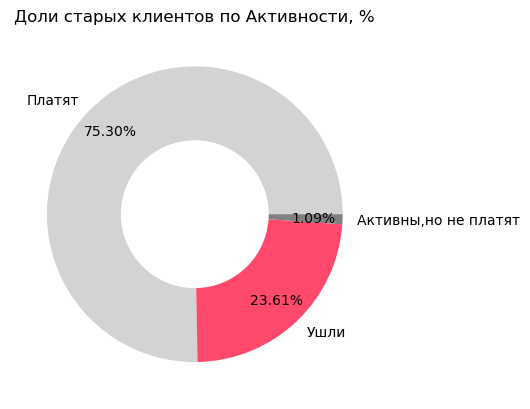

In [63]:
# рисуем круговую диаграмму
plt.pie(old_client_segment['Количество'],
        colors=['lightgrey', '#FF496C','grey'],
        labels= ['Платят','Ушли','Активны,но не платят'],
        autopct='%1.2f%%',
        pctdistance=0.8)

# добавляем дырку, чтобы получить кольцевую диаграмму
hole = plt.Circle((0, 0), 0.5, facecolor='white')
plt.gcf().gca().add_artist(hole)

plt.title('Доли старых клиентов по Активности, %')
plt.show()

Как видим, что от всех импортированных старых клиентов 75,3% активны и делают пожертвования, 1,09% активны, но не делают пожертвований и 23,61% ушли совсем.

In [69]:
print('Количество рекуррентов среди старых клиентов:', df_order.\
        query('recurrent == True & user_old == 1')['mindbox_id'].nunique())

Количество рекуррентов среди старых клиентов: 493


In [77]:
print('Процент рекуррентов среди старых клиентов, %:', round(df_order.\
        query('recurrent == True & user_old == 1')['mindbox_id'].nunique()/df_order.\
        query('user_old == 1')['mindbox_id'].nunique()*100, 2))

Процент рекуррентов среди старых клиентов, %: 8.79


In [93]:
print('Процент клиентов совершающих повторный платеж среди старых клиентов, %:', round(df_order.\
        query('repayment == True & user_old == 1')['mindbox_id'].nunique()/df_order.\
        query('user_old == 1')['mindbox_id'].nunique()*100, 2))

Процент клиентов совершающих повторный платеж среди старых клиентов, %: 4.4


In [91]:
print('Количество рекуррентов, совершающих повторный платеж, среди старых клиентов:',\
    df_order.loc[(df_order.recurrent == True) & (df_order.repayment == True) & (df_order.user_old == 1)]['mindbox_id'].nunique())

Количество рекуррентов, совершающих повторный платеж, среди старых клиентов: 247


**Доля рекурентов** в общей массе доноров составляет 8,79 процента (493 человек), людей, которых платят повторно 4,4 процента (причем все они являются реккурентами)

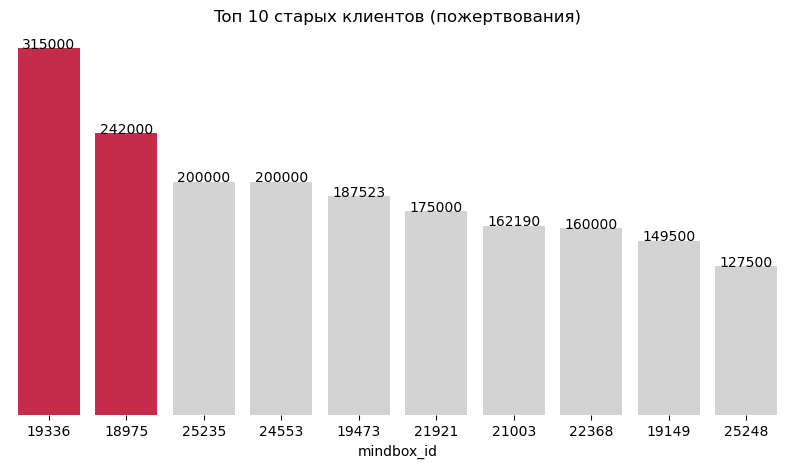

In [55]:
# задаем список цветов для графика (в нашем случае два)
colors = ['lightgrey'] * 10
colors[0], colors[1] = 'crimson', 'crimson'

# считаем параметры графика
plt.figure(figsize=(10, 5))
top_sales =df_order.query('user_old == 1 and status_ids == "Paid"').\
         groupby('mindbox_id', as_index=False)['total_price'].sum().sort_values(by='total_price', ascending=False).head(10)#nlargest(10, 'total_price')
top_customers = top_sales.mindbox_id.tolist()
sale_heights = top_sales.total_price.tolist()

# рисуем барплот
sns.barplot(data=top_sales,x='mindbox_id', y='total_price', palette=colors,  order=top_sales['mindbox_id'])

# добавляем подписи на бары (значения)
for i in range(len(top_customers)):
        plt.text(i,sale_heights[i]+100, int(sale_heights[i]), horizontalalignment='center')

# убираем ось У
ax = plt.gca ()
ax.get_yaxis().set_visible(False)

# убираем рамки
for spine in ['left', 'right', 'bottom', 'top']:
    ax.spines[spine].set_visible(False)

plt.title('Toп 10 старых клиентов (пожертвования)')
plt.show()

**По графику Toп 10 старых клиентов (пожертвования)** видим, что старые клиенты  активны, приблизительно от 100 000 до 300 000 суммы пожертвований за все время.

In [57]:
#создадим столбец с отметкой топ 10 старых клиентов
df_order['top_old'] = df_order.query('user_old == 1').\
          mindbox_id.apply(lambda cell: 'tops' if cell in top_customers else 'others')

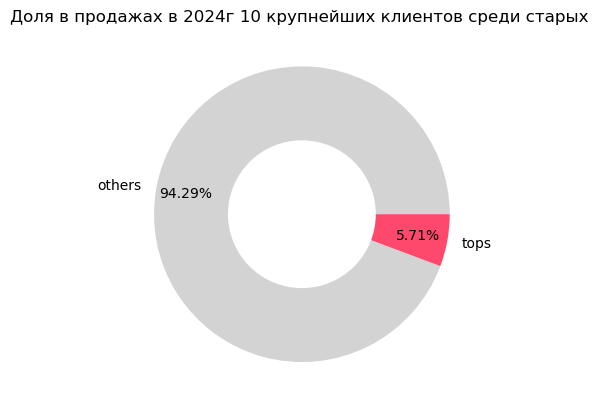

In [59]:
# рисуем круговую диаграмму
plt.pie( df_order.query('user_old == 1 and datetime>"2024-01-01" and status_ids == "Paid"').groupby('top_old')['total_price'].sum(),
        colors=['lightgrey', '#FF496C'],
        labels=['others', 'tops'],
        autopct='%1.2f%%',
        pctdistance=0.8)

# добавляем дырку, чтобы получить кольцевую диаграмму
hole = plt.Circle((0, 0), 0.5, facecolor='white')
plt.gcf().gca().add_artist(hole)

plt.title('Доля в продажах в 2024г 10 крупнейших клиентов среди старых ')
plt.show()

**По круговой диаграмме Доли в продажах  10 крупнейших клиентов среди старых** отметим, что эти 10 клиентов делают больше 5.71% пожертвований от всех старых доноров. 

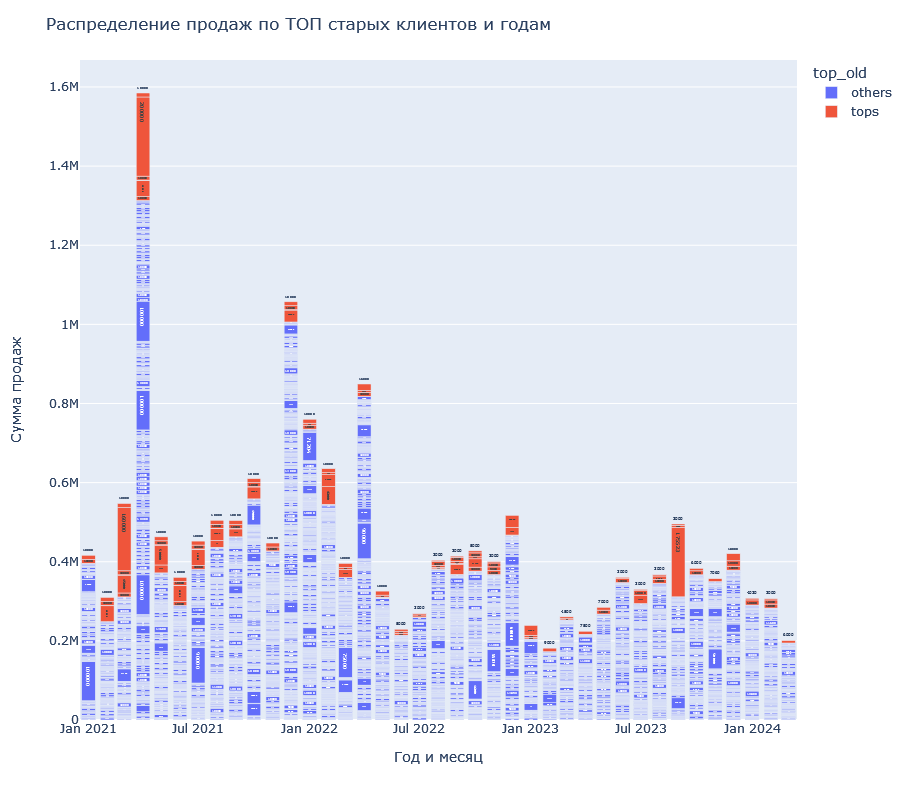

In [238]:
#построим график по сводной таблице - зависимости продаж по ID старых клиентов и годам

z =  df_order.query('user_old == 1 and status_ids == "Paid"').\
              groupby(['year_month', 'mindbox_id','top_old'], as_index=False)['total_price'].sum()

# строим график

fig = px.bar(data_frame=z,
             x='year_month',
             y='total_price',
             color='top_old',
             text='total_price'
            )

# оформляем график
fig.update_layout(xaxis={'categoryorder':'total descending'},
    title='Распределение продаж по ТОП старых клиентов и годам',
                   xaxis_title='Год и месяц',
                   yaxis_title='Сумма продаж',
                   width=1500, # указываем размеры графика
                   height=800)

fig.show() # выводим график

**По графику Распределения продаж по ТОП 10 старых клиентов и годам** видим, что 10 старых клиентов, которые больше всего вносили пожертвований.У всех старых клиентов сумма пожертвований в 2023-2024 году  превышает 400 000 только в сентябре и декабре 2023. Годами ранее были пики выше этой суммы.

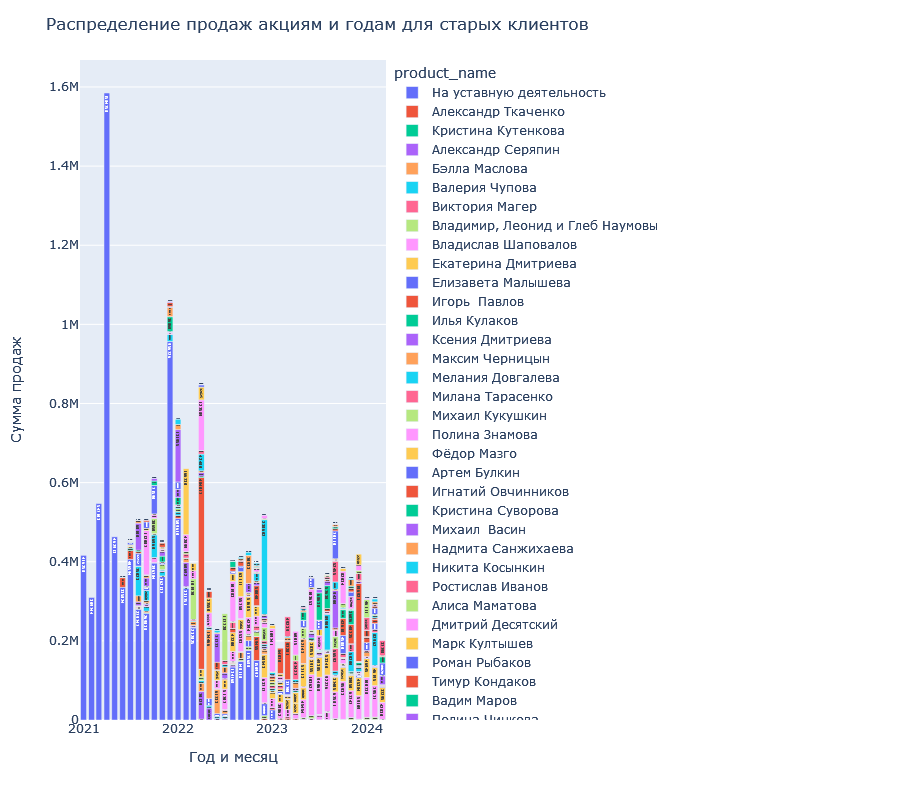

In [239]:
#построим график по сводной таблице - зависимости продаж по ID старых клиентов и годам

z =  df_order.query('user_old == 1 and status_ids == "Paid"').\
              groupby(['year_month', 'product_name'], as_index=False)['total_price'].sum()

# строим график

fig = px.bar(data_frame=z,
             x='year_month',
             y='total_price',
             color='product_name',
             text='total_price'
            )

# оформляем график
fig.update_layout(xaxis={'categoryorder':'total descending'},
    title='Распределение продаж акциям и годам для старых клиентов',
                   xaxis_title='Год и месяц',
                   yaxis_title='Сумма продаж',
                   width=1500, # указываем размеры графика
                   height=800)

fig.show() # выводим график

**По графику Распределение продаж акциям и годам для старых клиентов** видим, что с середины 2022 года разнообразие акций увеличилось и появились постоянные , например, Пожертвование "хочу помочь".

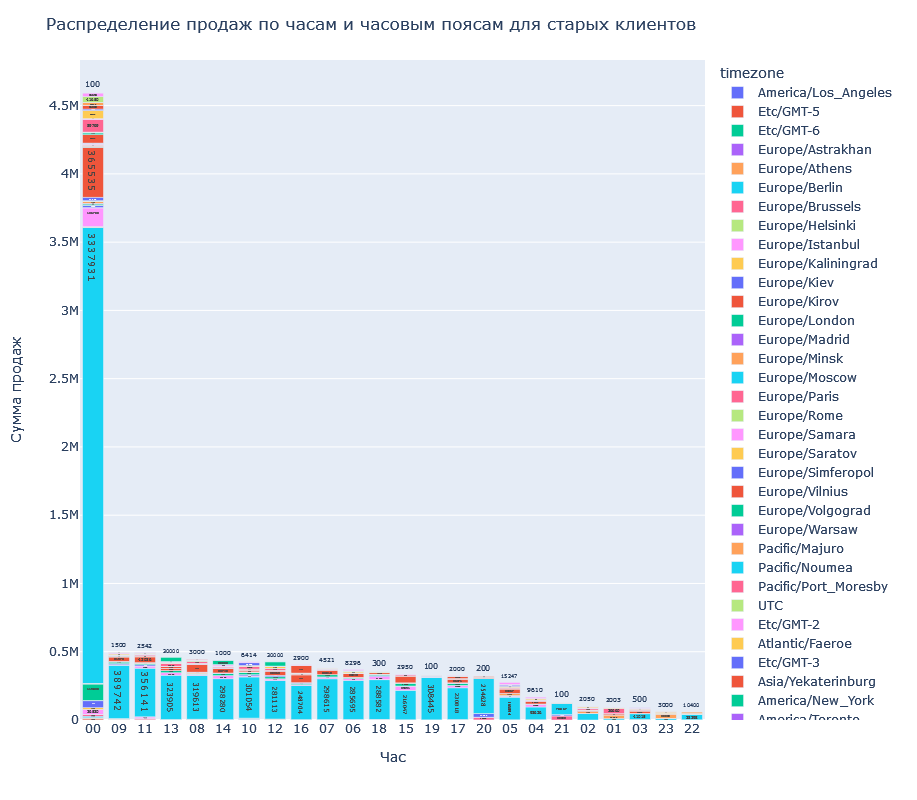

In [244]:
#построим график по сводной таблице - зависимости продаж по ID старых клиентов и годам

z =  df_order.query('user_old == 1 and status_ids == "Paid"').\
              groupby(['hour', 'timezone'], as_index=False)['total_price'].sum().sort_values(by='hour')

# строим график

fig = px.bar(data_frame=z,
             x='hour',
             y='total_price',
             color='timezone',
             text='total_price'
            )

# оформляем график
fig.update_layout(xaxis={'categoryorder':'total descending'},
    title='Распределение продаж по часам и часовым поясам для старых клиентов',
                   xaxis_title='Час',
                   yaxis_title='Сумма продаж',
                   width=1500, # указываем размеры графика
                   height=800)

fig.show() # выводим график

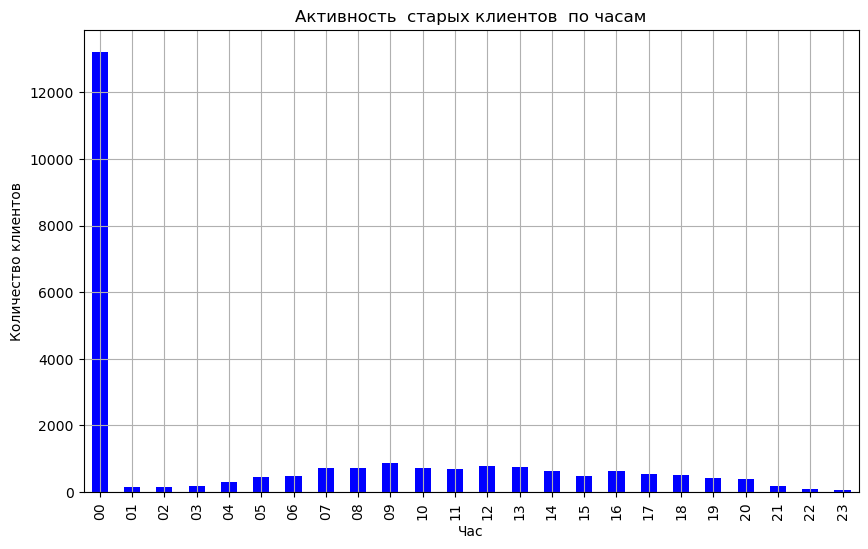

In [33]:
# Посмотрим число пожертвований по часам.

dat=df_order.query('user_old == 1 and status_ids == "Paid"')['hour'].sort_values().value_counts(sort=False)
dat.plot(kind='bar', grid=True, figsize=[10, 6],color = 'blue')
plt.title('Активность  старых клиентов  по часам')
plt.xlabel('Час')
plt.ylabel('Количество клиентов')
plt.show();

**По Активности  старых клиентов  по часам и графику Распределение продаж по часам и часовым поясам для старых клиентов** отметим, как уже отмечала ранее пик в начале суток, возможно, обусловленный настройкой авто списания сумм на пожертвование, причем много платежей с часовой зоны Москвы. Далее большая сумма пожертвований приходится на утренние часы, когда есть время перед работой и в 6 вечера, в конце рабочего дня. Максимальные суммы пожертвований приходится на часовой пояс Москвы, но напомню, что у половины клиентов в базе отсутствуют данные о часовой зоне а в таблице оплат  25,7% пропусков.

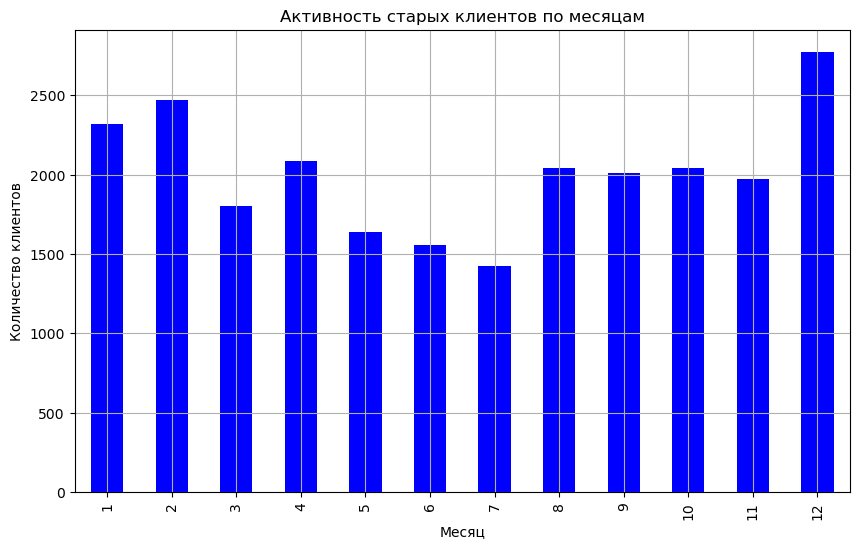

In [34]:
# Посмотрим число клиентов по месяцам.

dat = df_order.query('user_old == 1 and status_ids == "Paid"')['datetime']\
                                    .dt.month.sort_values().value_counts(sort=False)
dat.plot(kind='bar', grid=True, figsize=[10, 6],color = 'blue')
plt.title('Активность старых клиентов по месяцам')
plt.xlabel('Месяц')
plt.ylabel('Количество клиентов')
plt.show();

Больше всего активность старых клиентов  в зимние месяцы, особенно накануне нового года. Cпад активности приходится на май, июнь, июль, сезон шашлыков, отдыха, люди разъежаются.

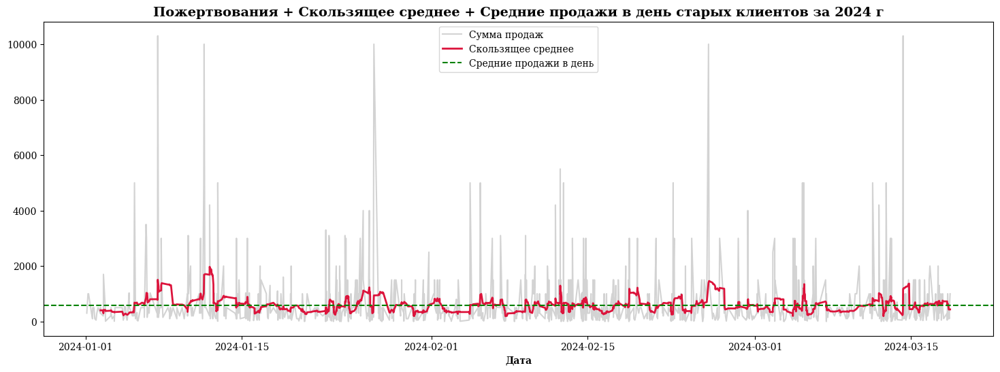

In [61]:
warnings.filterwarnings('ignore')
plt.figure(figsize=(18, 6))
# основной график продаж старых клиентов
(
    sns.lineplot(df_order.query('user_old == 1 and status_ids == "Paid" and datetime>"2024-01-01"').groupby('datetime')['total_price']
                 .sum(),
                 label='Сумма продаж',
                 color='lightgrey')
    )

# график продаж со скользящим средним (14 дней)
(
    sns.lineplot(df_order.query('user_old == 1 and status_ids == "Paid" and datetime>"2024-01-01"').groupby('datetime')['total_price']
                 .sum()
                 .rolling(14)
                 .mean(),
                 label='Скользящее среднее',
                 color='crimson',
                 linewidth=2)
    )

# линия средней дневной продажи
(
    plt.axhline(y=df_order.query('user_old == 1 and status_ids == "Paid" and datetime>"2024-01-01"').groupby('datetime').total_price.sum().mean(),
                linestyle='--',
                label='Средние продажи в день',
                color='green',
                linewidth=1.5)
    )

# легенда
plt.legend(prop={'family':'serif'})

# название графика
plt.title('Пожертвования + Скользящее среднее + Средние продажи в день старых клиентов за 2024 г', fontdict=dict(size=14, weight='bold', family='serif'))

# настройка осей графика
plt.xlabel('Дата', fontfamily='serif', fontweight='bold')
plt.ylabel('')
plt.xticks(fontfamily='serif')
plt.yticks(fontfamily='serif')

plt.show();

In [33]:
print('Средние продажи в день на 2024г у Старых клиентов', round(df_order.\
        query('user_old == 1 and status_ids == "Paid" and datetime>"2024-01-01"').groupby('datetime').total_price.sum().mean(),0))

Средние продажи в день на 2024г у Старых клиентов 590.0


**По графику Пожертвования + скользящее среднее старых клиентов за 2024 г** видно, что как средние продажи в день 590, как и скользящее среднее не превышает 2000. Максимальные пики пожертвований в январе 2024г, особенно в новогодние каникулы.

In [96]:
#создадим таблицу  сгруппированную по акциям, сумме покупок и числу  старых клиентов c 2023 года
final_sales = df_order.query('user_old == 1 and status_ids == "Paid" and datetime>"2023-01-01"').groupby('product_name').\
    agg({'datetime':'first', 'total_price':'sum', 'mindbox_id':'nunique'}) 
#выведем таблицу
final_sales.sort_values(final_sales.columns[-2], ascending=False)


,datetime,total_price,mindbox_id
product_name,,,
Пожертвование (хочу помочь),2023-05-28 05:42:00,944651,335
Пожертвование на уставную деятельность БФ «АиФ. Доброе сердце»,2023-03-14 18:01:00,545727,162
Артём Матвеев,2023-12-18 19:43:00,226451,242
Герман и Григорий Алымовы,2023-06-29 08:21:00,176693,180
Кира Моргунова,2024-02-21 06:46:00,163062,165
...,...,...,...
Елизавета Сазонова,2023-05-22 17:48:00,1200,1
Салават Багаутдинов,2023-02-13 13:25:00,900,2
Поможем жителям ДНР и ЛНР,2023-01-26 18:54:00,800,2


In [65]:
#для акций вычислим сумму покупок, период акции 
mean_price_one = (
    df_order.query('user_old == 1 and status_ids == "Paid" and datetime>"2023-01-01"').groupby('product_name')
    .agg({'total_price':'sum', 'datetime':lambda cell: (cell.max()-cell.min()).days+1})
    .reset_index().rename(columns={'total_price':'total_sales', 'datetime':'period'})
    )

In [67]:
#добавим столбец средней цены за день у каждой акции для старых клиентов
mean_price_one['efficiency/mean_price_per_day'] = (mean_price_one.total_sales / mean_price_one.period).round(2)

In [69]:
#выведем таблицу
mean_price_one.sort_values(mean_price_one.columns[-1], ascending=False)

,product_name,total_sales,period,efficiency/mean_price_per_day
6,Анастасия Лазгиян,25000,1,25000.00
21,Глеб Пестов,37798,8,4724.75
70,Руслан Сафронов,126268,34,3713.76
59,Никита Яковлев,118031,39,3026.44
46,Кристина Разживина,161451,60,2690.85
...,...,...,...,...
57,Никита Суриков,4500,277,16.25
34,Елизавета Сазонова,1200,154,7.79
32,Егор Цуканов,1850,282,6.56
81,Тимур Батуллин,1600,246,6.50


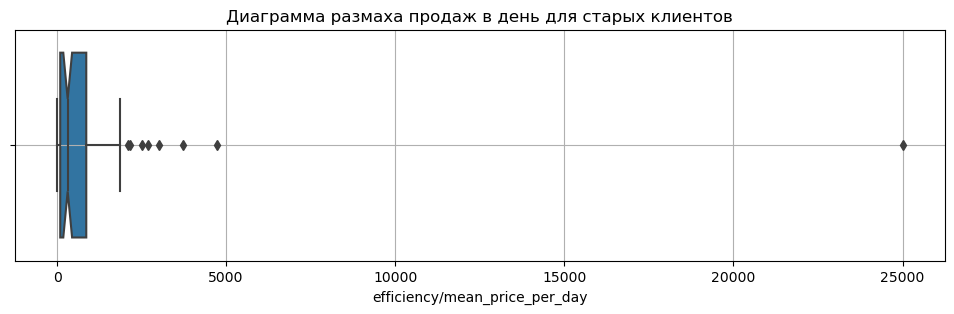

In [38]:
#построим диаграмму размаха
plt.figure(figsize=(12, 3))
sns.boxplot(x=mean_price_one['efficiency/mean_price_per_day'], notch=True)
plt.title('Диаграмма размаха продаж в день для старых клиентов')
plt.grid(True)
plt.show()

По Диаграмме размаха продаж в день для старых клиентов отметим, что есть аномальные значения продаж по акциям в день в районе 25000, по таблице выше видим, что это относится к акции "Анастасия Лазгиян", которая длилась один день и набрала такую сумму. Уберем аномальные значения через подсчет верхней границы и построим диаграмму размаха вновь.

In [87]:
#посчитаем границу выбросов для старых клиентов
q1 = mean_price_one['efficiency/mean_price_per_day'].quantile(0.25)
q3 = mean_price_one['efficiency/mean_price_per_day'].quantile(0.75)
max = q3+1.5*(q3-q1)
min = q3-1.5*(q3-q1)
print('Верхняя граница значений продаж акций в день:', max)
print('Нижняя граница значений продаж акций в день:', min)

Верхняя граница значений продаж акций в день: 2018.8425000000002
Нижняя граница значений продаж акций в день: -291.6825


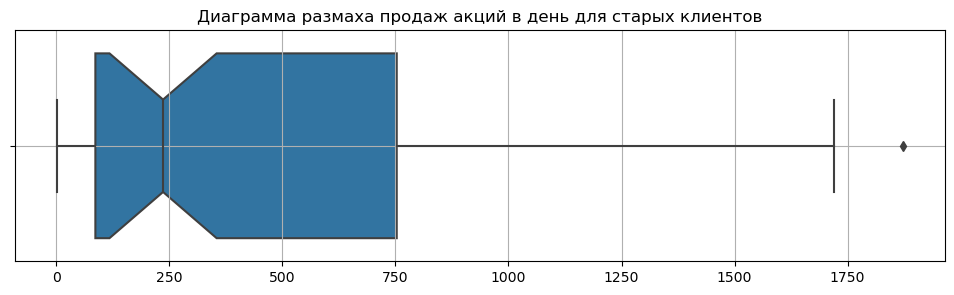

In [41]:
#построим диаграмму размаха без аномальных значений
plt.figure(figsize=(12, 3))
sns.boxplot(x=mean_price_one[mean_price_one['efficiency/mean_price_per_day']<max]\
                                 ['efficiency/mean_price_per_day'].tolist(), notch=True)
plt.title('Диаграмма размаха продаж акций в день для старых клиентов')
plt.grid(True)
plt.show()

In [42]:
#выведем основные значения
mean_price_one[mean_price_one['efficiency/mean_price_per_day']<max]\
                                 ['efficiency/mean_price_per_day'].describe()

count      78.000000
mean      435.635256
std       436.119244
min         2.040000
25%        86.597500
50%       236.260000
75%       752.947500
max      1871.500000
Name: efficiency/mean_price_per_day, dtype: float64

**По Диаграмме размаха продаж акций в день для старых клиентов без аномальных значений** видим скос влевую сторону,т.е половина акций имеют  среднее значение продаж в день до 236 руб.  75% акций имеют среднее значение продаж в день меньше 752. Максимальная граница значений продаж акций в день: 1871. Среднее по продажам акций в день составляет 435 руб.

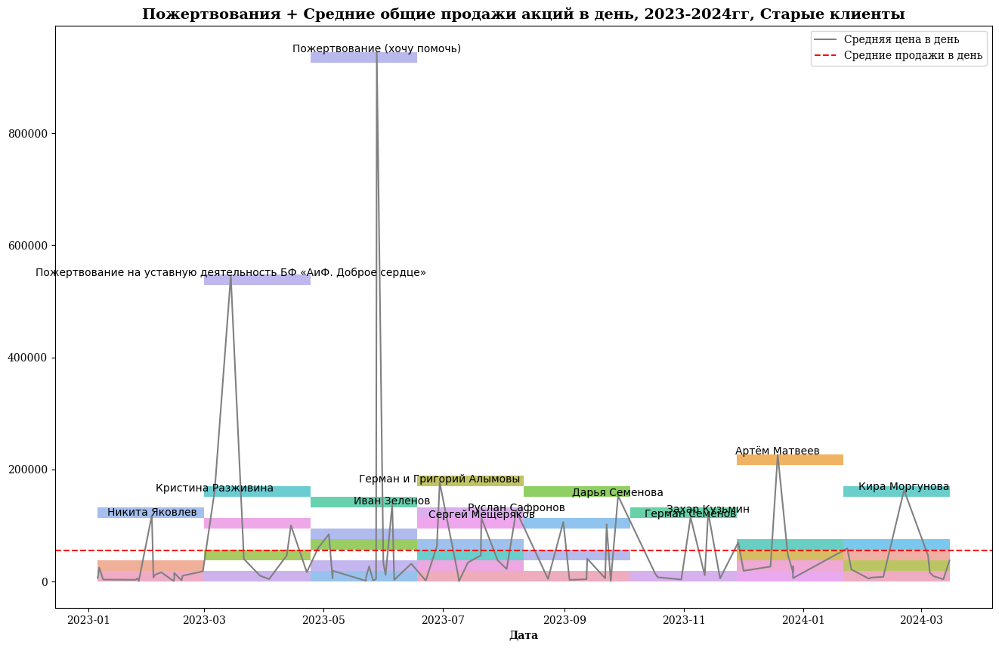

In [71]:

warnings.filterwarnings('ignore')
plt.figure(figsize=(16, 10))
# основной график продаж
(
    sns.lineplot(final_sales.groupby('datetime')['total_price']
                 .mean(),
                 label='Средняя цена в день',
                 color='Grey')
    )

# линия средней дневной продажи
(
    plt.axhline(y=final_sales.groupby('datetime').total_price.sum().mean(),
                linestyle='--',
                label='Средние продажи в день',
                color='red',
                linewidth=1.5)
   )

(
sns.histplot(data=final_sales, x = 'datetime',  y='total_price',  hue=final_sales.index,  multiple="stack", legend = False)
    )
# добавляем подписи на бары (значения)
for i in final_sales.query('total_price >110000').index:
        plt.text(final_sales.query('total_price >110000')['datetime'][i], final_sales.\
                          query('total_price >110000')['total_price'][i],i,horizontalalignment='center')

# легенда
plt.legend(prop={'family':'serif'})

# название графика
plt.title('Пожертвования + Средние общие продажи акций в день, 2023-2024гг, Старые клиенты', \
                                  fontdict=dict(size=14, weight='bold', family='serif'))

# настройка осей графика
plt.xlabel('Дата', fontfamily='serif', fontweight='bold')
plt.ylabel('')
plt.xticks(fontfamily='serif')
plt.yticks(fontfamily='serif')


plt.show()

In [47]:
print('Средние общие продажи по акциям в день на 2023-2024г у Старых клиентов',\
                              round(final_sales.groupby('datetime').total_price.sum().mean(),0))

Средние общие продажи по акциям в день на 2023-2024г у Старых клиентов 54793.0


**Данный график Пожертвования + Средние продажи в день, 2023-2024гг, Старые клиенты** отражает больше ситуацию по месяцам, через расчет среднего с группировкой по акциям.  Средние общие продажи по акциям в день 54793. Есть пики, превышающие средние продажи в день, выше всего пики пожертвование(Хочу помочь), на уставную деятельность. Из именных в конце декабря 2023 года набрала акция - Артема Матвеева- выше 200 000р, среди старых клиентов. Сильный провал в мае, сентября, связано с началом учебного года и затратами на подготовку к этому. В зимние месяцы наблюдается также провал.

In [256]:
#Выберем пять персональных акций и посмотрим как идет сбор средств: равномерно или есть пики
to_test_old = ['Герман и Григорий Алымовы', 'Кира Моргунова','Кристина Разживина', 'Дарья Семенова', 'Иван Зеленов']

In [258]:
#выведем таблицу пожертвований старых клиентов
test_ppl_old = df_order[df_order.product_name.isin(to_test_old)].\
          groupby(['product_name', 'datetime'])['total_price'].sum().reset_index()
test_ppl_old

,product_name,datetime,total_price
0,Герман и Григорий Алымовы,2023-06-16 17:41:00,300
1,Герман и Григорий Алымовы,2023-06-26 09:24:00,700
2,Герман и Григорий Алымовы,2023-06-26 09:25:00,700
3,Герман и Григорий Алымовы,2023-06-26 09:26:00,350
4,Герман и Григорий Алымовы,2023-06-26 09:27:00,600
...,...,...,...
4350,Кристина Разживина,2023-04-04 10:36:00,25000
4351,Кристина Разживина,2023-04-04 10:38:00,25000
4352,Кристина Разживина,2023-06-03 15:01:00,0
4353,Кристина Разживина,2023-06-05 21:43:00,500


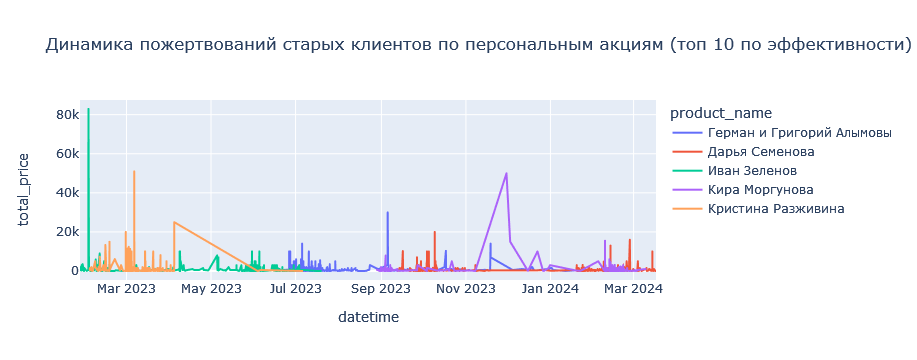

In [264]:
#выведем динамику пожертвований старых клиентов
px.line(test_ppl_old, x='datetime',
        y='total_price',
        color='product_name',
       title='Динамика пожертвований старых клиентов по персональным акциям (топ 10 по эффективности)')


Каких то явных закономерностей не видно, везде по разному:

    Дарья Семенова - пики в начале и в конце периода сборов
    Иван Зеленов, Кристина Разживина - большой донат в первые дни, потом спад
    Герман и Григорий Алымовы - несколько пиков за период сбора средств

## Проанализировать данные без исторических пользователей: 

Анализ без исторических пользователей покажет по каким каналам пришли новые доноры

In [48]:
#выведем число новых клиентов
print('Число  новых клиентов всего, шт:' , df_donor.query('user_old == 0')['mindbox_id'].nunique())

Число  новых клиентов всего, шт: 16477


In [49]:
#Число  новых клиентов, которые делают пожертвования
print('Число  новых клиентов, которые делают пожертвования, шт:' ,df_order.\
                                  query('user_old == 0  & status_ids =="Paid"')['mindbox_id'].nunique())

Число  новых клиентов, которые делают пожертвования, шт: 13192


In [50]:
#выведем Количество клиентов, которые активны, но не делают пожертвования
print('Количество клиентов, которые активны, но не делают пожертвования, шт: {}'.\
             format(df_order.\
             loc[(df_order['user_old'] == 0) & (df_order['status_ids'] !="Paid")]['mindbox_id'].nunique()-
             len(np.intersect1d(df_order.query('user_old == 0  & status_ids =="Paid"')['mindbox_id'].unique(),\
            df_order. query('user_old == 0  & status_ids !="Paid"')['mindbox_id'].unique()))))

Количество клиентов, которые активны, но не делают пожертвования, шт: 2569


In [51]:
 #посмотрим процент новых клиентов, которые делают пожертвования
print('Процент новых клиентов, которые делают пожертвования, от всех новых клиентов:', round(df_order.\
                                                      query('user_old == 0  & status_ids =="Paid"')['mindbox_id'].nunique()\
                                                      /df_donor.query('user_old == 0')['mindbox_id'].nunique()*100,2), '%')

Процент новых клиентов, которые делают пожертвования, от всех новых клиентов: 80.06 %


In [52]:
 #посмотрим процент новых клиентов, которые активны, но не делают пожертвования
print('Процент новых клиентов, которые активны, но не делают пожертвования:', round((df_order.\
             loc[(df_order['user_old'] == 0) & (df_order['status_ids'] !="Paid")]['mindbox_id'].nunique()-\
             len(np.intersect1d(df_order.query('user_old == 0  & status_ids =="Paid"')['mindbox_id'].unique(),\
            df_order. query('user_old == 0  & status_ids !="Paid"')['mindbox_id'].unique())))/df_donor.query('user_old == 0')['mindbox_id'].nunique()*100,2), '%')

Процент новых клиентов, которые активны, но не делают пожертвования: 15.59 %


In [53]:
 #посмотрим процент новых клиентов, которые ушли
print('Процент новых клиентов, которые ушли:', round(100-df_order.\
                                                      query('user_old == 0')['mindbox_id'].nunique()\
                                                      /df_donor.query('user_old == 0')['mindbox_id'].nunique()*100,2), '%')

Процент новых клиентов, которые ушли: 4.35 %


In [73]:
#выведем таблицу по количеству клиентов 
new_client_segment = pd.DataFrame({'Клиенты':['Платят','Активны,но не платят','Ушли'],\
                         'Количество':[13192,2569,716]})
new_client_segment

,Клиенты,Количество
0,Платят,13192
1,"Активны,но не платят",2569
2,Ушли,716


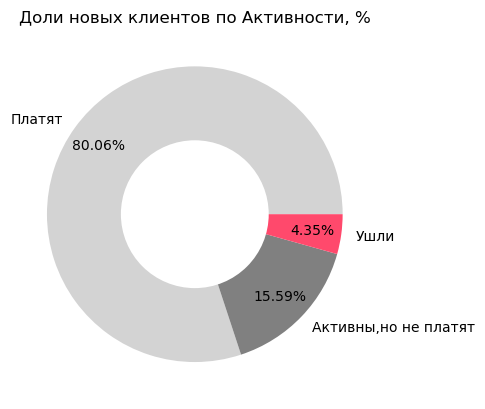

In [75]:
# рисуем круговую диаграмму
plt.pie(new_client_segment['Количество'],
        colors=['lightgrey','grey', '#FF496C'],
        labels= ['Платят','Активны,но не платят','Ушли'],
        autopct='%1.2f%%',
        pctdistance=0.8)

# добавляем дырку, чтобы получить кольцевую диаграмму
hole = plt.Circle((0, 0), 0.5, facecolor='white')
plt.gcf().gca().add_artist(hole)

plt.title('Доли новых клиентов по Активности, %')
plt.show()

Как видим, что от всех новых клиентов 80,06% активны и делают пожертвования, 15,59% активны, но не делают пожертвований и 4,35% ушли совсем.

In [98]:
print('Количество рекуррентов среди новых клиентов:', df_order.\
        query('recurrent == True & user_old == 0')['mindbox_id'].nunique())

Количество рекуррентов среди новых клиентов: 760


In [100]:
print('Процент рекуррентов среди новых клиентов, %:', round(df_order.\
        query('recurrent == True & user_old == 0')['mindbox_id'].nunique()/df_order.\
        query('user_old == 0')['mindbox_id'].nunique()*100, 2))

Процент рекуррентов среди новых клиентов, %: 4.82


In [102]:
print('Процент клиентов совершающих повторный платеж среди новых клиентов, %:', round(df_order.\
        query('repayment == True & user_old == 0')['mindbox_id'].nunique()/df_order.\
        query('user_old == 0')['mindbox_id'].nunique()*100, 2))

Процент клиентов совершающих повторный платеж среди новых клиентов, %: 1.99


In [108]:
print('Количество рекуррентов, совершающих повторный платеж, среди новых клиентов:',\
 df_order.loc[(df_order.recurrent == True) & (df_order.repayment == True) & (df_order.user_old == 0)]['mindbox_id'].nunique())

Количество рекуррентов, совершающих повторный платеж, среди новых клиентов: 313


Доля рекурентов в общей массе новых клиентов составляет 4,82 процента (760 человек), людей, которых платят повторно 1,99 процента (причем все они являются реккурентами)

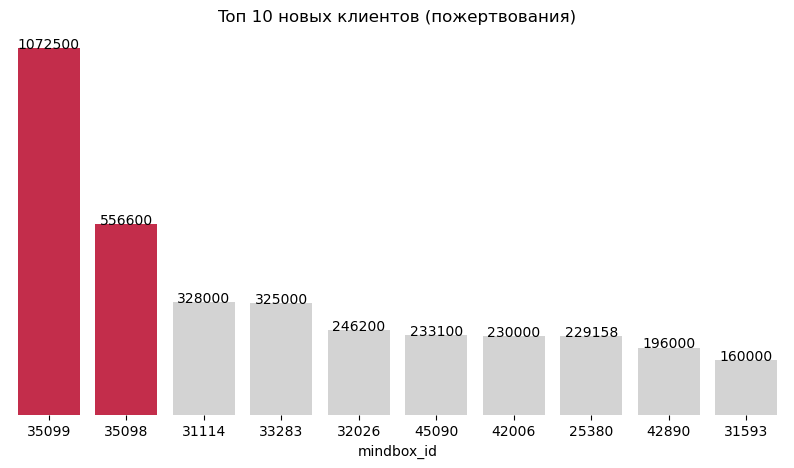

In [66]:
# задаем список цветов для графика (в нашем случае два)
colors = ['lightgrey'] * 10
colors[0], colors[1] = 'crimson', 'crimson'

# считаем параметры графика
plt.figure(figsize=(10, 5))
top_sales_new =df_order.query('user_old == 0 and status_ids == "Paid"').\
         groupby('mindbox_id', as_index=False)['total_price'].sum().sort_values(by='total_price', ascending=False).head(10)#nlargest(10, 'total_price')
top_customers_new = top_sales_new.mindbox_id.tolist()
sale_heights_new = top_sales_new.total_price.tolist()

# рисуем барплот
sns.barplot(data=top_sales_new,x='mindbox_id', y='total_price', palette=colors,  order=top_sales_new['mindbox_id'])

# добавляем подписи на бары (значения)
for i in range(len(top_customers_new)):
        plt.text(i,sale_heights_new[i]+100, int(sale_heights_new[i]), horizontalalignment='center')

# убираем ось У
ax = plt.gca ()
ax.get_yaxis().set_visible(False)

# убираем рамки
for spine in ['left', 'right', 'bottom', 'top']:
    ax.spines[spine].set_visible(False)

plt.title('Toп 10 новых клиентов (пожертвования)')
plt.show()

**По графику Toп 10 новых клиентов (пожертвования)** видим, что новые клиенты  активны и суммы пожертвования выше, чем у старых от 160 000 до 1 072 500.

In [69]:
#создадим столбец с отметкой топ 10 новых клиентов
df_order['top_new'] = df_order.query('user_old == 0').\
          mindbox_id.apply(lambda cell: 'tops' if cell in top_customers_new else 'others')

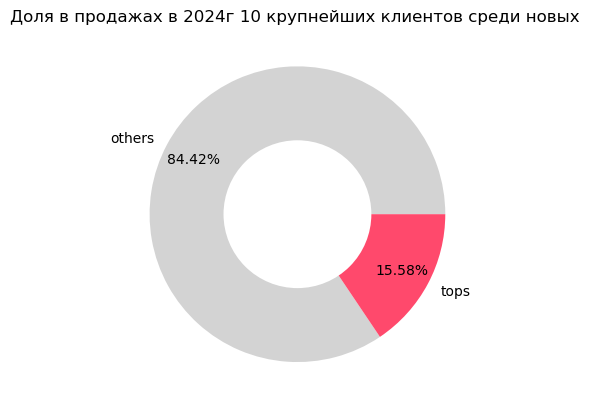

In [71]:
# рисуем круговую диаграмму
plt.pie( df_order.query('user_old == 0 and datetime>"2024-01-01" and status_ids == "Paid"').groupby('top_new')['total_price'].sum(),
        colors=['lightgrey', '#FF496C'],
        labels=['others', 'tops'],
        autopct='%1.2f%%',
        pctdistance=0.8)

# добавляем дырку, чтобы получить кольцевую диаграмму
hole = plt.Circle((0, 0), 0.5, facecolor='white')
plt.gcf().gca().add_artist(hole)

plt.title('Доля в продажах в 2024г 10 крупнейших клиентов среди новых ')
plt.show()

**По графику Доля в продажах в 2024г 10 крупнейших клиентов среди новых**, видим, что их пожертвования составляет 15,58%.

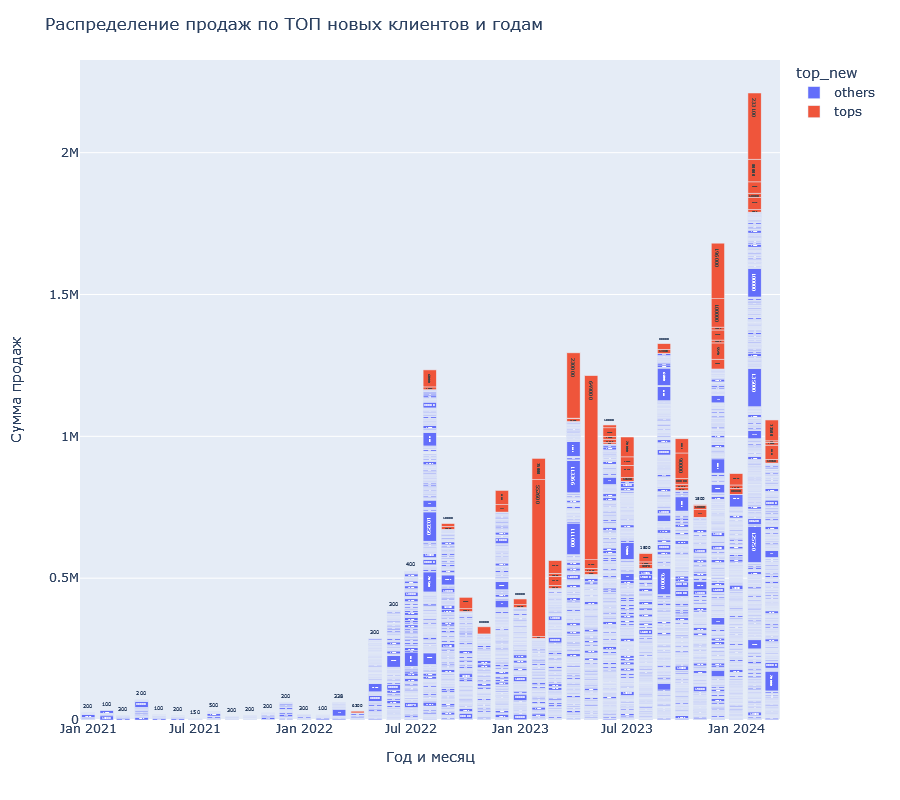

In [73]:
#построим график по сводной таблице - зависимости продаж по ID новых клиентов и годам

z =  df_order.query('user_old == 0 and status_ids == "Paid"').\
              groupby(['year_month', 'mindbox_id','top_new'], as_index=False)['total_price'].sum()

# строим график

fig = px.bar(data_frame=z,
             x='year_month',
             y='total_price',
             color='top_new',
             text='total_price'
            )

# оформляем график
fig.update_layout(xaxis={'categoryorder':'total descending'},
    title='Распределение продаж по ТОП новых клиентов и годам',
                   xaxis_title='Год и месяц',
                   yaxis_title='Сумма продаж',
                   width=1500, # указываем размеры графика
                   height=800)

fig.show() # выводим график

Видим, что новые топ клиенты не равномерно вносят пожертвования, но с 2023 эти суммы более крупные. И общая тенденция оплат растет с годами.

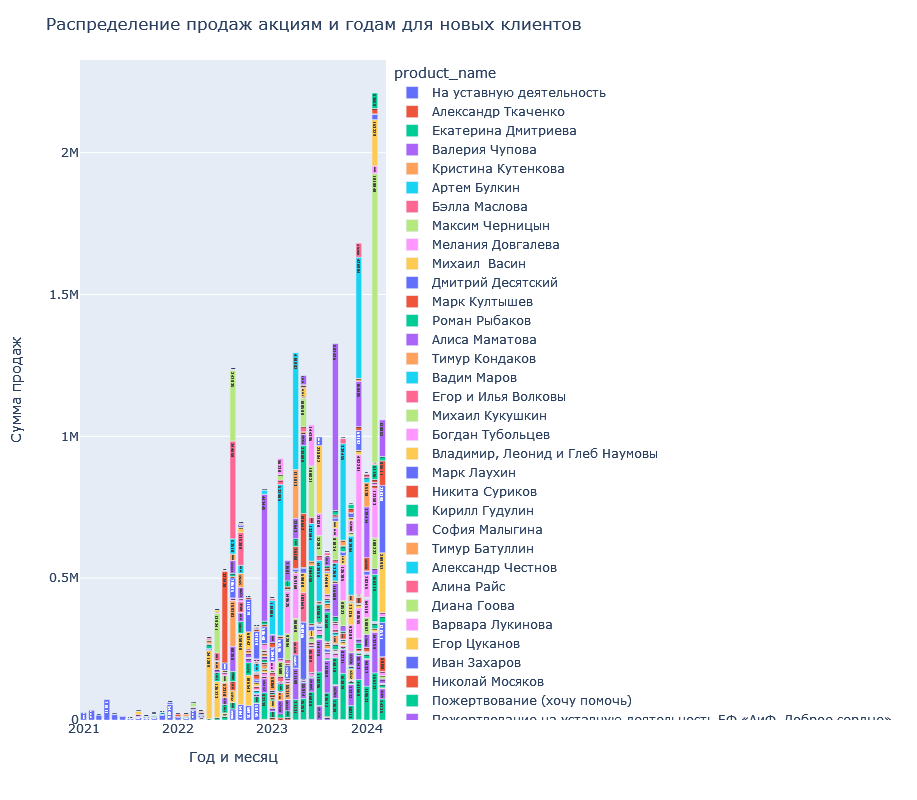

In [61]:
#построим график по сводной таблице - зависимости продаж по ID новых клиентов и годам

z =  df_order.query('user_old == 0 and status_ids == "Paid"').\
              groupby(['year_month', 'product_name'], as_index=False)['total_price'].sum()

# строим график

fig = px.bar(data_frame=z,
             x='year_month',
             y='total_price',
             color='product_name',
             text='total_price'
            )

# оформляем график
fig.update_layout(xaxis={'categoryorder':'total descending'},
    title='Распределение продаж акциям и годам для новых клиентов',
                   xaxis_title='Год и месяц',
                   yaxis_title='Сумма продаж',
                   width=1500, # указываем размеры графика
                   height=800)

fig.show() # выводим график

**По графику Распределения продаж акциям и годам для новых клиентов** видим, что разнообразие акций увеличивается с середины 2022 года и растет с каждым годом. В 2023 году есть постоянные по объему пожертвований акции, например, "Пожертвование(хочу помочь)" и есть отдельные акции, набирающие крупные суммы пожертвований. Видим в феврале большую сумму, больше миллиона набрала акция Григорий Белослюдцев.

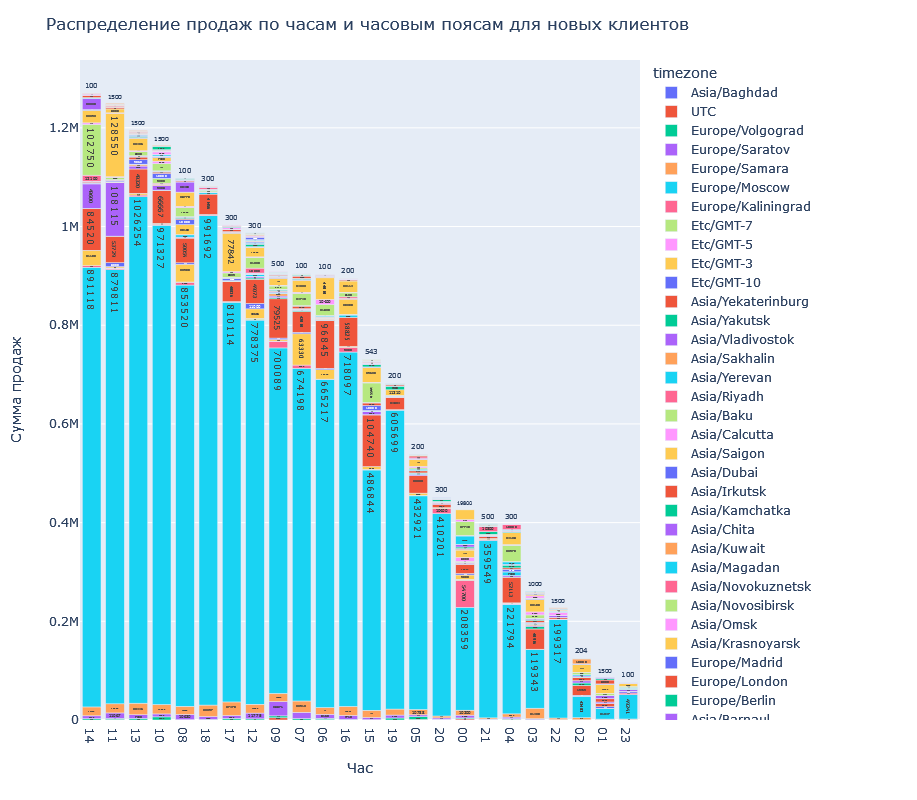

In [62]:
#построим график по сводной таблице - зависимости продаж по ID новых клиентов и годам

z =  df_order.query('user_old == 0 and status_ids == "Paid"').\
              groupby(['hour', 'timezone'], as_index=False)['total_price'].sum().sort_values(by='hour')

# строим график

fig = px.bar(data_frame=z,
             x='hour',
             y='total_price',
             color='timezone',
             text='total_price'
            )

# оформляем график
fig.update_layout(xaxis={'categoryorder':'total descending'},
    title='Распределение продаж по часам и часовым поясам для новых клиентов',
                   xaxis_title='Час',
                   yaxis_title='Сумма продаж',
                   width=1500, # указываем размеры графика
                   height=800)

fig.show() # выводим график

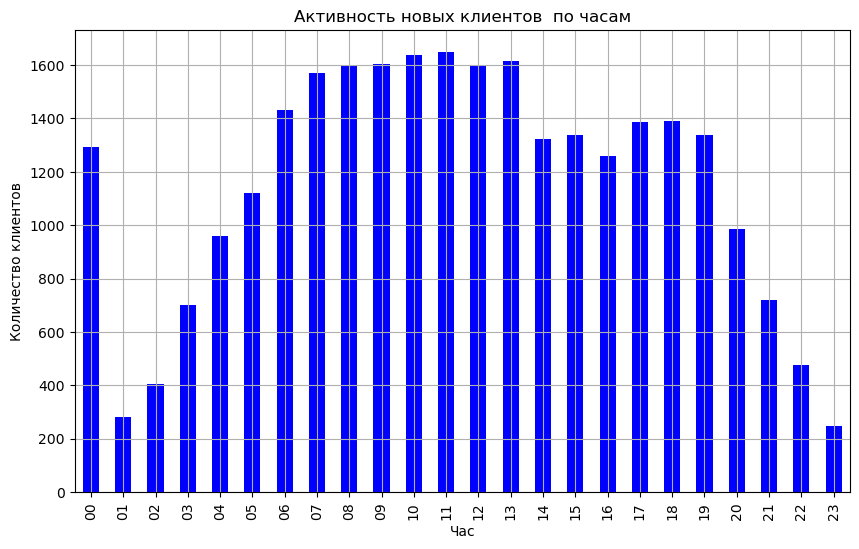

In [63]:
# Посмотрим число пожертвований по часам.

dat=df_order.query('user_old == 0 and status_ids == "Paid"')['hour'].sort_values().value_counts(sort=False)
dat.plot(kind='bar', grid=True, figsize=[10, 6],color = 'blue')
plt.title('Активность новых клиентов  по часам')
plt.xlabel('Час')
plt.ylabel('Количество клиентов')
plt.show();

**По Активности  новых клиентов  по часам** видно, что есть пики количества клиентов утром и в обед, причем много платежей с часовой зоны Москвы.Максимальные суммы пожертвований приходится на часовой пояс Москвы, но напомню, что у половины клиентов в базе отсутствуют данные о часовой зоне. В 11 и 14 есть значительное число клиентов из Владивостока, в этом городе +10 часовой пояс,т.е в момент оплат у них 21 и 24 часов. У части новых клиентов также стоит , видимо, автоплатеж на начало суток.

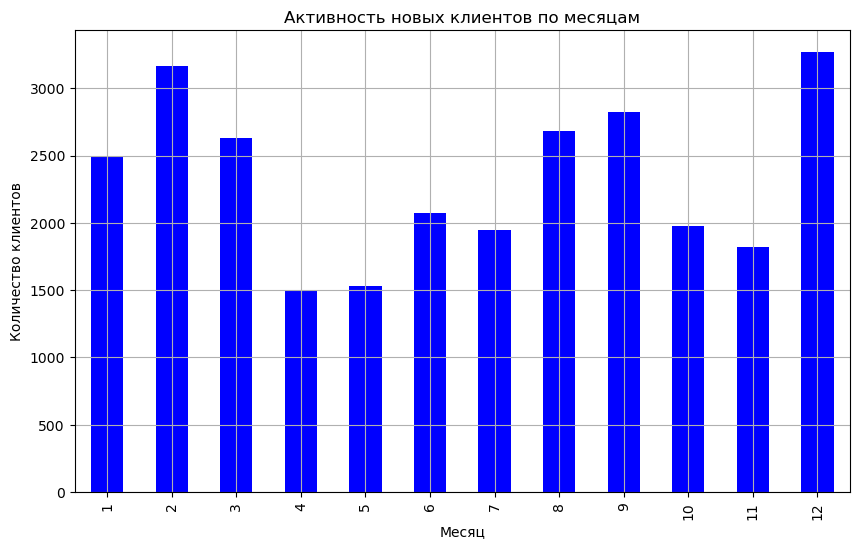

In [64]:
# Посмотрим число клиентов по месяцам.

dat = df_order.query('user_old == 0 and status_ids == "Paid"')['datetime']\
                                    .dt.month.sort_values().value_counts(sort=False)
dat.plot(kind='bar', grid=True, figsize=[10, 6],color = 'blue')
plt.title('Активность новых клиентов по месяцам')
plt.xlabel('Месяц')
plt.ylabel('Количество клиентов')
plt.show();

Больше всего активность новых клиентов взимние месяцы, особенно перед новым годом, также сентябрь, первый учебный месяц. Спад активности приходится также на май и летние, сезон шашлыков, отдыха, люди разъежаются.

In [110]:
#соберем таблицу новых платящих клиентов с 2023-2024 годов с числом уникальных клиентов, сумме оплат и первой оплате
#с группировкой по акциям
final_sales_new = df_order.query('user_old == 0 and status_ids == "Paid" and datetime>"2023-01-01"').groupby('product_name').\
    agg({'datetime':'first', 'total_price':'sum', 'mindbox_id':'nunique'}) 
#выведем таблицу
final_sales_new.sort_values(final_sales_new.columns[-2], ascending=False)

,datetime,total_price,mindbox_id
product_name,,,
Пожертвование (хочу помочь),2023-01-11 11:21:00,1291281,676
Пожертвование на уставную деятельность БФ «АиФ. Доброе сердце»,2023-02-22 10:22:00,1105106,405
Григорий Белослюдцев,2024-02-05 10:40:00,1019657,645
Никита Яковлев,2023-01-24 10:23:00,652911,161
Артём Матвеев,2023-12-02 11:40:00,625140,868
...,...,...,...
Салават Багаутдинов,2023-03-06 14:17:00,7110,29
Маргарита и Владислав Нартайлаковы,2023-02-11 09:38:00,5550,13
Зиёда Эргашева,2023-01-04 08:18:00,500,1


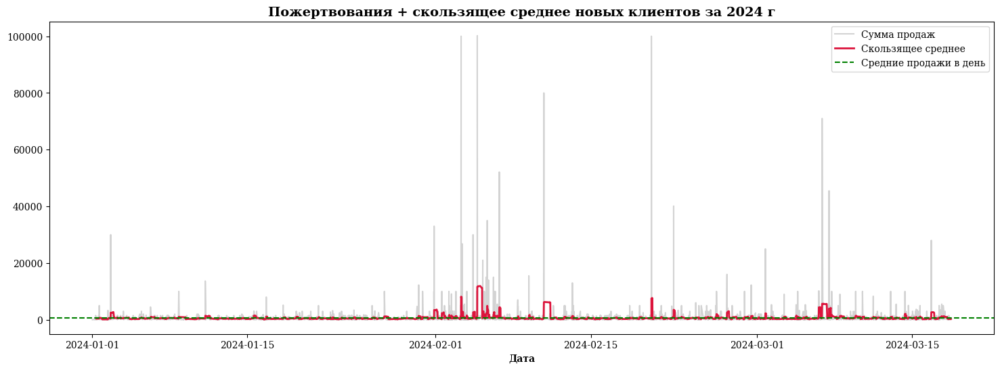

In [85]:
plt.figure(figsize=(18, 6))
# основной график продаж старых клиентов
(
    sns.lineplot(df_order.query('user_old == 0 and status_ids == "Paid" and datetime>"2024-01-01"').groupby('datetime')['total_price']
                 .sum(),
                 label='Сумма продаж',
                 color='lightgrey')
    )

# график продаж со скользящим средним (14 дней)
(
    sns.lineplot(df_order.query('user_old == 0 and status_ids == "Paid" and datetime>"2024-01-01"').groupby('datetime')['total_price']
                 .sum()
                 .rolling(14)
                 .mean(),
                 label='Скользящее среднее',
                 color='crimson',
                 linewidth=2)
    )

# линия средней дневной продажи
(
    plt.axhline(y=df_order.query('user_old == 0 and status_ids == "Paid" and datetime>"2024-01-01"').groupby('datetime').total_price.sum().mean(),
                linestyle='--',
                label='Средние продажи в день',
                color='green',
                linewidth=1.5)
    )

# легенда
plt.legend(prop={'family':'serif'})

# название графика
plt.title('Пожертвования + скользящее среднее новых клиентов за 2024 г', fontdict=dict(size=14, weight='bold', family='serif'))

# настройка осей графика
plt.xlabel('Дата', fontfamily='serif', fontweight='bold')
plt.ylabel('')
plt.xticks(fontfamily='serif')
plt.yticks(fontfamily='serif')
import warnings
warnings.filterwarnings('ignore')

plt.show();

In [49]:
print('Средние продажи в день на 2024г у новых клиентов', round(df_order.\
        query('user_old == 0 and status_ids == "Paid" and datetime>"2024-01-01"').groupby('datetime').total_price.sum().mean(),0))

Средние продажи в день на 2024г у новых клиентов 759.0


In [50]:
print('Максимум скользящего среднего продаж в день на 2024г у новых клиентов', df_order.\
          query('user_old == 0 and status_ids == "Paid" and datetime>"2024-01-01"').\
                         groupby('datetime')['total_price'].sum().rolling(14).mean().max())

Максимум скользящего среднего продаж в день на 2024г у новых клиентов 11905.0


**По графику Пожертвования + скользящее среднее новых клиентов за 2024 г** видно, что как средние продажи в день 759 как и скользящее среднее не превышает 12000, пики сумм в феврале достигают 100 000, это выше значений старых клиентов. Таккже скользящее среднее превышает средние продажи за день в первой половине февраля.

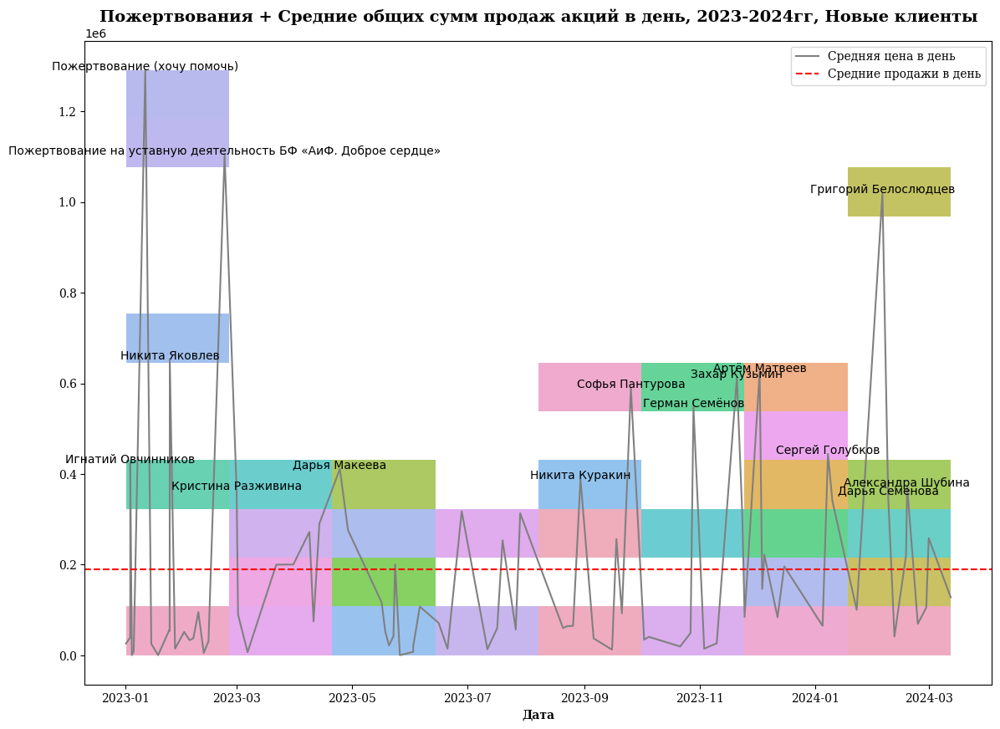

In [169]:
plt.figure(figsize=(14, 10))
# основной график продаж
(
    sns.lineplot(final_sales_new.groupby('datetime')['total_price']
                 .mean(),
                 label='Средняя цена в день',
                 color='Grey')
    )

# линия средней дневной продажи
(
    plt.axhline(y=final_sales_new.groupby('datetime').total_price.sum().mean(),
                linestyle='--',
                label='Средние продажи в день',
                color='red',
                linewidth=1.5)
   )
(
sns.histplot(data=final_sales_new, x = 'datetime',  y='total_price', \
             hue=final_sales_new.index,  multiple="stack", legend = False)
    )
# добавляем подписи на бары (значения)
for i in final_sales_new.query('total_price >350000').index:
        plt.text(final_sales_new.query('total_price >350000')['datetime'][i], final_sales_new.\
                          query('total_price >350000')['total_price'][i],i,horizontalalignment='center')
# легенда
plt.legend(prop={'family':'serif'})

# название графика
plt.title('Пожертвования + Средние общих сумм продаж акций в день, 2023-2024гг, Новые клиенты',\
                                                                  fontdict=dict(size=14, weight='bold', family='serif'))

# настройка осей графика
plt.xlabel('Дата', fontfamily='serif', fontweight='bold')
plt.ylabel('')
plt.xticks(fontfamily='serif')
plt.yticks(fontfamily='serif')
warnings.filterwarnings('ignore')

plt.show()

In [71]:
print('Средние продажи в день с группировкой по акциям на 2023-2024г у Новых клиентов',\
                              round(final_sales.groupby('datetime').total_price.sum().mean(),0))

Средние продажи в день с группировкой по акциям на 2023-2024г у Новых клиентов 189756.0


**Данный график Пожертвования + Средние продажи в день, 2023-2024гг, Новые клиенты**  также отражает ситуацию по месяцам, через расчет среднего с группировкой по акциям.  Средние продажи по акциям в день 189756. Средняя цена превышает среднее за день  на уставную деятельность и пожертвование (хочу помочь). Сильный провал  среднего в начале марте, июне и начале сентября, октябрь. Достаточно много персональных акций, средние суммы которых превышают среднее в день, больше всего значение у акции Григорий Белослюдцев. Средние общие продажи акций в день у новых клиентов выше.

In [241]:
#Выберем пять персональных акций и посмотрим как идет сбор средств: равномерно или есть пики
to_test = ['Никита Яковлев', 'Артём Матвеев','Захар Кузьмин', 'Софья Пантурова', 'Герман Семёнов']

In [243]:
#выведем таблицу пожертвований
test_ppl = df_order[df_order.product_name.isin(to_test)].\
          groupby(['product_name', 'datetime'])['total_price'].sum().reset_index()
test_ppl

,product_name,datetime,total_price
0,Артём Матвеев,2023-11-13 17:17:00,10
1,Артём Матвеев,2023-11-14 08:07:00,100
2,Артём Матвеев,2023-11-14 09:45:00,1000
3,Артём Матвеев,2023-11-14 10:38:00,1500
4,Артём Матвеев,2023-11-14 10:44:00,1500
...,...,...,...
5753,Софья Пантурова,2023-11-20 13:06:00,500
5754,Софья Пантурова,2023-12-20 13:05:00,500
5755,Софья Пантурова,2024-01-20 13:06:00,500
5756,Софья Пантурова,2024-02-20 13:06:00,0


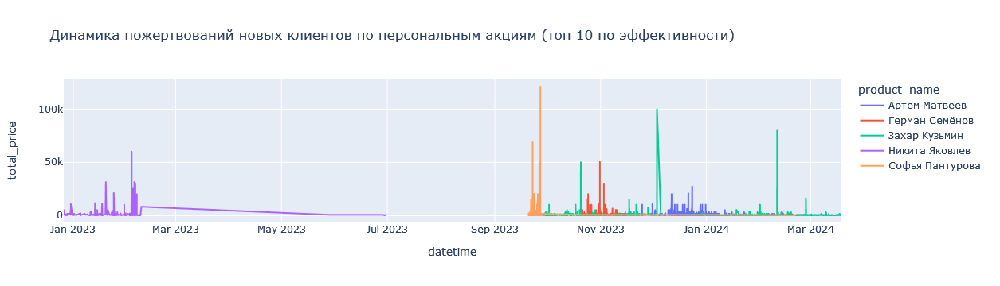

In [262]:
#выведем динамику пожертвований
px.line(test_ppl, x='datetime',
        y='total_price',
        color='product_name',
       title='Динамика пожертвований новых клиентов по персональным акциям (топ 10 по эффективности)')


Закономерность прослеживаются, но есть кто выпадает из нее:

- У Никиты Яковлева, Софья Пантурова, Герман Семенов,  в начале периода много донатов, в первый месяц сбора
- У Захара Кузьмина есть три больших пика в течении всего периода сборов


In [87]:
#посчитаем период проведения акций для новых клиентов
mean_price_one_new = (
    df_order.query user_old == 0 and status_ids == "Paid" and datetime>"2023-01-01"').groupby('product_name')
    .agg({'total_price':'sum', 'datetime':lambda cell: (cell.max()-cell.min()).days+1})
    .reset_index().rename(columns={'total_price':'total_sales', 'datetime':'period'})
    )

In [89]:
#получим столбец со значением деления суммы оплат на период проведения акции
mean_price_one_new['efficiency/mean_price_per_day'] = (mean_price_one_new.total_sales / mean_price_one_new.period).round(2)

In [91]:
#выведем и отсортируем полученную таблицу
mean_price_one_new.sort_values(mean_price_one_new.columns[-1], ascending=False)

,product_name,total_sales,period,efficiency/mean_price_per_day
19,Григорий Белослюдцев,1019657,7,145665.29
4,Александра Шубина,373186,22,16963.00
28,Евгений Сынков,258647,19,13613.00
71,Сергей Голубков,444315,40,11107.88
18,Глеб Пестов,128052,12,10671.00
...,...,...,...,...
65,Поможем жителям ДНР и ЛНР,39450,434,90.90
30,Егор Цуканов,13500,215,62.79
64,Полина Чинкова,14800,277,53.43
48,Маргарита и Владислав Нартайлаковы,5550,238,23.32


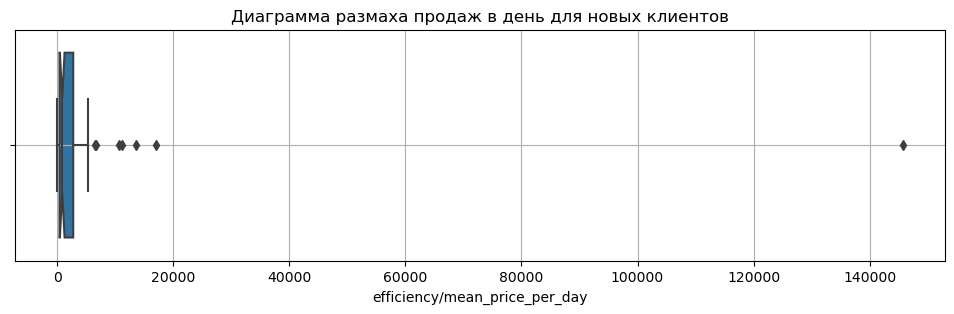

In [54]:
#построим диаграмму размаха
plt.figure(figsize=(12, 3))
sns.boxplot(x=mean_price_one_new['efficiency/mean_price_per_day'], notch=True)
plt.title('Диаграмма размаха продаж в день для новых клиентов')
plt.grid(True)
plt.show()

По Диаграмме размаха продаж в день для новых клиентов отметим, что есть аномальные значения продаж по акциям в день в районе 145952, по таблице выше видим, что это относится к акции "Григорий Белослюдцев", которая длилась семь дней и набрала такую сумму. Уберем аномальные значения через подсчет верхней границы и построим диаграмму размаха вновь.

In [103]:
#посчитаем границу выбросов для новых клиентов
q1 = mean_price_one_new['efficiency/mean_price_per_day'].quantile(0.25)
q3 = mean_price_one_new['efficiency/mean_price_per_day'].quantile(0.75)
max_new = q3+1.5*(q3-q1)
min_new = q3-1.5*(q3-q1)
print('Верхняя граница значений продаж акций в день для новых клиентов:', max_new)
print('Нижняя граница значений продаж акций в день для новых клиентов:', min_new)

Верхняя граница значений продаж акций в день для новых клиентов: 6325.102500000001
Нижняя граница значений продаж акций в день для новых клиентов: -775.4025000000001


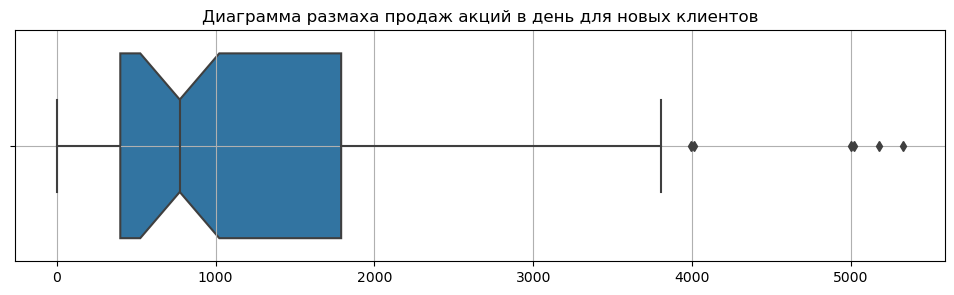

In [54]:
#построим диаграмму размаха без аномальных значений
plt.figure(figsize=(12, 3))
sns.boxplot(x=mean_price_one_new[mean_price_one_new['efficiency/mean_price_per_day']<max_new]\
                                 ['efficiency/mean_price_per_day'].tolist(), notch=True)
plt.title('Диаграмма размаха продаж акций в день для новых клиентов')
plt.grid(True)
plt.show()

In [55]:
#выведем основные значения
mean_price_one_new[mean_price_one_new['efficiency/mean_price_per_day']<max_new]\
                                 ['efficiency/mean_price_per_day'].describe()

count      77.000000
mean     1340.820779
std      1398.531439
min         1.440000
25%       399.280000
50%       773.870000
75%      1790.410000
max      5326.700000
Name: efficiency/mean_price_per_day, dtype: float64

**По Диаграмме размаха продаж акций в день для новых клиентов без аномальных значений** видим скос влевую сторону,т.е половина акций имеют  среднее значение продаж в день до 773 руб.  75% акций имеют среднее значение продаж в день меньше 1790. Максимальная граница значений продаж акций в день: 5326. Среднее по продажам акций в день составляет 1340 руб. Отметим, что новые клиенты имеют бОльшие значения продаж в день, чем старые.

### Изучим профиль новых клиентов по каналам

In [85]:
#напишем функцию составления профиля клиента по действиям и каналам
def get_channel(profile):

    # сортируем сессии по ID пользователя и дате посещения
    # группируем по ID и находим первые значения datetime и channel
    # столбец с временем первого посещения назовём first_ts
    # от англ. first timestamp — первая временная отметка
    profiles = (
        df_channels.sort_values(by=['user_id', 'action_date'])
        .groupby('user_id')
        .agg({'action_date': 'first', 'channel_id': 'first', 'user_old':'first', 'user_action':'first'})
        .rename(columns={'action_date': 'first_ts'})
        .reset_index()  # возвращаем user_id из индекса
    )

    #первый день месяца, в который это посещение произошло
    profiles['year_month'] = profiles['first_ts'] .dt.strftime('%Y-%m-01')
    
    return profiles

In [87]:
profile_channels = get_channel(df_channels)
profile_channels

,user_id,first_ts,channel_id,user_old,user_action,year_month
0,2734,2021-03-18,1,1,Оплата заказа,2021-03-01
1,2847,2021-06-16,1,1,Оплата заказа,2021-06-01
2,2861,2021-03-16,1,1,Оплата заказа,2021-03-01
3,3361,2022-03-19,9,1,Импорт при переносе исторической базы клиентов,2022-03-01
4,4982,2021-01-01,1,1,Оплата заказа,2021-01-01
...,...,...,...,...,...,...
23815,46782,2024-03-18,3,0,DOI. Спасибо за разовое пожертвование. Новый ш...,2024-03-01
23816,46783,2024-03-18,1,0,Редактирование клиента в блоке сценария 'Новый...,2024-03-01
23817,46784,2024-03-18,1,0,Редактирование клиента в блоке сценария 'Новый...,2024-03-01
23818,46785,2024-03-18,99,0,Переход на сайт,2024-03-01


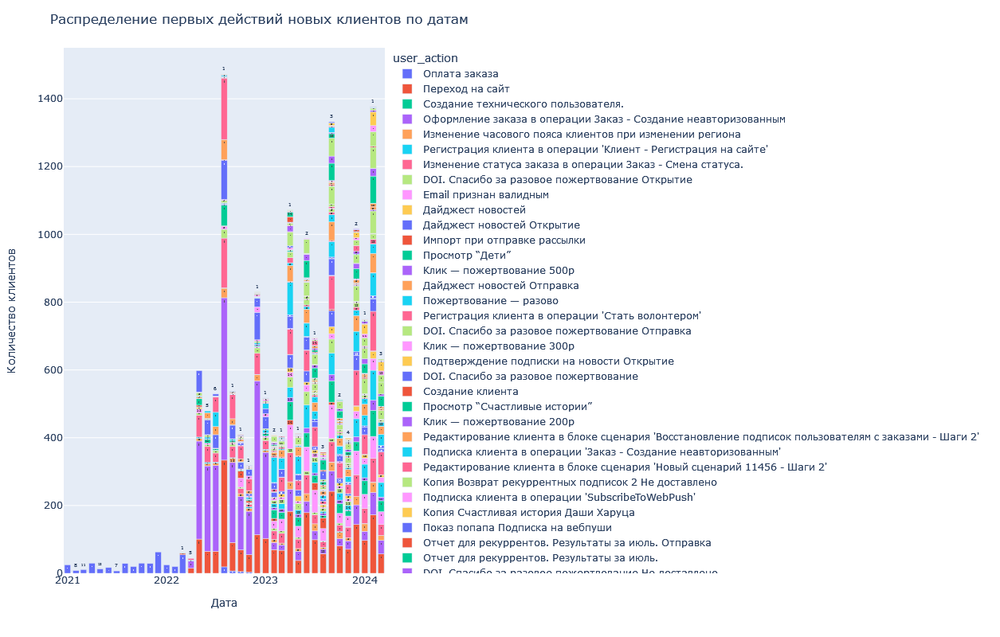

In [105]:
#построим график по сводной таблице - зависимости числа новых клиентов по годам и первым действиям

z =  profile_channels.query('user_old == 0').\
              groupby(['user_action', 'year_month'], as_index=False)['user_id'].count().sort_values(by='year_month')

# строим график

fig = px.bar(data_frame=z,
             x='year_month',
             y='user_id',
             color='user_action',
             text='user_id'
            )

# оформляем график
fig.update_layout(xaxis={'categoryorder':'total descending'},
    title='Распределение первых действий новых клиентов по датам',
                   xaxis_title='Дата',
                   yaxis_title='Количество клиентов',
                   width=1500, # указываем размеры графика
                   height=800)

fig.show() # выводим график

In [191]:
print('Распределение первых 15 действий новых клиентов по действиям 2023-2024гг:', profile_channels.\
       query('user_old == 0 and first_ts>"2023-01-01"')['user_action'].value_counts().head(15))

Распределение первых 15 действий новых клиентов по действиям 2023-2024гг: user_action
Переход на сайт                                                                           1655
Редактирование клиента в блоке сценария 'Новый сценарий 11456 - Шаги 2'                    796
Оформление заказа в операции Заказ - Создание неавторизованным                             740
Email признан валидным                                                                     714
Регистрация клиента в операции 'Заказ - Создание неавторизованным'                         617
Изменение статуса заказа в операции Заказ - Смена статуса.                                 612
Пожертвование — разово                                                                     506
Просмотр “Дети”                                                                            486
Подтверждение подписки на новости                                                          440
Подтверждение подписки на новости Отправка                 

**По графику Распределение первых действий новых клиентов по датам** отметим, что с середины 2022 года появилось разнообразие действий клиентов. регулярным стало - переход на сайт, оформление заказа неавторизованным пользователем (особенно с мая по июнь 2023, когда переносили данные), емайл призван валиден. Интересно, что в середине 2022 года фонд импортировал старых клиентов в систему и только потом начал регистрировать новых. Поэтому не понятно - откуда взялись оплаты от новых пользователей, возможно, это утерянные как то старые пользователи, изучим.

In [121]:
#переименуем каналы для графиков 
profile_channels['channel_id']= profile_channels['channel_id'].map(channels_dict)

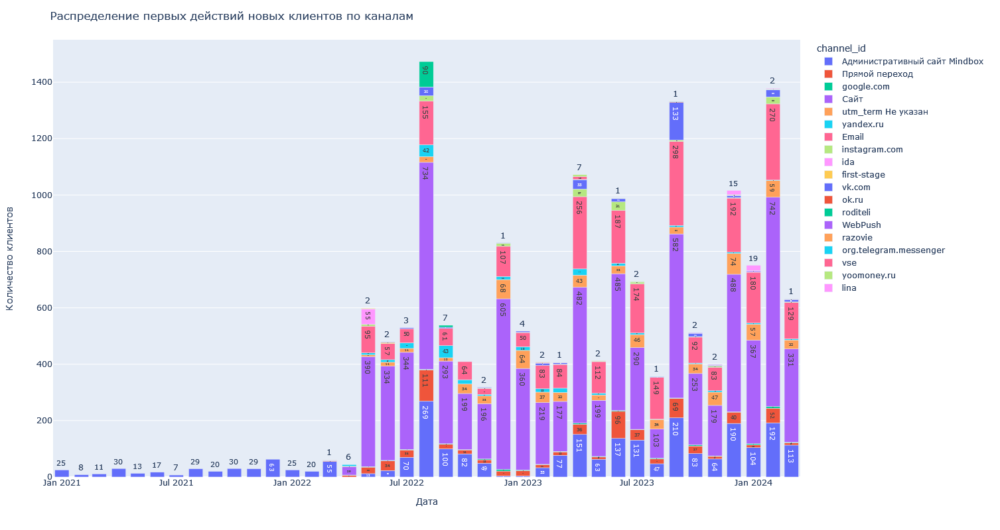

In [123]:
#построим график по сводной таблице - зависимости числа новых клиентов по годам и первым действиям

z =  profile_channels.query('user_old == 0').\
              groupby(['channel_id', 'year_month'], as_index=False)['user_id'].count().sort_values(by='year_month')


    
# строим график

fig = px.bar(data_frame=z,
             x='year_month',
             y='user_id',
             color='channel_id',
             text='user_id'
            )

# оформляем график
fig.update_layout(xaxis={'categoryorder':'total descending'},
    title='Распределение первых действий новых клиентов по каналам',
                   xaxis_title='Дата',
                   yaxis_title='Количество клиентов',
                   width=1500, # указываем размеры графика
                   height=800)

fig.show() # выводим график

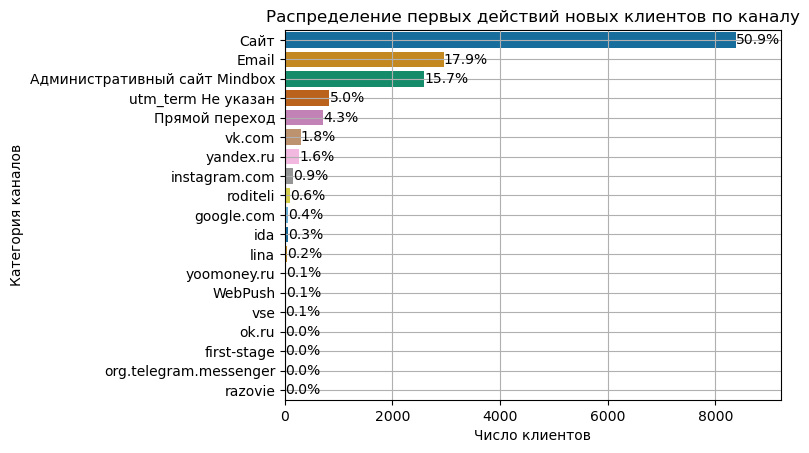

In [125]:
#выведем график распределения первых действий новых клиентов по каналу
ax = sns.countplot(y='channel_id', data=profile_channels.query('user_old == 0'), palette='colorblind',\
                   order= profile_channels.query('user_old == 0')['channel_id'].value_counts().index)

# сохраним общее число каналов
total = profile_channels.query('user_old == 0')['channel_id'].count()

#создадим подписи долей каналов
ax.bar_label(ax.containers[0], fmt=lambda x: f'{(x/total)*100:0.1f}%')
ax.margins(x=0.1)
ax.set(xlabel='Число клиентов', ylabel='Категория каналов', title='Распределение первых действий новых клиентов по каналу')
plt.grid(True)
plt.show();

**По графику Распределение первых действий новых клиентов по каналам** видим, что до середины 2022 года перимущественно был сайт Mindbox, далее увеличивалось число клиентов с канала-Сайт, что составляет 50,9%, также большой процент с емайл- 17,9%. Наблюдаются пики прихода новых клиентов в августе, сентябре, феврале.

In [179]:
#сохраним список ID новых клиентов, которые были активны до 01.05.2022
old_new = profile_channels.query('user_old == 0 & year_month <"2022-05-01"')['user_id'].unique().tolist()

In [82]:
#выведем год регистрации/редактирования тех клиентов, которые делали пожертвования 
df_donor[df_donor.mindbox_id.isin(old_new)]['datetime'].dt.year.value_counts().sort_values(ascending =False).head(15)

datetime
2022    311
2023     88
2024     32
Name: count, dtype: int64

Изучив,  год регистрации/редактирования тех клиентов, которые делали пожертвования по списку ID новых клиентов, которые были активны до 01.05.2022. Интересно, что их профили в системе редактировались самое раннее в 2022 году. Проверим были ли они импорте и когда вносили оплаты. 

In [183]:
#выведем число уникальных пользовотелей по списку ID новых клиентов в таблице импорта
print('Число уникальных пользовотелей по списку ID новых клиентов в таблице импорта:',\
                   df_import[df_import.mindbox_id.isin(old_new)]['mindbox_id'].nunique())

Число уникальных пользовотелей по списку ID новых клиентов в таблице импорта: 0


In [187]:
#выведем число оплат пользовотелей по списку ID новых клиентов, которые были активны до 01.05.2022.
df_order.query('status_ids == "Paid"')[df_order.query('status_ids == "Paid"').mindbox_id.isin(old_new)]['datetime']\
                                .dt.year.value_counts().sort_values( ascending =False).head(15)

datetime
2022    553
2021    500
2023    420
2024    105
Name: count, dtype: int64

Пользовотели по списку ID новых клиентов, которые были активны до 01.05.2022, сделали 500 пожертвований в 2021 году.

In [189]:
#выведем число активностей пользовотелей по списку ID новых клиентов, которые были активны до 01.05.2022.
df_channels[df_channels.user_id.isin(old_new)]['action_date'].dt.year.value_counts().sort_values( ascending =False).head(15)

action_date
2023    33331
2022    20867
2024     4576
2021      698
Name: count, dtype: int64

И активность их также присутствовала по таблице каналов, и в 2021 году

In [94]:
#выведем число активностей пользовотелей по списку ID новых клиентов
df_channels.query('action_date <"2022-05-01"')[df_channels.query('action_date <"2022-05-01"')\
           .user_id.isin(old_new)]['user_action'].value_counts().sort_values( ascending =False).head(15)

user_action
Оплата заказа                                                         919
Переход на сайт                                                       418
Email признан валидным                                                308
Просмотр “Дети”                                                       123
Оформление заказа в операции Заказ - Создание неавторизованным        117
Изменение статуса заказа в операции Заказ - Смена статуса.             77
Регистрация клиента в операции 'Заказ - Создание неавторизованным'     50
Изменение часового пояса клиентов при изменении региона                28
Просмотр “ЧитаемПомогаем”                                              28
Email признан невалидным                                               23
Просмотр “О фонде”                                                     17
Просмотр “Спецпроекты”                                                 17
Пожертвование — разово                                                 16
Клик — пожертвование 1000р

По числу активностей пользовотелей по списку ID новых клиентов до 01.05.2022 больше всего набрала - Оплата заказа, также они переходили на сайт и получали письма. Думаю, фонду для внутренней корректировки данных исследование полезно.

## Изучение поведения всех клиентов по каналам

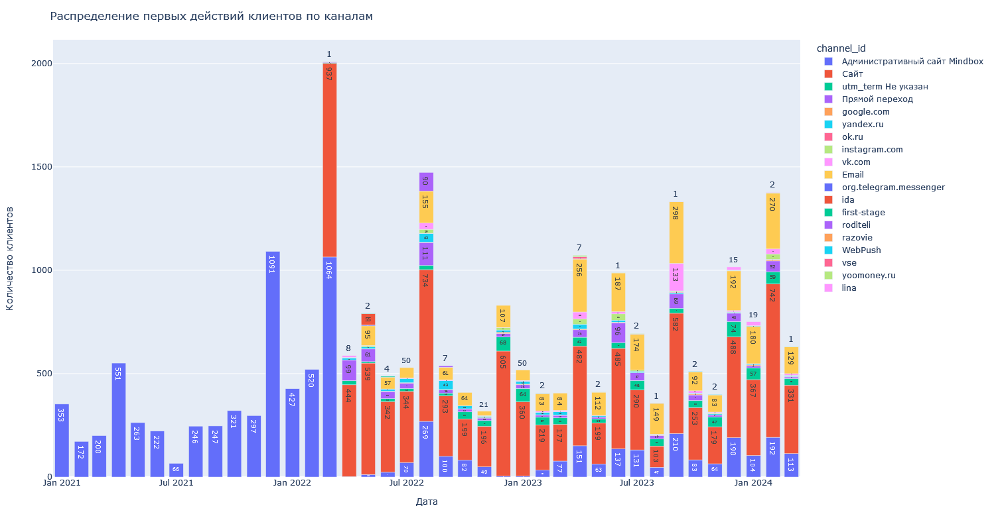

In [153]:
#построим график по сводной таблице - зависимости числа новых клиентов по годам и первым действиям

z =  profile_channels.\
              groupby(['channel_id', 'year_month'], as_index=False)['user_id'].count().sort_values(by='year_month')


    
# строим график

fig = px.bar(data_frame=z,
             x='year_month',
             y='user_id',
             color='channel_id',
             text='user_id'
            )

# оформляем график
fig.update_layout(xaxis={'categoryorder':'total descending'},
    title='Распределение первых действий клиентов по каналам',
                   xaxis_title='Дата',
                   yaxis_title='Количество клиентов',
                   width=1500, # указываем размеры графика
                   height=800)

fig.show() # выводим график

In [110]:
#посчитаем количество уникальных каналов для каждого клиента
channels_count = df_channels.groupby('user_id')['channel_id'].nunique()\
                  .reset_index().rename(columns={'channel_id':'num_channels'})

In [112]:
#посчитаем количество касаний с каналами
touch_count = df_channels.groupby('user_id')['channel_id'].count()\
              .reset_index().rename(columns={'channel_id':'num_touches'})

In [127]:
#соберем таблицу
channels_total = profile_channels.merge(channels_count.merge(touch_count, on='user_id'), on='user_id')
channels_total.sample(5)

,user_id,first_ts,channel_id,user_old,user_action,year_month,num_channels,num_touches
11414,32388,2022-10-05,Сайт,0,Оформление заказа в операции Заказ - Создание ...,2022-10-01,4,152
17065,39594,2023-07-19,Административный сайт Mindbox,0,Email признан валидным,2023-07-01,6,88
15274,37697,2023-05-01,Административный сайт Mindbox,0,Редактирование клиента в блоке сценария 'Новый...,2023-05-01,3,84
21225,44101,2024-01-13,Email,0,Подтверждение подписки на новости Отправка,2024-01-01,4,35
18167,40841,2023-09-22,Сайт,0,Регистрация клиента в операции 'Заказ - Создан...,2023-09-01,4,98


По итогу получаем таблицу: пользователь, дата первого касания, канал первого касания, старый или новый клиент, действия клиента, месяц первого касания ,количество каналов касания, количество касаний с о всеми каналами всего

In [129]:
#выведем таблицу числа клиентов по касанию канала
chan_bar = channels_total.groupby('channel_id')['user_id'].count().reset_index().rename(columns={'user_id': 'counts'})
chan_bar = chan_bar.sort_values(by='counts', ascending=False)

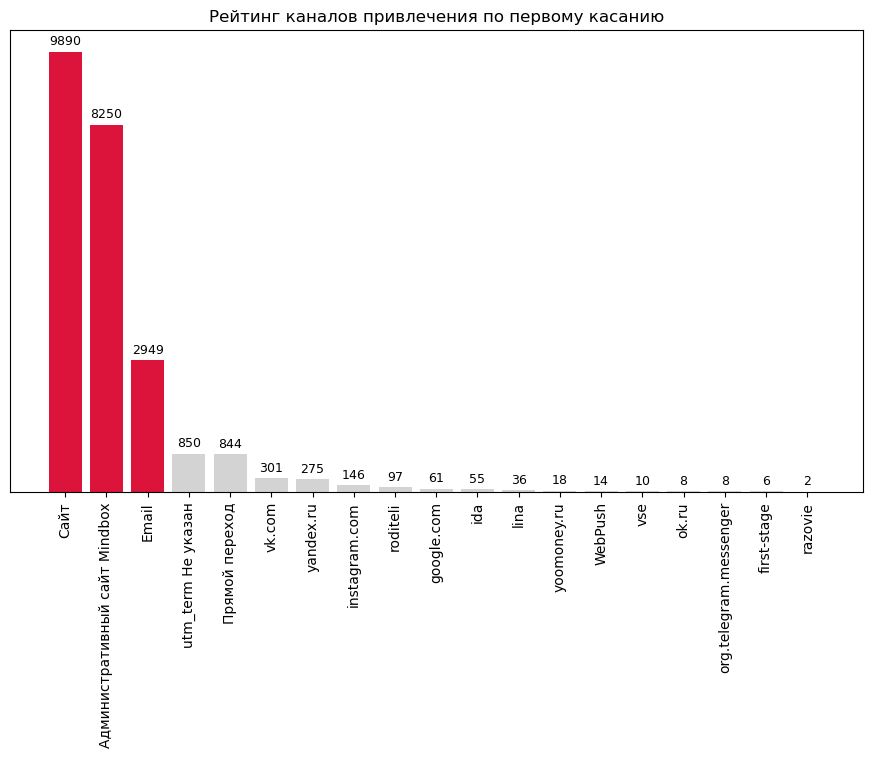

In [131]:
# создаем цвета для графика: тройка лидеров красная, остальные серые
colors = ['lightgrey'] * 19
colors[0], colors[1], colors[2] = 'crimson', 'crimson', 'crimson'

# создаем график
fig, ax = plt.subplots(figsize=(11, 6))

plt.bar(chan_bar.channel_id, chan_bar.counts, color=colors)
plt.xticks(rotation=90)
plt.ylabel('количество человек')
plt.title('Рейтинг каналов привлечения по первому касанию')

# добавляем значения на бары
for rect in ax.patches:
        # Получаем координаты для подписей значений
        y_value = rect.get_height()
        x_value = rect.get_x() + rect.get_width() / 2
        va='bottom'
        # Добавляем значения на бары
        ax.annotate(
            y_value,
            (x_value, y_value),
            xytext=(0, 3),
            textcoords="offset points",
            ha='center',
            va=va,
            size=9)

# убираем ось Y
ax.get_yaxis().set_visible(False)

plt.show()

Основная масса пользователей первый раз контактирует с Сайтом, затем Mindbox, с большим отставанием идут почтовые рассылки и на четвертом месте персонализированные акции по конкретным детям.

In [102]:
#создадим таблицу  касаний всего пользователями для каналов
chan_bar2 = df_channels.groupby('channel_id')['user_id'].count()\
                                                    .reset_index().rename(columns={'user_id': 'counts'})
#переименуем каналы для графиков 
chan_bar2['channel_id']= chan_bar2['channel_id'].map(channels_dict)
#отсортируем
chan_bar2 = chan_bar2.sort_values(by='counts', ascending=False)


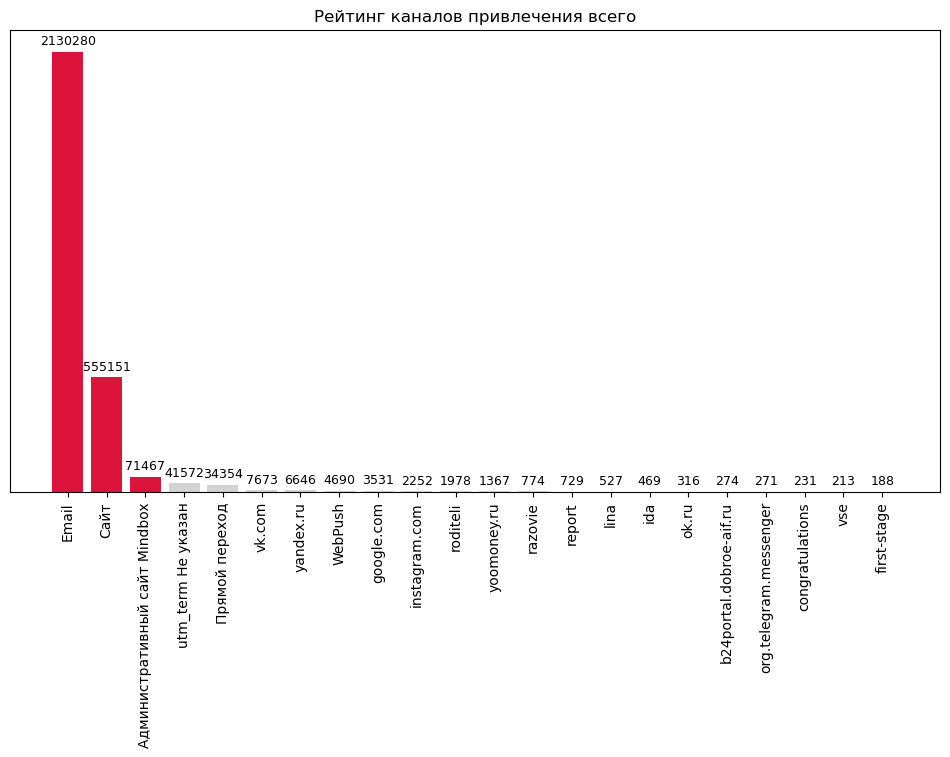

In [98]:
# создаем цвета для графика: тройка лидеров красная, остальные серые
colors = ['lightgrey'] * 19
colors[0], colors[1], colors[2] = 'crimson', 'crimson', 'crimson'

# создаем график
fig, ax = plt.subplots(figsize=(12, 6))

plt.bar(chan_bar2.channel_id, chan_bar2.counts, color=colors)
plt.xticks(rotation=90)
plt.ylabel('количество человек')
plt.title('Рейтинг каналов привлечения всего')

# добавляем значения на бары
for rect in ax.patches:
        # Получаем координаты для подписей значений
        y_value = rect.get_height()
        x_value = rect.get_x() + rect.get_width() / 2
        va='bottom'
        # Добавляем значения на бары
        ax.annotate(
            y_value,
            (x_value, y_value),
            xytext=(0, 3),
            textcoords="offset points",
            ha='center',
            va=va,
            size=9)

# убираем ось Y
ax.get_yaxis().set_visible(False)

plt.show()

По охвату аудитории в целом лидирует почтовая рассылка, на втором месте Сайт и замыкает тройку лидеров Mindbox,  на четвертом месте персонализированные акции детей.

In [133]:
#соберем таблицу количества всего касаний и первых касаний
chan_eff = chan_bar2.merge(chan_bar, on='channel_id').rename(columns={'counts_x':'total', 'counts_y': 'aim'})

In [135]:
#создадим столбец эффективности канала
chan_eff['effect'] = (chan_eff['aim'] / chan_eff['total'] * 100).round(2)

In [145]:
#выведем первых 5 самых эффективных каналов
chan_eff = chan_eff.sort_values(by='effect', ascending=False) 
chan_eff.nlargest(5, 'effect')

,channel_id,total,aim,effect
14,ida,469,55,11.73
2,Административный сайт Mindbox,71467,8250,11.54
13,lina,527,36,6.83
9,instagram.com,2252,146,6.48
10,roditeli,1978,97,4.90


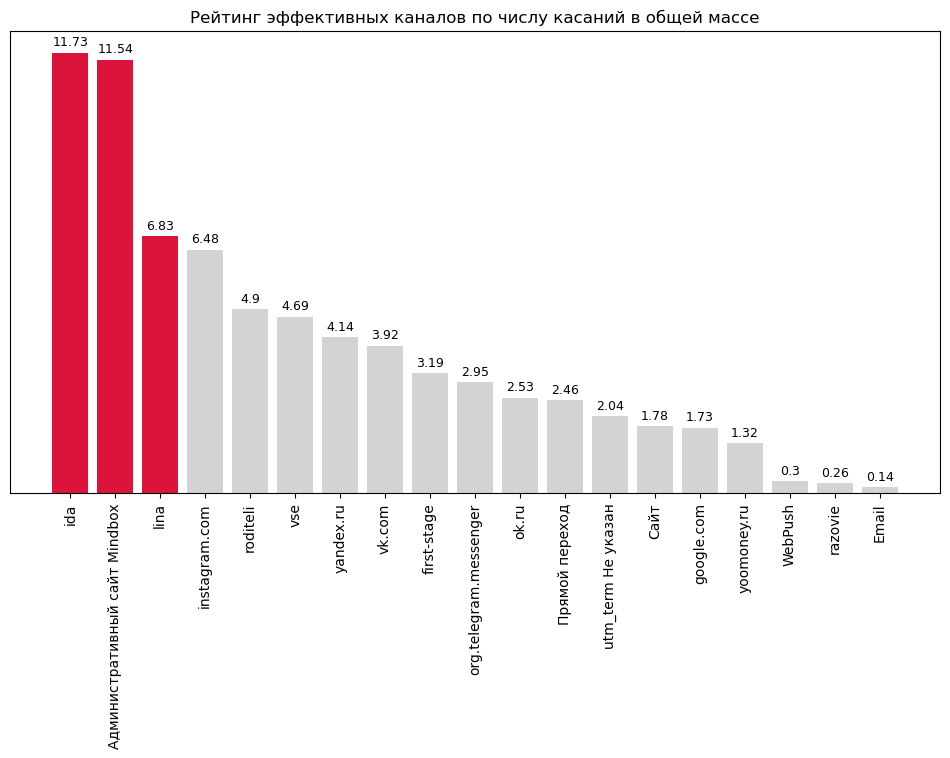

In [151]:
# создаем цвета для графика: тройка лидеров красная, остальные серые
colors = ['lightgrey'] * 19
colors[0], colors[1], colors[2] = 'crimson', 'crimson', 'crimson'

# создаем график
fig, ax = plt.subplots(figsize=(12, 6))

plt.bar(chan_eff.channel_id, chan_eff.effect, color=colors)
plt.xticks(rotation=90)
plt.ylabel('Эффективность')
plt.title('Рейтинг эффективных каналов по числу каcаний в общей массе')

# добавляем значения на бары
for rect in ax.patches:
        # Получаем координаты для подписей значений
        y_value = rect.get_height()
        x_value = rect.get_x() + rect.get_width() / 2
        va='bottom'
        # Добавляем значения на бары
        ax.annotate(
            y_value,
            (x_value, y_value),
            xytext=(0, 3),
            textcoords="offset points",
            ha='center',
            va=va,
            size=9)

# убираем ось Y
ax.get_yaxis().set_visible(False)

plt.show()

По эффективности (касаний в общей массе) лидируют инстаграмм активности **ида**, на втором месте **Mindbox**, и на третьем тоже из инстаграмм - **лина**, на четвертом месте видимо сам **канал фонда в инстаграм** - есть смысл развивать этот канал, как минимум настроить ЦА и минимальные активности для них.

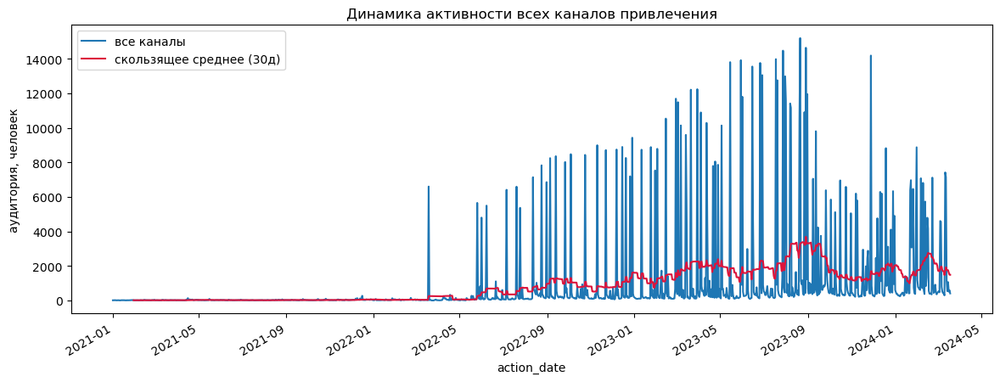

In [122]:
#Отрисуем охват каналами привлечения аудитории
plt.figure(figsize=(14, 5))
df_channels.groupby('action_date')['user_id'].nunique().plot(label='все каналы')
df_channels.groupby('action_date')['user_id'].nunique()\
          .rolling(30).mean().plot(color='crimson', label='скользящее среднее (30д)')
plt.ylabel('аудитория, человек')
plt.legend(loc='upper left')
plt.title('Динамика активности всех каналов привлечения')
plt.show();

Видим всплеск в апреле 2022 года - массовая загрузка пользователей, проверим.

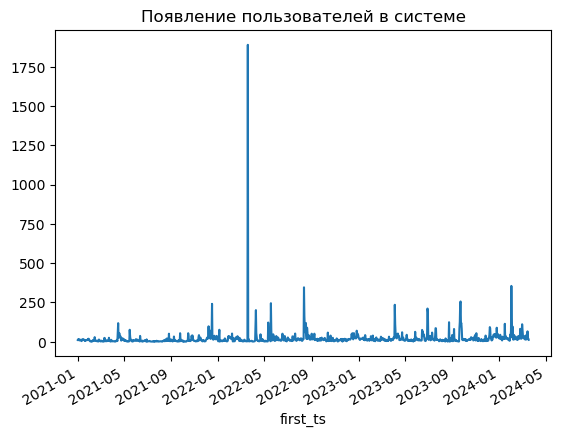

In [124]:
#Посмотрим на даты появления пользователей в системе
channels_total.groupby('first_ts')['user_id'].nunique().plot()
plt.title('Появление пользователей в системе')
plt.show();

Основная загрузка в апреле, уберем ее, чтобы посмотреть на последующую динамику появления новых пользователей.

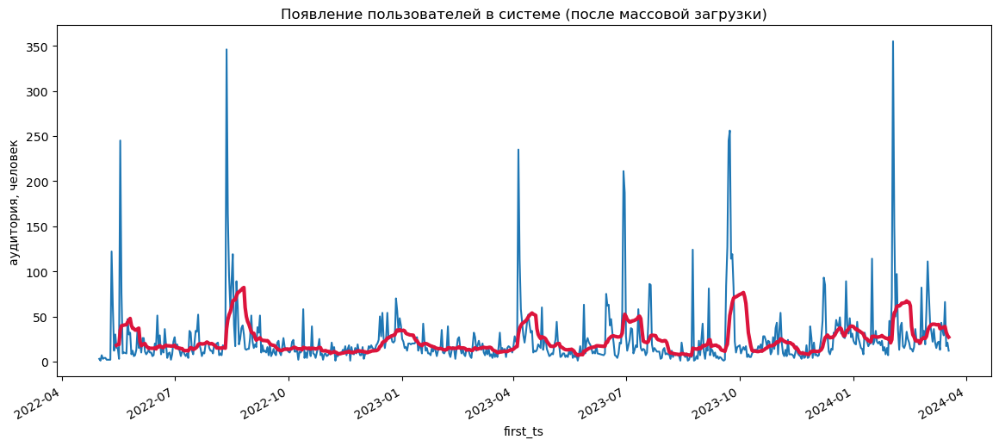

In [148]:
plt.figure(figsize=(14, 6))
channels_total[channels_total.first_ts >= '2022-05-01'].groupby('first_ts')['user_id'].nunique().plot()
(
    channels_total[channels_total.first_ts >= '2022-05-01']
    .groupby('first_ts')['user_id']
    .nunique()
    .rolling(15).mean()
    .plot(color='crimson', linewidth=3)
)
plt.ylabel('аудитория, человек')
plt.title('Появление пользователей в системе (после массовой загрузки)');

Видна цикличность и пики - следует посмотреть, что это за активности, которые так привлекают пользователей и возможно повторить этот формат в дальнейшем.

In [158]:
#Изучим персонализированные компании детей
campaigns = df_channels[~df_channels.utm_campaign.isna()]

In [160]:
def clean_medium(cell: str) -> str:
    'функция для очистки столбца utm_medium от дубликатов'
    new_cell = ''
    if ',' in cell:
        new_cell = cell.split(',')[0]
    elif cell == 'cpaa':
        new_cell = 'cpa'
    elif 'cpc' in cell:
        new_cell = 'cpc'
    else:
        new_cell = cell
    return new_cell

In [162]:
def clean_source(cell: str) -> str:
    'функция для очистки столбца utm_source от дубликатов'
    new_cell = ''
    if 'mts' in cell or 'market' in cell:
        new_cell = 'mtsmarketolog'
    elif 'dobroe' in cell:
        new_cell = 'dobroe.aif.ru'
    else:
        new_cell = cell
    return new_cell

In [164]:
#очистим столбец utm_medium от дубликатов
campaigns.utm_medium = campaigns.utm_medium.apply(clean_medium)

In [166]:
#функция для очистки столбца utm_source от дубликатов
campaigns.utm_source = campaigns.utm_source.str.lower()
campaigns.utm_source = campaigns.utm_source.apply(clean_source)

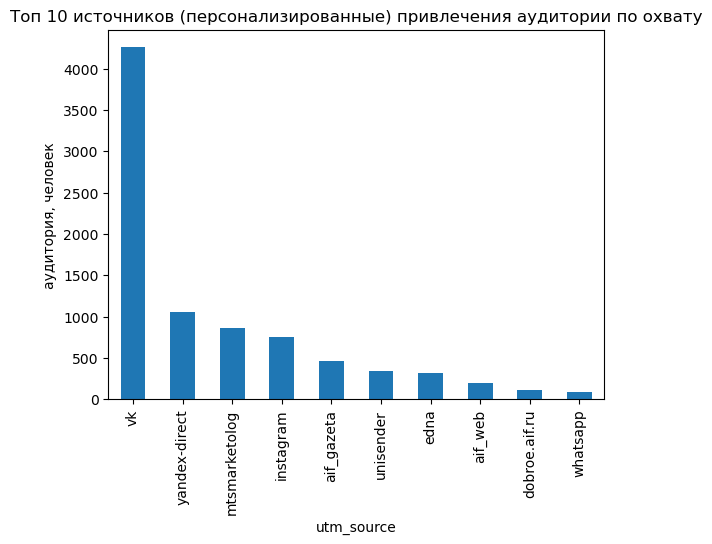

In [168]:
#выведем Топ 10 источников (персонализированные) привлечения аудитории по охвату
(
    campaigns[campaigns.utm_source != 'mindbox']
    .groupby('utm_source')['user_id']
    .nunique().sort_values(ascending=False)
    .nlargest(10).plot(kind='bar')
)
plt.title('Топ 10 источников (персонализированные) привлечения аудитории по охвату')
plt.ylabel('аудитория, человек');

По персональным акциям  привлечения аудитории по охвату с отрывом идет Вконтакте, далее второе и третье место делят яндекс директ и маркетолог от мтс. важно знать затраты на источники привлечения, чтобы понимать- насколько они окупаются.

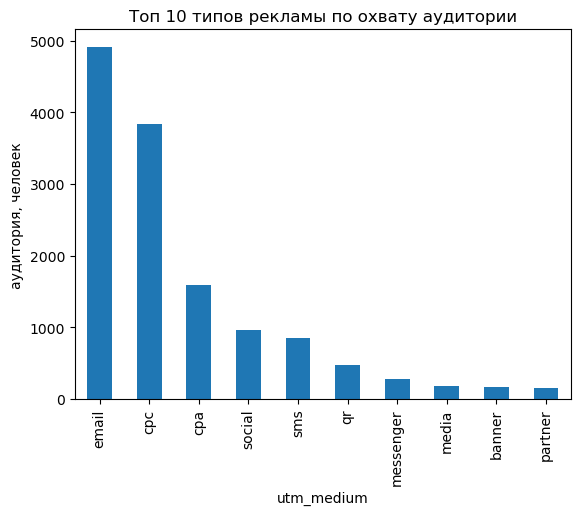

In [172]:
#выведем Топ 10 типов рекламы по охвату аудитории
(
    campaigns.groupby('utm_medium')['user_id']
    .nunique().sort_values(ascending=False)
    .nlargest(10).plot(kind='bar')
)
plt.title('Топ 10 типов рекламы по охвату аудитории')
plt.ylabel('аудитория, человек');

Топ 10 типов рекламы по охвату аудитории показывает, что на первом месте емайл, второе - cpc, третье - cpa уже со значительным отставанием.

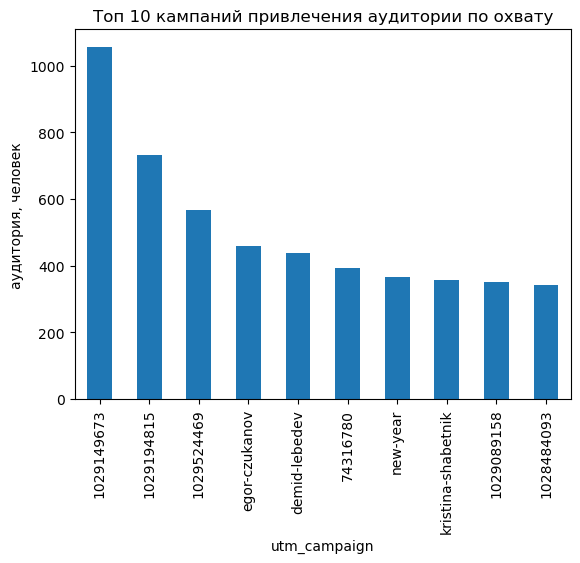

In [174]:
#выведем Топ 10 кампаний привлечения аудитории по охвату
(
    campaigns[campaigns.utm_source != 'mindbox']
    .groupby('utm_campaign')['user_id']
    .nunique().sort_values(ascending=False)
    .nlargest(10).plot(kind='bar')
)
plt.title('Топ 10 кампаний привлечения аудитории по охвату')
plt.ylabel('аудитория, человек');

Топ 10 кампаний привлечения аудитории по охвату видим, что есть цифры, для расшифровки нам не даныдоп материалы, но думаю фонд разберется, что это за активности

# Шаг 3. RFM - анализ  <a class="anchor" id="Шаг_3._RFM_анализ"></a> 

### R_VALUE Для Новых пользователей

In [155]:
#сохраним максимальную дату платежей для новых клиентов, за исключением неоплаченных
work_date = df_order.query('status_ids !="notpaid"and user_old<1').datetime.max() + pd.Timedelta('1d')

In [157]:
#сформируем таблицу сгруппированную по ID клиентов с суммой продаж, числом платежек и макс и мин датами
rfm = df_order.query('status_ids !="notpaid"').groupby('mindbox_id').agg({'user_old':'sum',
                                    'order_ids': 'count',
                                     'total_price': 'sum',
                                     'datetime': ['min', 'max']}).reset_index()


In [159]:
#переименум колонки
rfm.columns = ['id','user_old', 'orders_count', 'total_price', 'start_date', 'end_date']

In [161]:
#расчитаем период активности новых клиентов
rfm['period'] = (rfm.query('user_old<1').end_date - rfm.query('user_old<1').start_date) / pd.Timedelta('1d') + 1

In [163]:
#посчитаем как давно делали платеж новые клиенты
rfm['r_value'] = (work_date - rfm.query('user_old<1').end_date) / pd.Timedelta('1d')/30

In [165]:
#посчитаем частоту платежей новых клиентов
rfm['f_value'] = (rfm.query('user_old<1').orders_count / rfm.query('user_old<1').period).round(2) * 30

In [167]:
#создадим столбец с суммой платежей новых клиентов
rfm['m_value'] = rfm.query('user_old<1').total_price

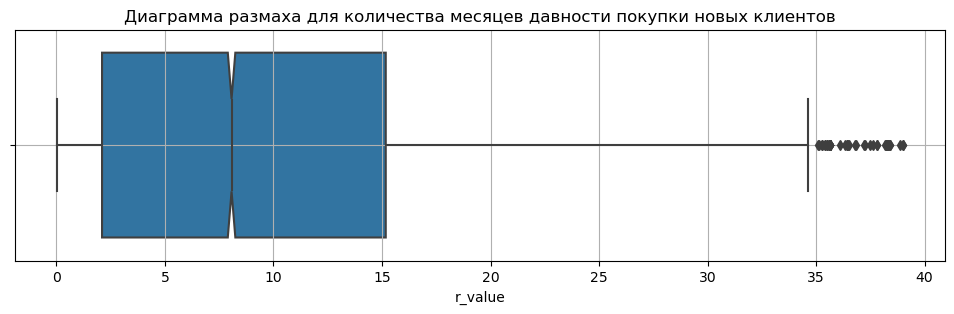

In [280]:
#построим диаграмму размаха
plt.figure(figsize=(12, 3))
sns.boxplot(x=rfm.r_value, notch=True)
plt.title('Диаграмма размаха для количества месяцев давности покупки новых клиентов')
plt.grid(True)
plt.show()

In [281]:
#выведем основные значения
rfm.r_value.describe()

count    13936.000000
mean         9.283621
std          7.689399
min          0.033333
25%          2.102407
50%          8.069491
75%         15.172639
max         38.983403
Name: r_value, dtype: float64

**По Диаграмме размаха для количества месяцев давности покупки новых клиентов** видим смещение середины влево, ближе к нулю,т.е. половина клиентов совершали покупки до 8  месяцев.  Среднее число месяцев давности покупок составляет 9 месяцев.

In [169]:
#посчитаем границу выбросов 
q1 = rfm['r_value'].quantile(0.25)
q3 = rfm['r_value'].quantile(0.75)
max_value = q3+1.5*(q3-q1)
min_value = q3-1.5*(q3-q1)
print('Верхняя граница значений давности покупок, в месяцах:', max_value)
print('Нижняя граница значений давности покупок, в месяцах:', min_value)

Верхняя граница значений давности покупок, в месяцах: 34.77798611111111
Нижняя граница значений давности покупок, в месяцах: -4.432708333333332


In [171]:
#обрежем аномальные значения
rfm_clean = rfm.query('r_value < @max_value')['r_value'].tolist()

In [173]:
#определим сегменты 0, 33, 66, 100%
r_bins = [0] + list(np.percentile(rfm_clean, [33, 66])) + [rfm.r_value.max()]
r_bins

[0, 3.3811398148148153, 11.631922222222222, 38.983402777777776]

In [175]:
r_labels = [3, 2, 1]

In [177]:
#создадим столбец давности покупок для новых клиентов
rfm['R'] = pd.cut(rfm.r_value, labels=r_labels, bins=r_bins, include_lowest=True)
rfm['R'].value_counts()

R
1    4771
3    4583
2    4582
Name: count, dtype: int64

Количество новых клиентов распределилось по сегментам приблизительно одинаково, сегменты по давностям покупок новых клиентов делятся от 0 до 3,4 месяцев, от 3,4 до 11,6 месяцев, и с 11,6 до 38,9 месяцев 

### R_VALUE Для старых клиентов

In [179]:
#сохраним максимальную дату платежей для новых клиентов, за исключением неоплаченных
work_date_old = df_order.query('status_ids !="notpaid"and user_old>0').datetime.max() + pd.Timedelta('1d')

In [181]:
#расчитаем период активности старых клиентов
rfm['period_old'] = (rfm.query('user_old>0').end_date - rfm.query('user_old>0').start_date) / pd.Timedelta('1d') + 1

In [183]:
#посчитаем как давно делали платеж старые клиенты 
rfm['r_value_old'] = (work_date_old - rfm.query('user_old>0').end_date) / pd.Timedelta('1d')/30

In [185]:
#посчитаем частоту платежей старых клиентов в месяц
rfm['f_value_old'] = (rfm.query('user_old>0').orders_count / rfm.query('user_old>0').period_old).round(2) * 30

In [187]:
#создадим столбец с суммой платежей старых клиентов
rfm['m_value_old'] = rfm.query('user_old>0').total_price

In [189]:
#посчитаем границу выбросов для старых клиентов
q1 = rfm.query('user_old>0')['r_value_old'].quantile(0.25)
q3 = rfm.query('user_old>0')['r_value_old'].quantile(0.75)
max_r_old = q3+1.5*(q3-q1)
min_r_old = q3-1.5*(q3-q1)
print('Верхняя граница значений давности покупок, в месяцах:', max_r_old)
print('Нижняя граница значений давности покупок, в месяцах:', min_r_old)

Верхняя граница значений давности покупок, в месяцах: 48.600069444444436
Нижняя граница значений давности покупок, в месяцах: 9.900069444444448


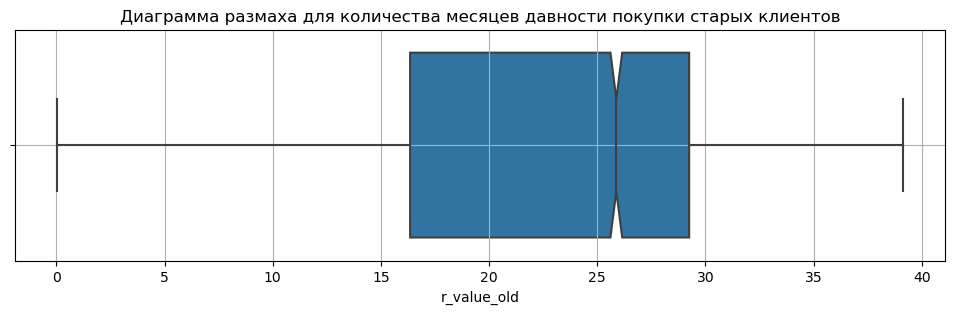

In [308]:
# построим диаграмму размаха
plt.figure(figsize=(12, 3))
sns.boxplot(x=rfm.r_value_old, notch=True)
plt.title('Диаграмма размаха для количества месяцев давности покупки старых клиентов')
plt.grid(True)
plt.show()

In [310]:
#выведем основные значения
rfm.r_value_old.describe()

count    5568.000000
mean       22.533494
std        11.072784
min         0.033333
25%        16.350069
50%        25.883403
75%        29.250069
max        39.116736
Name: r_value_old, dtype: float64

По Диаграмме размаха для количества месяцев давности покупки старых клиентов смещения вправо от середины, которая приходится уже на 25 месяца, получается что покупки старые клиенты совершают реже, чем новые. Среднее значение давности покупки приходится на 22 месяц.

In [191]:
#обрежем аномальные значения
rfm_clean_old = rfm.query('r_value_old < @max_r_old')['r_value_old'].tolist()

In [193]:
#определим сегменты 0, 33, 66, 100%
r_bins_old = [0] + list(np.percentile(rfm_clean_old, [33, 66])) + [rfm.r_value_old.max()]
r_bins_old

[0, 22.766824074074076, 27.750069444444442, 39.11673611111111]

In [195]:
#создадим столбец давности покупок для старых клиентов
rfm['R_old'] = pd.cut(rfm.r_value_old, labels=r_labels, bins=r_bins_old, include_lowest=True)
rfm['R_old'].value_counts()

R_old
1    1877
2    1853
3    1838
Name: count, dtype: int64

По давности покупок старые клиенты распределились приблизительно одинаково и группы составляют до 1000 человек. сегменты по давности покупок разделились: 0-22 месяцев, 22-27, 27-39 месяцев. Отметим, что старые клиенты делают покупки реже новых.

## F_VALUE Для новых клиентов

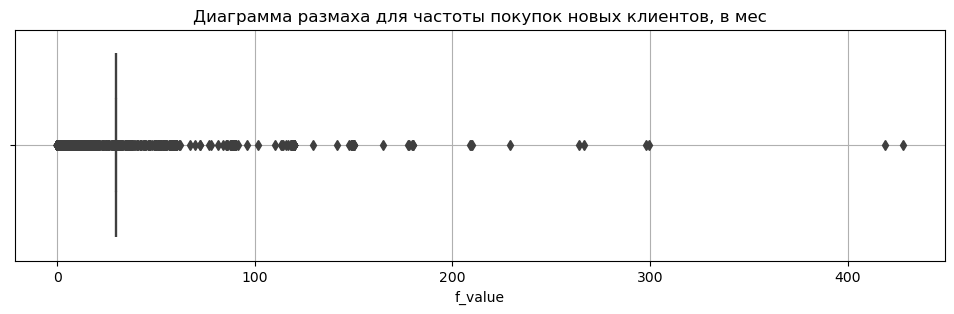

In [322]:
# построим диаграмму размаха
plt.figure(figsize=(12, 3))
sns.boxplot(x=rfm.f_value, notch=True)
plt.title('Диаграмма размаха для частоты покупок новых клиентов, в мес')
plt.grid(True)
plt.show()

In [197]:
#посчитаем границу выбросов 
q1 = rfm['f_value'].quantile(0.25)
q3 = rfm['f_value'].quantile(0.75)
max_f_top = q3+1.5*(q3-q1)
min_f_top = q3-1.5*(q3-q1)
print('Верхняя граница значений частоты покупок, в месяц:', max_f_top)
print('Нижняя граница значений частоты покупок, в месяц:', min_f_top)

Верхняя граница значений частоты покупок, в месяц: 30.0
Нижняя граница значений частоты покупок, в месяц: 30.0


In [199]:
#обрежем аномальные значения
f_clean = rfm.query('user_old<1')[rfm.query('user_old<1').f_value < max_f_top]['f_value'].tolist()

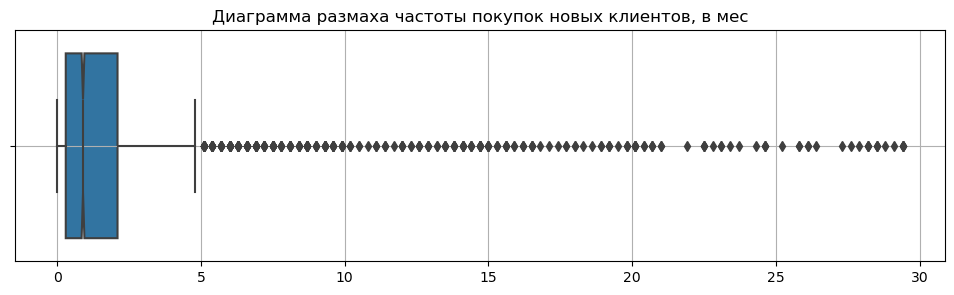

In [328]:
# построим диаграмму размаха
plt.figure(figsize=(12, 3))
sns.boxplot(x=f_clean, notch=True)
plt.title('Диаграмма размаха частоты покупок новых клиентов, в мес')
plt.grid(True)
plt.show()

In [329]:
#выведем основные значения
rfm.query('user_old<1')[rfm.query('user_old<1').f_value < max_f_top]['f_value'].describe()

count    3452.000000
mean        2.166309
std         3.847899
min         0.000000
25%         0.300000
50%         0.900000
75%         2.100000
max        29.400000
Name: f_value, dtype: float64

**По Диаграмме размаха частоты покупок новых клиентов** видим, что 75 % делают 2 покупки в месяц. Среднее значение также 2 в месяц.

In [201]:
#вычислим сегменты 0, 33, 66, 100 %
f_bins = [0] + list(np.percentile(f_clean, [33, 66])) + [rfm.query('user_old<1').f_value.max()]
f_bins 

[0, 0.6, 1.5, 427.8]

In [203]:
#т.к. в 33 и 66 % маленькие значения, зададим 60 и 75%, чтобы была частота 1 и 2 покупки в месяц
#вычислим сегменты 0, 60, 75, 100 %
f_bins = [0] + list(np.percentile(f_clean, [60, 75])) + [rfm.query('user_old<1').f_value.max()]
f_bins 

[0, 1.2, 2.1, 427.8]

In [205]:
#укажем градацию
f_labels = [1, 2, 3]

In [207]:
#создадим столбец сегментов частоты покупок новых клиентов
rfm['F'] = pd.cut(rfm.f_value, labels=f_labels, bins=f_bins, include_lowest=True)
rfm['F'].value_counts()

F
3    11256
1     2204
2      476
Name: count, dtype: int64

Много новых клиентов больше 2 пожертвований в месяц  - 11256 человек, 60% новых клиентов вносят от 0 до 1 пожертвований в месяц и это - 2204 человека, и реже от 1 до 2 - 476 человек

## F_VALUE Для старых клиентов

In [209]:
#посчитаем границу выбросов старых клиентов
q1 = rfm['f_value_old'].quantile(0.25)
q3 = rfm['f_value_old'].quantile(0.75)
max_f_top_old = q3+1.5*(q3-q1)
min_f_top_old = q3-1.5*(q3-q1)
print('Верхняя граница значений давности покупок, в месяцах:', max_f_top_old)
print('Нижняя граница значений давности покупок, в месяцах:', min_f_top_old)

Верхняя граница значений давности покупок, в месяцах: 73.65
Нижняя граница значений давности покупок, в месяцах: -13.650000000000006


In [211]:
#обрежем столбец до верхней границы
f_clean_old = rfm.query('user_old>0')[rfm.query('user_old>0').f_value_old < max_f_top_old]['f_value_old'].tolist()

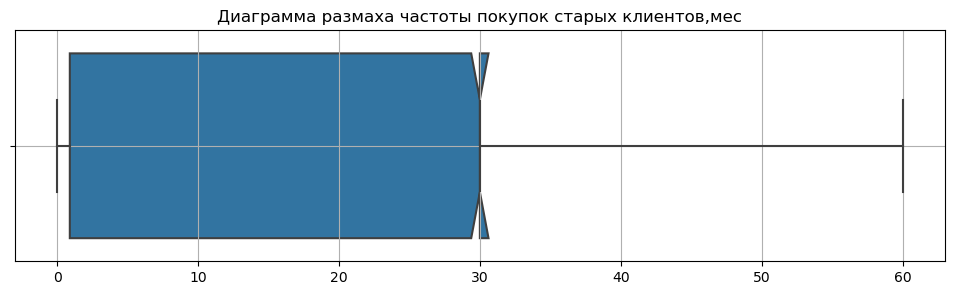

In [345]:
# построим диаграмму размаха
plt.figure(figsize=(12, 3))
sns.boxplot(x=f_clean_old, notch=True)
plt.title('Диаграмма размаха частоты покупок старых клиентов,мес')
plt.grid(True)
plt.show()

In [346]:
#выведем основные значения
rfm.query('user_old>0')[rfm.query('user_old>0').f_value_old < max_f_top_old]['f_value_old'].describe()

count    5544.000000
mean       19.409253
std        15.077077
min         0.000000
25%         0.900000
50%        30.000000
75%        30.000000
max        60.000000
Name: f_value_old, dtype: float64

**По Диаграмме размаха частоты покупок старых клиентов** видим, отсутствие покупок с середины до 75 %. Частота покупок превалирует до 30 в месяц. Граница частоты покупок 25% приходится на 0,9 в месяц. Получается, что новые клиенты делают меньше покупок в месяц, чем старые.

In [213]:
#вычислим сегменты 0, 33, 66, 100 %
f_bins_old = [0] + list(np.percentile(f_clean_old, [33, 66])) + [rfm.query('user_old>0').f_value_old.max()]
f_bins_old 

[0, 1.5, 30.0, 238.8]

In [215]:
#создадим столбец сегментов частоты покупок старых клиентов
rfm['F_old'] = pd.cut(rfm.query('user_old>0').f_value_old, labels=f_labels, bins=f_bins_old, include_lowest=True)
rfm['F_old'].value_counts()

F_old
2    3552
1    1890
3     126
Name: count, dtype: int64

Много старых клиентов вносят от 0 до 1 пожертвований в месяц - 1890 человек, дбольше 1 покупки и до 30 в месяц совершают - 3552 человека, больше всего людей, и выше 30 в месяц пожертвований - 126 человек

## M_VALUE Для новых клиентов

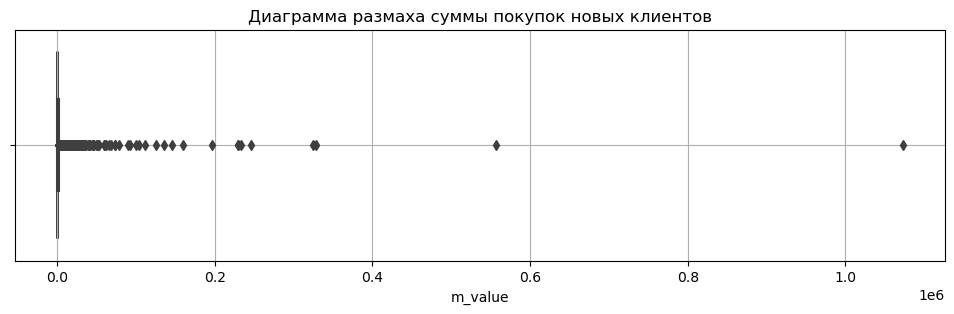

In [355]:
# построим диаграмму размаха
plt.figure(figsize=(12, 3))
sns.boxplot(x=rfm.m_value, notch=True)
plt.title('Диаграмма размаха суммы покупок новых клиентов')
plt.grid(True)
plt.show()

In [217]:
#посчитаем границу выбросов 
q1 = rfm['m_value'].quantile(0.25)
q3 = rfm['m_value'].quantile(0.75)
max_m_top = q3+1.5*(q3-q1)
min_m_top = q3-1.5*(q3-q1)
print('Верхняя граница значений суммы покупок:', max_m_top)
print('Нижняя граница значений суммы покупок:', min_m_top)

Верхняя граница значений суммы покупок: 2200.0
Нижняя граница значений суммы покупок: -200.0


In [219]:
#обрежем аномальные значения
m_clean = rfm.query('user_old<1')[rfm.query('user_old<1').m_value < max_m_top]['m_value'].tolist()

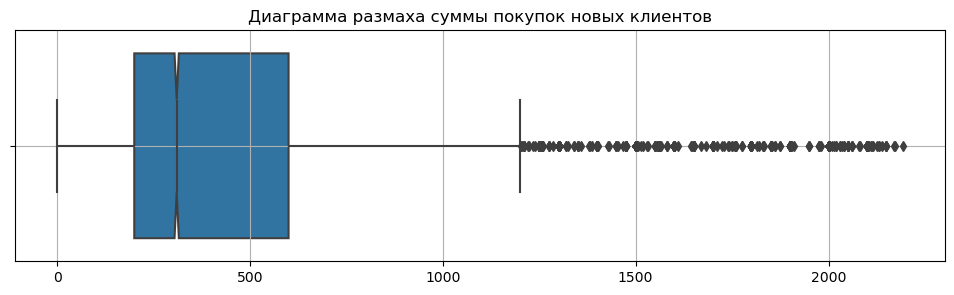

In [361]:
# построим диаграмму размаха
plt.figure(figsize=(12, 3))
sns.boxplot(x=m_clean, notch=True)
plt.title('Диаграмма размаха суммы покупок новых клиентов')
plt.grid(True)
plt.show()

In [362]:
#выведем основные значения
rfm.query('user_old<1')[rfm.query('user_old<1').m_value < max_m_top]['m_value'].describe()

count    12511.000000
mean       515.458556
std        471.738428
min          0.000000
25%        200.000000
50%        310.000000
75%        600.000000
max       2192.000000
Name: m_value, dtype: float64

По Диаграмме размаха суммы покупок новых клиентов видим, скошенность влево,т.е. 75% пожертвований приходится на сумму 650. Половина новых клиентов делает пожертвования до 400, среднее же значение - 531.

In [221]:
#вычислим сегменты 0, 33, 66, 100 %
m_bins = [0] + list(np.percentile(m_clean, [33, 66])) + [rfm.query('user_old<1').m_value.max()]
m_bins

[0, 300.0, 500.0, 1072500.0]

In [223]:
m_labels = [1, 2, 3]

In [225]:
#создадим столбец сегментов суммы покупок новых клиентов
rfm['M'] = pd.cut(rfm.query('user_old<1').m_value, labels=m_labels, bins=m_bins, include_lowest=True)
rfm['M'].value_counts()

M
1    6239
3    4852
2    2845
Name: count, dtype: int64

Отметим, что суммы покупок до 300 совершают больше всего новых клиентов и составляют 33%, от 300 до 500 меньше уже - меньше 2845 человек, и от 500 до 1072500 - 4852 человек

## M_VALUE Для старых клиентов

In [227]:
#посчитаем границу выбросов для старых клиентов
q1 = rfm['m_value_old'].quantile(0.25)
q3 = rfm['m_value_old'].quantile(0.75)
max_m_old = q3+1.5*(q3-q1)
min_m_old = q3-1.5*(q3-q1)
print('Верхняя граница значений суммы покупок:', max_m_old)
print('Нижняя граница значений суммы покупок:', min_m_old)

Верхняя граница значений суммы покупок: 4550.0
Нижняя граница значений суммы покупок: -550.0


In [229]:
#обрежем аномальные значения
m_clean_old = rfm.query('user_old>0')[rfm.query('user_old>0').m_value_old < max_m_old]['m_value_old'].tolist()

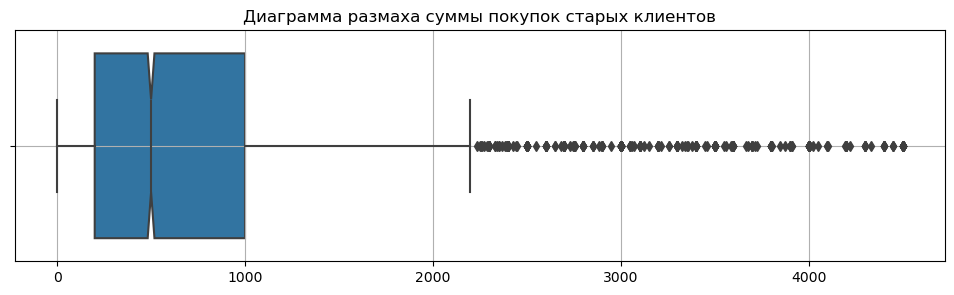

In [377]:
# построим диаграмму размаха
plt.figure(figsize=(12, 3))
sns.boxplot(x=m_clean_old, notch=True)
plt.title('Диаграмма размаха суммы покупок старых клиентов')
plt.grid(True)
plt.show()

In [378]:
#выведем основные значения
rfm.query('user_old>0')[rfm.query('user_old>0').m_value_old < max_m_old]['m_value_old'].describe()

count    4833.000000
mean      841.817298
std       934.650624
min         0.000000
25%       200.000000
50%       500.000000
75%      1000.000000
max      4500.000000
Name: m_value_old, dtype: float64

По Диаграмме размаха суммы покупок старых клиентов видим, скошенность  и смещение  влево,т.е. 75% пожертвований приходится на сумму 1000. Половина пожертвований имеет значение 500, среднее же значение - 841, что выше, чем у новых клиентов.

In [231]:
#вычислим сегменты 0, 33, 66, 100 %
m_bins_old = [0] + list(np.percentile(m_clean_old, [33, 66])) + [rfm.query('user_old>0').m_value_old.max()]
m_bins_old

[0, 300.0, 900.0, 315000.0]

In [233]:
#создадим столбец сегментов суммы покупок старых клиентов
rfm['M_old'] = pd.cut(rfm.query('user_old>0').m_value_old, labels=m_labels, bins=m_bins_old, include_lowest=True)
rfm['M_old'].value_counts()

M_old
3    2376
1    1885
2    1307
Name: count, dtype: int64

Отметим, что суммы покупок от 900 до 315000  совершают больше всего старых клиентов, от 0 до 300 меньше уже - 1885 человек, и до 300  - 900 - 1307 человек

### RFM - анализ для новых клиентов

In [235]:
#добавим функцию подписывающую значения над столбчатой диаграммой
def autolabel(rects, labels=None, height_factor=1.01):
    """
    функция создающая подписи над столбчатыми диаграмами
    """
    for i, rect in enumerate(rects):
        height = rect.get_height()
        if labels is not None:
            try:
                label = labels[i]
            except (TypeError, KeyError):
                label = ' '
        else:
            label = '%d' % int(height)
        ax.text(rect.get_x() + rect.get_width()/2., height_factor*height,
                '{}'.format(label),

                ha='center', va='bottom')

In [237]:
##добавим функцию подписывающую значения над столбчатой диаграммой в процентах
def without_hue(ax, feature):
    total = len(feature)
    for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_height()/total)
        x = p.get_x() + p.get_width() / 2 - 0.05
        y = p.get_y() + p.get_height()
        ax.annotate(percentage, (x, y), size = 11, ha='center')

In [239]:
#создадим столбец для новых клиентов
rfm['RFM'] = rfm.query('user_old<1').R.astype('str') + rfm.query('user_old<1').F.astype('str') + rfm.query('user_old<1').M.astype('str')


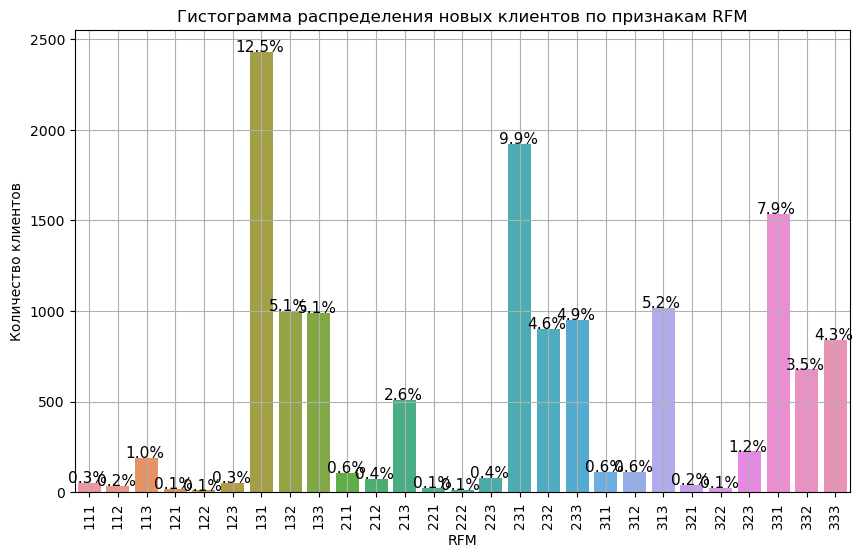

In [394]:
#Построим гистограмму распределения числа клиентов по rmf признакам
plt.figure(figsize = (10,6))
ax=sns.countplot(x=rfm['RFM'].sort_values(), data=rfm.query('user_old<1'))

#ax = plt.gca()
#autolabel(ax.patches,  height_factor=1.01)
without_hue(ax,rfm['RFM'])
plt.title('Гистограмма распределения новых клиентов по признакам RFM')
plt.xlabel( 'RFM')
plt.ylabel('Количество клиентов')
plt.grid(True)
plt.xticks(rotation=90)

plt.show();

Описание сегментов:  1- плохо, 3- хорошо

|Ранг/Показатель|R|F|M|
|:--|:--:|:--:|:--:|
|1|Не был больше чем 12 месяцев|Покупает 0-1 раз в месяц|Чек до 300|
|2|Был от 3 до 12 месяцев|Покупает от 1 до 2 раз в месяц|Чек от 300 до 500|
|3|Был меньше чем 3 месяца назад|Покупает чаще чем 2 раза в месяц|Чек выше 500|

|Сегмент|Тип клиентов|Стратегия|
|:--|:--|:--|
|313|**Ключевые**|Ваши мысли|
||-заказывали недавно||
||-редко обращаются| увеличивать частоту обращений|
||-много тратят||
|332, 331, 322|**Новые**|Ваши мысли|
||-заказывали недавно||
||-тратят редко или средне||
||-тратят не очень много| поднимать сумму чека|
|323, 233, 223,333|**Крупные**|Ваши мысли|
||-заказывают нерегулярно| увеличивать частоты обращений|
||-тратят много||
|232, 231, 222, 221, 212, 211|**Неактивные:**|Ваши мысли|
|| давно не обращались|увеличивать частоты обращений|
|213, 133, 123, 113|**Крупные неактивные**|Ваши мысли|
||-заказывали давно|повышать активность клиентов|
||-тратят много||
|321, 312, 311	|**Лояльные**|Ваши мысли| 
||недавно заказывали впервые| переводить в лояльных регулярностью|
|132, 131, 122, 121|**Почти потерянные:** |Ваши мысли|
||в прошлом много заказывали, но давно не обращались| переводить в лояльных регулярностью|
|112, 111|**Ушедшие**|Ваши мысли|
||-заказывали немного|увеличивать частоты обращений|
||-давно не обращались|и переводить в лояльных регулярностью|

**Гистограмма распределения новых клиентов по признакам RFM** показыавет, что больше всего процентов Неактивные - 15,7%.  На втором месте по числу клиентов  Почти потерянные среди новых клиентов 12,5%. Также много только что пришедших клиентов 11,5%, в том числе и крупных - 10,8%, которых можно вернуть. Важно проработать клиентскую базу по неактивным и почти потерянным, увеличить частоты обращений и перевести в сегмент лояльных клиентов.

In [241]:
#составим словарь
categories = {
              'новый':['332', '331', '322'],
              'крупный': ['323', '233', '223','333'],
              'неактивный':['232', '231', '222', '221', '212', '211'],
              'крупный неактивный':['213', '133', '123', '113'], 
              'лояльный':['321', '312', '311'],
              'почти потерянный':['132', '131', '122', '121'],
              'ушедший':['112', '111'],
              'ключевой':'313'
             }
#добавим функцию категоризации клиентов
def make_segments(row):
    for category, keywords in categories.items():
        if any(keyword in row for keyword in keywords):
            return category
   

In [243]:
#сегментируем всех  новых клиентов
rfm['segment'] = rfm.query('user_old<1').RFM.apply(make_segments)

In [245]:
#выведем для всех клиентов по сегментам число клиентов, сумму пожертвований и как давно клиенты
rfm.groupby('segment').agg({'id': 'nunique',
                            'total_price': 'sum',
                            'period': 'mean'}).reset_index().rename(columns={
                                'id': 'clients_count',
                                'total_price': 'segment_income',
                                'period': 'lifetime'
                            }).style.highlight_max(subset=['clients_count', 'segment_income', 'lifetime'], color='lime')

,segment,clients_count,segment_income,lifetime
0,ключевой,1017,5145404,355.934380
1,крупный,2099,8947447,41.462589
2,крупный неактивный,1736,4519936,105.471728
3,лояльный,263,80999,229.484152
4,неактивный,3041,879118,15.160026
5,новый,2236,627012,4.003487
6,почти потерянный,3458,878674,1.753682
7,ушедший,86,26389,140.973506


Также и по таблице для новых клиентов видим, что самое большое число  клиентов приходится на сегмент почти потерянных. Больше всего пожертвований сделали ключевые клиенты. А дольше всего остаются в контакте с фирмой Ключевые, их число чуть больше 1000 людей и они на втором месте по принесенной прибыли. Лояльные клиенты больше 7 месяцев с фирмой и их численность мала, всего 263 человека. Новые и  почти потерянные контактировали с фирмой 4 и  1 день соответственно, с ними важно развивать долгосрочные отношения.

### RFM - анализ для старых клиентов

In [247]:
#выведем столбец для старых клиентов
rfm['RFM_old'] = rfm.query('user_old>0').R_old.astype('str') + rfm.query('user_old>0').\
                                F_old.astype('str') + rfm.query('user_old>0').M_old.astype('str')


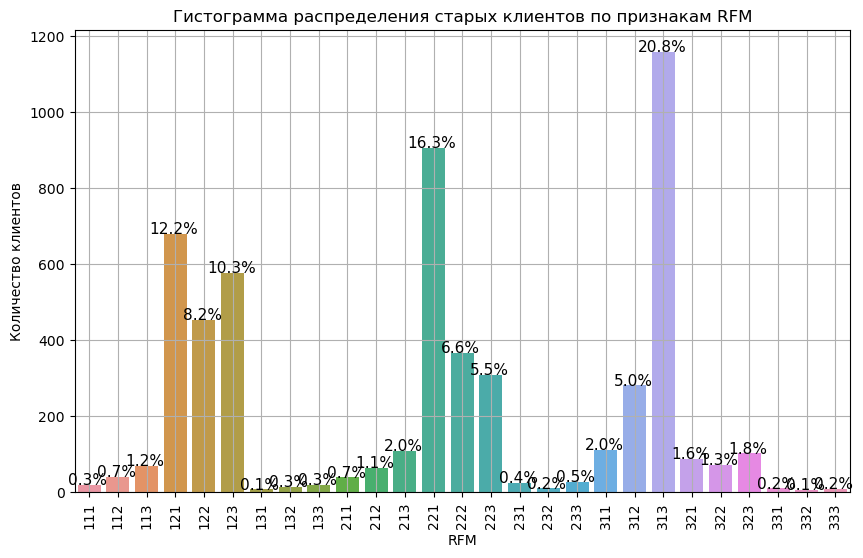

In [409]:
#Построим гистограмму распределения числа старых клиентов по rmf признакам
plt.figure(figsize = (10,6))
ax=sns.countplot(x=rfm.query('user_old>0')['RFM_old'].sort_values(), data=rfm.query('user_old>0'))

plt.title('Гистограмма распределения старых клиентов по признакам RFM')
plt.xlabel( 'RFM')
plt.ylabel('Количество клиентов')
plt.grid(True)
plt.xticks(rotation=90)
without_hue(ax,rfm.query('user_old>0')['RFM_old'])

plt.show();

Описание сегментов старых клиентов:   1- плохо, 3- хорошо

|Ранг/Показатель|R|F|M|
|:--|:--:|:--:|:--:|
|1|Не был больше чем 27 месяцев|Покупает от 0 до 1 раза в месяц |Чек до 300|
|2|Был от 22 до 27 месяцев|Покупает от 1 до 30 раз в месяц|Чек от 300 до 900|
|3|Был меньше чем 22 месяцев назад|Покупает чаще чем 30 раз в  месяц|Чек выше 900|

In [249]:
#сегментируем старых клиентов
rfm['segment_old'] = rfm.query('user_old>0').RFM_old.apply(make_segments)

In [251]:
#выведем для старых клиентов по сегментам число клиентов, сумму пожертвований и как давно клиенты
rfm.query('user_old>0').groupby('segment_old').agg({'id': 'nunique',
                            'total_price': 'sum',
                            'period_old': 'mean'}).reset_index().rename(columns={
                                'id': 'clients_count',
                                'total_price': 'segment_income',
                                'period_old': 'lifetime'
                            }).style.highlight_max(subset=['clients_count', 'segment_income', 'lifetime'], color='lime')

,segment_old,clients_count,segment_income,lifetime
0,ключевой,1158,10313983,717.725712
1,крупный,446,2566850,88.312843
2,крупный неактивный,772,3669196,51.072144
3,лояльный,481,213688,407.709181
4,неактивный,1409,413756,12.100600
5,новый,88,40700,19.042992
6,почти потерянный,1155,355891,2.023377
7,ушедший,59,27625,124.139101


Также и по таблице для **старых клиентов** видим, что самое большое число  клиентов приходится на сегмент неактивных. Больше всего пожертвований и дольше всего остаются в контакте с фирмой **ключевые клиенты**, они занимают долю 20,8% и это больше, чем среди новых клиентов. **Лояльные клиенты** также долго с фирмой и их численность на четвертом месте, после почти потеренных - больше 20%, неактивных и ключевых, и больше года  контактируют с фирмой. Причем число ключевых среди старых клиентов сильно не отличается от лидирующих сегментов и находится на третьем месте. Меньше всего по времени находятся с фирмой в контакте среди старых клиентов сегмент почти потерянных - 2 дня. С ними важно развивать долгосрочные отношения. Интересно что и старые и новые клиенты имеют в сегменте ушедшие самое маленькое число. 

### Дополнительный анализ сегментов клиентов

In [140]:
#добавим в таблицу данные о сегментах
df_donor = pd.merge(df_donor, rfm[['id', 'segment', 'segment_old']],how="left", left_on='mindbox_id', right_on='id')
df_donor.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23820 entries, 0 to 23819
Data columns (total 20 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   recurrent        5923 non-null   object        
 1   volunteer        6 non-null      object        
 2   sex              18715 non-null  object        
 3   area_id          5044 non-null   object        
 4   area_name        5044 non-null   object        
 5   timezone         11623 non-null  object        
 6   timezone_source  11623 non-null  object        
 7   mindbox_id       23820 non-null  int64         
 8   email_invalid    23396 non-null  object        
 9   datetime         23820 non-null  datetime64[ns]
 10  subs             20 non-null     object        
 11  subs_sms         44 non-null     object        
 12  subs_email       23478 non-null  object        
 13  subs_viber       20 non-null     object        
 14  subs_mobile      20 non-null     objec

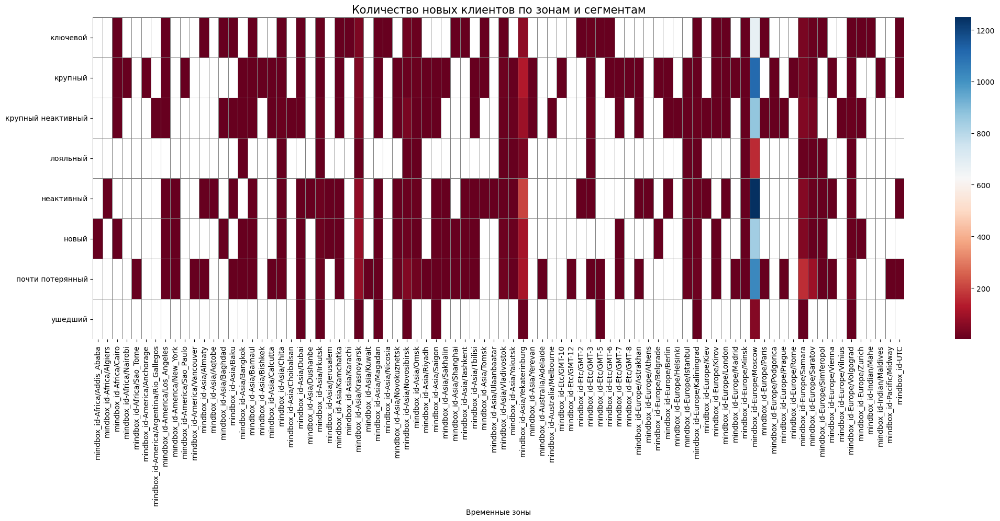

In [141]:
#выведем тепловую карту Количества новых клиентов по зонам и сегментам
plt.figure(figsize = (25,8))
sns.heatmap(df_donor.pivot_table(index=['segment'],columns=['timezone'], \
                             values=['mindbox_id'], aggfunc='count'), linewidth=.5, linecolor='grey', cmap='RdBu')
plt.title('Количество новых клиентов по зонам и сегментам', fontsize = 15)
plt.xlabel('Временные зоны')
plt.ylabel('')
plt.show();

**По данным новых клиентов** отметим, что у сегментов лояльные и ушедшие мало заполненных временных зон, либо они не указаны в карточке,т.к. присутствуют в базе больше 50 % пропусков напомню, либо действительно в только в имеющихся зонах клиенты. Высокое количество клиентов приходятся на зоны и сегменты:

- **Крупные, Крупный неактивный, Лояльные и Неактивный, Почти потерянные, Новые*** : На первом месте по численности Москва, на втором Екатеринбург

- Среди **Почти потерянных** также отмечается города Самара, Саратов.  


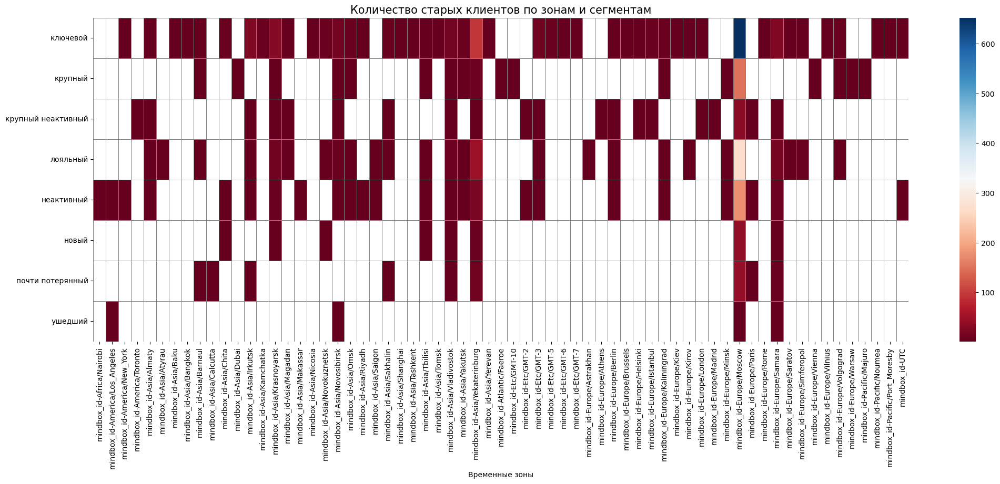

In [142]:
#выведем тепловую карту Количества старых клиентов по зонам и сегментам
plt.figure(figsize = (25,8))
sns.heatmap(df_donor.pivot_table(index=['segment_old'],columns=['timezone'], \
                             values=['mindbox_id'], aggfunc='count'), linewidth=.5, linecolor='grey', cmap='RdBu')
plt.title('Количество старых клиентов по зонам и сегментам', fontsize = 15)
plt.xlabel('Временные зоны')
plt.ylabel('')
plt.show();

По данным старых клиентов отметим, что у сегментов крупные, новые и почти потерянные мало заполненных временных зон, либо они не указаны в карточке,т.к. присутствуют в базе больше 50 % пропусков напомню, либо действительно в только в имеющихся зонах клиенты, причем самих зон меньше чем по таблице с новыми клиентами. Высокое количество клиентов приходятся на зоны и сегменты:


- **Ключевой сегмент, Крупные, Крупный неактивный, Лояльные и Неактивный, Почти потерянные, Новые*** : На первом месте по численности Москва
  
- **Ушедшие**: всего четыре города Лос-Анджелес, Москва, Самара и Новосибирск.


In [253]:
#добавим в таблицу данные о старых пользователях
df_order = pd.merge(df_order, rfm[['id', 'segment', 'segment_old']],how="left", left_on='mindbox_id', right_on='id')
df_order.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73763 entries, 0 to 73762
Data columns (total 19 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   order_ids         73763 non-null  int64         
 1   first_action_ids  73763 non-null  int64         
 2   datetime          73763 non-null  datetime64[ns]
 3   channel_ids       73763 non-null  int64         
 4   total_price       73763 non-null  int64         
 5   fields_newyear    1881 non-null   object        
 6   recurrent         61311 non-null  object        
 7   repayment         5970 non-null   object        
 8   product_name      73453 non-null  object        
 9   status_ids        73763 non-null  object        
 10  mindbox_id        73763 non-null  int64         
 11  year_month        73763 non-null  object        
 12  hour              73763 non-null  object        
 13  user_old          73763 non-null  int32         
 14  timezone          5482

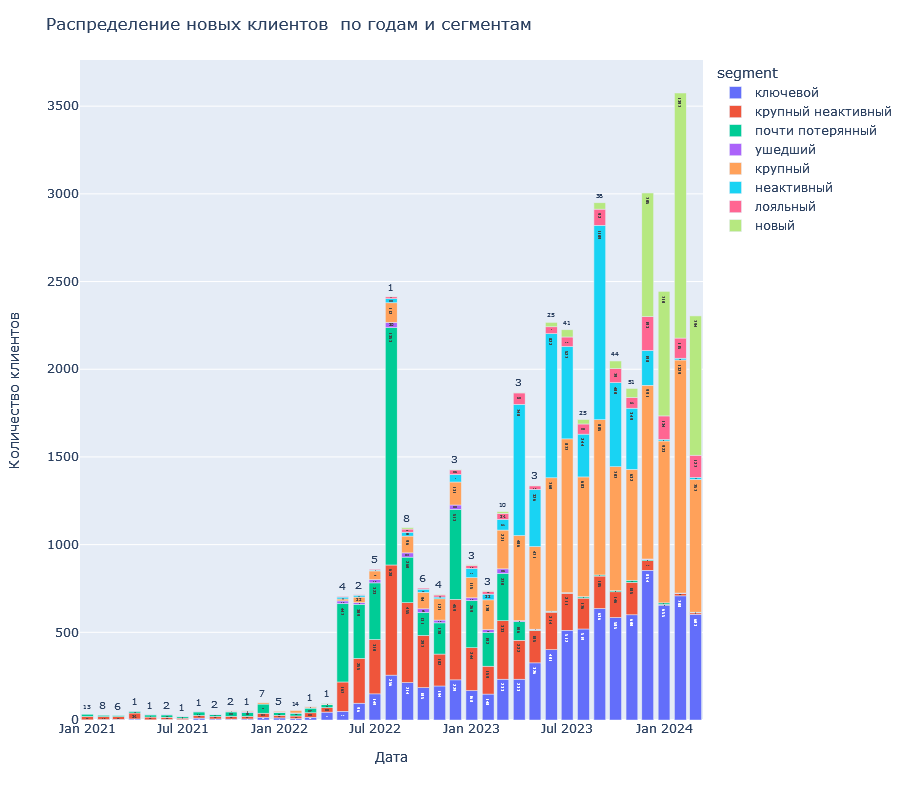

In [144]:
#построим график по сводной таблице - зависимости количество клиентов  от годам и сегментам
z = df_order.groupby(['year_month', 'segment'], as_index=False)['mindbox_id'].count()
# строим график

fig = px.bar(z,
             x='year_month',
             y='mindbox_id',
             color='segment',
             text='mindbox_id'
            )

# оформляем график
fig.update_layout(xaxis={'categoryorder':'total descending'},
    title='Распределение новых клиентов  по годам и сегментам',
                   xaxis_title='Дата',
                   yaxis_title='Количество клиентов',
                   width=1500, # указываем размеры графика
                   height=800)

fig.show() # выводим график

**По графику Распределение новых клиентов  по годам и сегментам** видим, что с годами увеличивается число ключевых клиентов. С октября 2023 года значительно снизилась численность крупных неактивных, а количество крупных возрасло, возможно работали с возвратом крупных неактивных клиентов. А после апреля 2023 года почти потеренных нет, но растет сегмент неактивных. С декабря 2023 года большое количество новых.

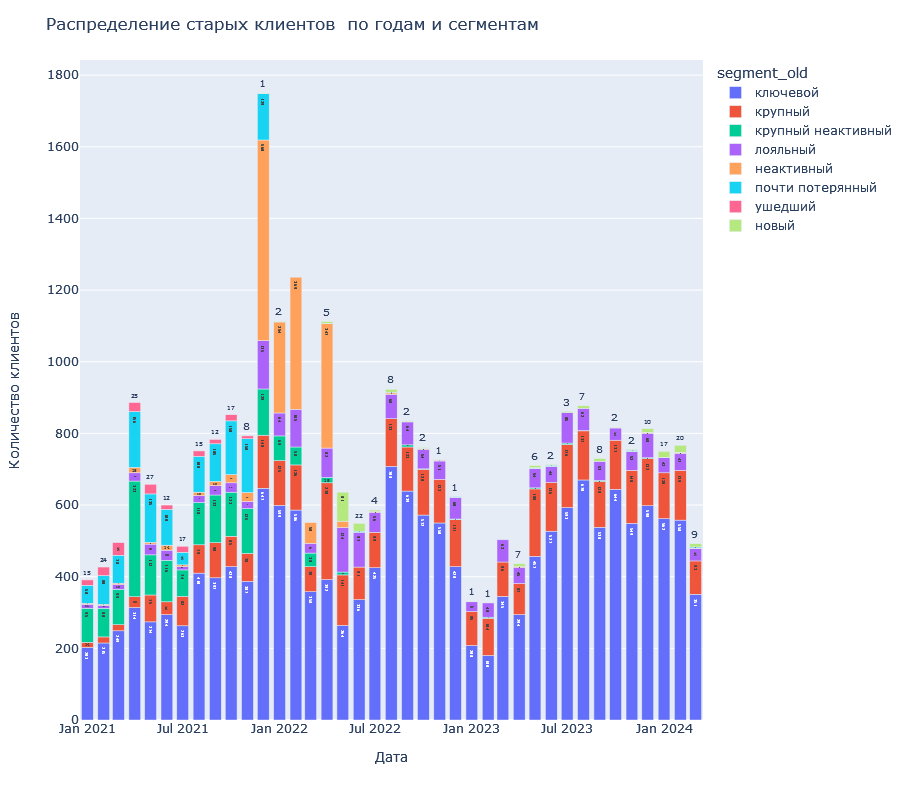

In [145]:
#построим график по сводной таблице - зависимости количество клиентов  от годам и сегментам
z = df_order.groupby(['year_month', 'segment_old'], as_index=False)['mindbox_id'].count()
# строим график

fig = px.bar(z,
             x='year_month',
             y='mindbox_id',
             color='segment_old',
             text='mindbox_id'
            )

# оформляем график
fig.update_layout(xaxis={'categoryorder':'total descending'},
    title='Распределение старых клиентов  по годам и сегментам',
                   xaxis_title='Дата',
                   yaxis_title='Количество клиентов',
                   width=1500, # указываем размеры графика
                   height=800)

fig.show() # выводим график

**По графику Распределения старых клиентов  по годам и сегментам** выделим большое число клиентов из ключевого сегмента, которые в январе-феврале 2023 года имеют малую численность, дальше наблюдается рост. До середины 2022 года есть значительное число старых клиентов в сегменте крупный неактивный, после численность этих сегментов значительно снижена. В декабре 2021 большой пик численности клиентов со значительной частью лояльного и неактивного сегмента.После апреля 2022 г снижается число неактивных.

# Шаг 4.Когортный анализ  <a class="anchor" id="Шаг_4._Когортный_анализ"></a>

In [255]:
def get_profiles(profile):

    # сортируем сессии по ID пользователя и дате посещения
    # группируем по ID и находим первые значения datetime и channel
    # столбец с временем первого посещения назовём first_ts
    # от англ. first timestamp — первая временная отметка
    profiles = (
        df_order.sort_values(by=['mindbox_id', 'datetime', 'year_month'])
        .groupby('mindbox_id')
        .agg({'datetime': 'first', 'channel_ids': 'first','user_old': 'first', 'year_month':'first'})
        .rename(columns={'datetime': 'first_ts'})
        .reset_index()  # возвращаем user_id из индекса
    )

    # определяем дату первого посещения
    # и первый день месяца, в который это посещение произошло
    # эти данные понадобятся для когортного анализа
    profiles['dt'] = profiles['first_ts'].dt.date

    return profiles

In [257]:
profiles = get_profiles(df_order)
profiles

,mindbox_id,first_ts,channel_ids,user_old,year_month,dt
0,2734,2021-03-18 10:52:00,1,1,2021-03,2021-03-18
1,2847,2021-06-16 23:10:00,1,1,2021-06,2021-06-16
2,2861,2021-03-16 12:24:00,1,1,2021-03,2021-03-16
3,3361,2022-12-20 09:31:00,9,1,2022-12,2022-12-20
4,4982,2021-01-01 20:52:00,1,1,2021-01,2021-01-01
...,...,...,...,...,...,...
21365,46784,2024-03-18 07:25:00,9,0,2024-03,2024-03-18
21366,46785,2024-03-18 08:57:00,9,0,2024-03,2024-03-18
21367,46786,2024-03-18 09:18:00,9,0,2024-03,2024-03-18
21368,46787,2024-03-18 11:43:00,9,0,2024-03,2024-03-18


In [259]:
# присоединяем order к профилям по столбцу mindbox_id

result_raw = profiles.merge(
    df_order[['mindbox_id', 'datetime']], on='mindbox_id', how='left'
)

result_raw

,mindbox_id,first_ts,channel_ids,user_old,year_month,dt,datetime
0,2734,2021-03-18 10:52:00,1,1,2021-03,2021-03-18,2021-10-14 15:50:00
1,2734,2021-03-18 10:52:00,1,1,2021-03,2021-03-18,2021-03-18 10:52:00
2,2734,2021-03-18 10:52:00,1,1,2021-03,2021-03-18,2022-11-23 08:42:00
3,2847,2021-06-16 23:10:00,1,1,2021-06,2021-06-16,2021-06-16 23:10:00
4,2847,2021-06-16 23:10:00,1,1,2021-06,2021-06-16,2023-03-29 15:15:00
...,...,...,...,...,...,...,...
73758,46785,2024-03-18 08:57:00,9,0,2024-03,2024-03-18,2024-03-18 08:57:00
73759,46786,2024-03-18 09:18:00,9,0,2024-03,2024-03-18,2024-03-18 09:18:00
73760,46786,2024-03-18 09:18:00,9,0,2024-03,2024-03-18,2024-03-18 09:21:00
73761,46787,2024-03-18 11:43:00,9,0,2024-03,2024-03-18,2024-03-18 11:43:00


In [261]:
#введем столбец lifetime в месяцах для новых клиентов
result_raw['lifetime'] = ((result_raw.datetime- result_raw.first_ts).dt.days/30).astype('int')

In [263]:
#составим таблицу жизни когорт новых клиентов по Месяцам-Годам, время жизни в месяцах
result_grouped = result_raw.query('user_old<1').pivot_table(
    index=['year_month'], columns='lifetime', values='mindbox_id', aggfunc='nunique')#, fill_value=0 )
cohort_size = result_grouped.iloc[:, 0]
retention_matrix = result_grouped.divide(cohort_size, axis=0)

result_grouped

lifetime,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36
year_month,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-01,25.0,11.0,3.0,7.0,6.0,7.0,6.0,6.0,5.0,5.0,7.0,5.0,3.0,2.0,NaN,NaN,NaN,1.0,NaN,2.0,1.0,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,1.0
2021-02,8.0,NaN,2.0,1.0,2.0,2.0,2.0,2.0,3.0,3.0,2.0,2.0,2.0,NaN,NaN,1.0,1.0,1.0,2.0,3.0,2.0,3.0,NaN,1.0,NaN,NaN,NaN,1.0,1.0,1.0,1.0,1.0,2.0,NaN,1.0,1.0,1.0
2021-03,11.0,4.0,4.0,3.0,3.0,2.0,2.0,4.0,3.0,2.0,4.0,3.0,2.0,1.0,2.0,1.0,1.0,2.0,2.0,2.0,3.0,NaN,NaN,NaN,NaN,1.0,2.0,2.0,2.0,2.0,2.0,1.0,1.0,1.0,1.0,1.0,NaN
2021-04,30.0,3.0,1.0,2.0,2.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,2.0,NaN,1.0,2.0,2.0,NaN,1.0,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,1.0,2.0,1.0,NaN
2021-05,13.0,NaN,NaN,1.0,1.0,1.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,2.0,2.0,1.0,1.0,NaN,1.0,1.0,NaN,NaN,NaN,NaN,NaN
2021-06,17.0,2.0,1.0,2.0,2.0,1.0,NaN,NaN,2.0,1.0,2.0,2.0,1.0,1.0,1.0,2.0,1.0,2.0,1.0,1.0,1.0,1.0,2.0,2.0,1.0,1.0,NaN,2.0,1.0,1.0,1.0,1.0,1.0,NaN,NaN,NaN,NaN
2021-07,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-08,29.0,1.0,3.0,1.0,1.0,NaN,3.0,1.0,1.0,3.0,1.0,1.0,2.0,1.0,3.0,2.0,NaN,1.0,2.0,3.0,2.0,2.0,1.0,1.0,2.0,2.0,2.0,NaN,2.0,1.0,2.0,2.0,NaN,NaN,NaN,NaN,NaN
2021-09,20.0,NaN,1.0,1.0,3.0,1.0,1.0,1.0,NaN,1.0,2.0,2.0,3.0,NaN,1.0,1.0,NaN,1.0,NaN,1.0,1.0,2.0,NaN,1.0,1.0,1.0,1.0,1.0,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [265]:
#тепловая карта распределение жизни когорт Новых клиентов помесячно
retention_matrix.style.format( "{:.0%}").background_gradient(
                axis=None,
                cmap="Blues").highlight_null(color='lightgrey')
    


lifetime,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36
year_month,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-01,100%,44%,12%,28%,24%,28%,24%,24%,20%,20%,28%,20%,12%,8%,nan%,nan%,nan%,4%,nan%,8%,4%,4%,4%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,4%,nan%,nan%,nan%,nan%,nan%,4%
2021-02,100%,nan%,25%,12%,25%,25%,25%,25%,38%,38%,25%,25%,25%,nan%,nan%,12%,12%,12%,25%,38%,25%,38%,nan%,12%,nan%,nan%,nan%,12%,12%,12%,12%,12%,25%,nan%,12%,12%,12%
2021-03,100%,36%,36%,27%,27%,18%,18%,36%,27%,18%,36%,27%,18%,9%,18%,9%,9%,18%,18%,18%,27%,nan%,nan%,nan%,nan%,9%,18%,18%,18%,18%,18%,9%,9%,9%,9%,9%,nan%
2021-04,100%,10%,3%,7%,7%,nan%,nan%,3%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,3%,nan%,7%,nan%,3%,7%,7%,nan%,3%,nan%,nan%,nan%,nan%,nan%,3%,3%,3%,3%,3%,7%,3%,nan%
2021-05,100%,nan%,nan%,8%,8%,8%,nan%,nan%,nan%,8%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,8%,15%,15%,8%,8%,nan%,8%,8%,nan%,nan%,nan%,nan%,nan%
2021-06,100%,12%,6%,12%,12%,6%,nan%,nan%,12%,6%,12%,12%,6%,6%,6%,12%,6%,12%,6%,6%,6%,6%,12%,12%,6%,6%,nan%,12%,6%,6%,6%,6%,6%,nan%,nan%,nan%,nan%
2021-07,100%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%
2021-08,100%,3%,10%,3%,3%,nan%,10%,3%,3%,10%,3%,3%,7%,3%,10%,7%,nan%,3%,7%,10%,7%,7%,3%,3%,7%,7%,7%,nan%,7%,3%,7%,7%,nan%,nan%,nan%,nan%,nan%
2021-09,100%,nan%,5%,5%,15%,5%,5%,5%,nan%,5%,10%,10%,15%,nan%,5%,5%,nan%,5%,nan%,5%,5%,10%,nan%,5%,5%,5%,5%,5%,5%,5%,nan%,nan%,nan%,nan%,nan%,nan%,nan%


**По тепловой карте распределение жизни когорт Новых клиентов помесячно** видим, что когорты новых клиентов стали наполняться с мая 2022 года, а дальше проявляют активность около  5 %. По таблице выше отметим, что когорты с численностью выше 1000  делали пожертвования 09-2023,   04-2023,  08-2022,   12-2023,   02-2024г. 

In [267]:
#составим таблицу жизни когорт старых клиентов по Месяцам-Годам, время жизни в месяцах
result_grouped_old = result_raw.query('user_old>0').pivot_table(
    index=['year_month'], columns='lifetime', values='mindbox_id', aggfunc='nunique')#, fill_value=0 )
cohort_size_old = result_grouped_old.iloc[:, 0]
retention_matrix_old = result_grouped_old.divide(cohort_size_old, axis=0)
result_grouped_old

lifetime,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38
year_month,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-01,328.0,215.0,66.0,183.0,180.0,174.0,162.0,166.0,158.0,154.0,156.0,155.0,159.0,153.0,85.0,31.0,31.0,32.0,39.0,123.0,123.0,117.0,111.0,38.0,29.0,29.0,25.0,33.0,40.0,49.0,48.0,62.0,53.0,60.0,59.0,55.0,61.0,56.0,36.0
2021-02,164.0,42.0,37.0,26.0,38.0,37.0,41.0,39.0,40.0,37.0,39.0,35.0,43.0,15.0,17.0,18.0,19.0,27.0,34.0,32.0,33.0,29.0,16.0,16.0,12.0,18.0,22.0,24.0,25.0,26.0,25.0,21.0,25.0,25.0,21.0,22.0,23.0,14.0,NaN
2021-03,189.0,47.0,34.0,30.0,27.0,35.0,31.0,32.0,29.0,30.0,28.0,29.0,15.0,15.0,11.0,16.0,17.0,25.0,24.0,28.0,23.0,18.0,13.0,10.0,12.0,7.0,14.0,21.0,18.0,23.0,24.0,22.0,21.0,22.0,16.0,27.0,14.0,NaN,NaN
2021-04,521.0,49.0,43.0,36.0,45.0,34.0,32.0,47.0,33.0,41.0,38.0,26.0,16.0,20.0,31.0,24.0,39.0,40.0,32.0,38.0,26.0,21.0,19.0,17.0,32.0,22.0,29.0,32.0,36.0,30.0,30.0,38.0,21.0,29.0,31.0,19.0,NaN,NaN,NaN
2021-05,250.0,30.0,31.0,35.0,30.0,38.0,32.0,27.0,29.0,27.0,14.0,9.0,10.0,14.0,7.0,28.0,27.0,25.0,21.0,10.0,9.0,12.0,9.0,10.0,9.0,13.0,16.0,17.0,15.0,15.0,13.0,12.0,12.0,15.0,9.0,NaN,NaN,NaN,NaN
2021-06,205.0,35.0,31.0,26.0,25.0,24.0,29.0,25.0,25.0,17.0,5.0,9.0,7.0,8.0,20.0,19.0,19.0,19.0,7.0,7.0,7.0,13.0,10.0,8.0,14.0,15.0,13.0,15.0,17.0,11.0,16.0,18.0,13.0,8.0,NaN,NaN,NaN,NaN,NaN
2021-07,59.0,16.0,17.0,16.0,18.0,14.0,15.0,13.0,7.0,2.0,4.0,6.0,5.0,10.0,11.0,9.0,7.0,5.0,4.0,2.0,2.0,6.0,3.0,8.0,8.0,7.0,8.0,11.0,6.0,4.0,8.0,6.0,4.0,NaN,NaN,NaN,NaN,NaN,NaN
2021-08,217.0,35.0,32.0,40.0,26.0,32.0,28.0,18.0,12.0,17.0,9.0,13.0,25.0,25.0,20.0,21.0,16.0,11.0,11.0,16.0,15.0,20.0,22.0,21.0,22.0,27.0,19.0,18.0,22.0,21.0,24.0,7.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-09,227.0,37.0,39.0,33.0,38.0,30.0,14.0,15.0,15.0,19.0,20.0,33.0,28.0,25.0,29.0,10.0,10.0,7.0,9.0,10.0,13.0,23.0,26.0,25.0,22.0,27.0,16.0,22.0,23.0,24.0,13.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [269]:
#тепловая карта распределение жизни когорт Старых клиентов помесячно
retention_matrix_old.style.format( "{:.0%}").background_gradient(
                axis=None,
                cmap='Blues').highlight_null(color='lightgrey') 

lifetime,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38
year_month,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2021-01,100%,66%,20%,56%,55%,53%,49%,51%,48%,47%,48%,47%,48%,47%,26%,9%,9%,10%,12%,38%,38%,36%,34%,12%,9%,9%,8%,10%,12%,15%,15%,19%,16%,18%,18%,17%,19%,17%,11%
2021-02,100%,26%,23%,16%,23%,23%,25%,24%,24%,23%,24%,21%,26%,9%,10%,11%,12%,16%,21%,20%,20%,18%,10%,10%,7%,11%,13%,15%,15%,16%,15%,13%,15%,15%,13%,13%,14%,9%,nan%
2021-03,100%,25%,18%,16%,14%,19%,16%,17%,15%,16%,15%,15%,8%,8%,6%,8%,9%,13%,13%,15%,12%,10%,7%,5%,6%,4%,7%,11%,10%,12%,13%,12%,11%,12%,8%,14%,7%,nan%,nan%
2021-04,100%,9%,8%,7%,9%,7%,6%,9%,6%,8%,7%,5%,3%,4%,6%,5%,7%,8%,6%,7%,5%,4%,4%,3%,6%,4%,6%,6%,7%,6%,6%,7%,4%,6%,6%,4%,nan%,nan%,nan%
2021-05,100%,12%,12%,14%,12%,15%,13%,11%,12%,11%,6%,4%,4%,6%,3%,11%,11%,10%,8%,4%,4%,5%,4%,4%,4%,5%,6%,7%,6%,6%,5%,5%,5%,6%,4%,nan%,nan%,nan%,nan%
2021-06,100%,17%,15%,13%,12%,12%,14%,12%,12%,8%,2%,4%,3%,4%,10%,9%,9%,9%,3%,3%,3%,6%,5%,4%,7%,7%,6%,7%,8%,5%,8%,9%,6%,4%,nan%,nan%,nan%,nan%,nan%
2021-07,100%,27%,29%,27%,31%,24%,25%,22%,12%,3%,7%,10%,8%,17%,19%,15%,12%,8%,7%,3%,3%,10%,5%,14%,14%,12%,14%,19%,10%,7%,14%,10%,7%,nan%,nan%,nan%,nan%,nan%,nan%
2021-08,100%,16%,15%,18%,12%,15%,13%,8%,6%,8%,4%,6%,12%,12%,9%,10%,7%,5%,5%,7%,7%,9%,10%,10%,10%,12%,9%,8%,10%,10%,11%,3%,nan%,nan%,nan%,nan%,nan%,nan%,nan%
2021-09,100%,16%,17%,15%,17%,13%,6%,7%,7%,8%,9%,15%,12%,11%,13%,4%,4%,3%,4%,4%,6%,10%,11%,11%,10%,12%,7%,10%,10%,11%,6%,nan%,nan%,nan%,nan%,nan%,nan%,nan%,nan%


**По тепловой карте распределение жизни когорт старых клиентов помесячно** и таблицы выше видим, что после  05-2022 численность когорт старых клиентов значительно снизилась  в следующие месяцы и не достигает и 10 человек, связано с началом переноса старых клиентов. От когорты с 01-2021 дошло до нынешнего момента 11%.

# Шаг 5. Выводы  <a class="anchor" id="Шаг_5._Выводы"></a>

**Всего клиентов в базе 23820 человек**

**Емайл 21474 клиентов рабочий, 1922 человека имеют ошибочный почтовый ящик и меньше 2% без емайла.**

**7343 импортированных старых клиентов, остальные новые**

**Период продаж указан с 1 января 2021 год по 18 марта 2024 год.**

**Процент импортированных старых клиентов, которые ушли высок: 23,61 %, у новых процент ушедших меньше 4,35%**

**Среди старых клиентов больший процент рекуррентов, чем среди новых**

**После  05-2022 численность и активность старых клиентов значительно снизилась**

**С середины 2022 года разнообразие акций увеличилось**

**Пик продаж в начале суток у старых клиентов, устанавливают автоплатеж**

**Большая сумма пожертвований приходится на утренние часы, и в 6 вечера**

**Больше всего активности клиентов в зимние месяцы, особенно на кануне нового года. Спад активности приходится на майи летние месяцы.**

**Новые клиенты имеют бОльшие значения продаж акций в день, чем старые.**

**Toп 10 новых клиентов заплатили суммы пожертвования выше, чем  топ 10 старых.**

**Новые клиенты приходят с канала-Сайт- 44%, также большой процент с емайл- 14,1%**. 

**По эффективности (касаний в общей массе) лидируют инстаграмм активности, в том числе и сам канал фонда в инстаграм**

**По персональным акциям  привлечения аудитории по охвату с отрывом идет Вконтакте**

**Реклама по охвату аудитории занимает  первое место емайл, второе - cpc, третье - cpa уже со значительным отставанием** 

**Старые клиенты имеют бОльшую давность покупок, выше частоту покупок, но суммы покупок выше, чем у новых.**

**Самый большой сегмент среди клиентов - Неактивные. Ключевой сегмент растет, и больше он среди старых клиентов 20,8%**

**У старых клиентов временных зон меньше, чем в таблице новых клиентов.**


## Выводы поподробнее:

В первой таблице id_donor выделили 23820 строк и 16 колонок. Название колонок очень длинное, содержит и английские и русские буквы.  Идентификатор географической зоны клиента содержит значения и цифр и городов. Название географической зоны клиента 191 названий городов. Есть столбцы содержащие True, False. В таблице много пропусков, которые далее изучили изучить. Столбец с датой переведли в нужный тип данных.

В таблице id_import отметили 7651 строк и 18 колонок. Название колонок очень длинное.  В таблице есть пропуски, 7 колонок пустых, их можно удалить. Столбец с датой перевели в нужный тип данных.

В  таблице df_order видели 73763 строк и 21 колонок. Название колонок очень длинное, содержит и английские и расские буквы.  Идентификатор географической зоны клиента, Идентификатор транзакции, Дата след. Списания  пустые, их можно удалить. Id продукта в Сайт содержат и цифры и буквы. Есть столбцы содержащие True, False. В таблице много пропусков, которые нужно изучить. Столбец с датой переведли в нужный тип данных.

В таблице df_channels 2864953 строк и 8 колонок, которые переименовали. В столбцах utm_campaign,utm_medium, utm_source имеется много пропусков. Столбец с датой перевели в нужный формат.

Старых пользователей в таблице donor 7343 шт, а остальные 16477 человек новые

Старые пользователи в таблице order вносили пожертвования 28464 раз, а остальные 45299

В таблице активности клиентов df_channel 1062188 действий старых пользователей, 1802765 - новых.

Исследуя данные таблицу Доноров, видели, что много пропусков. 

- В столбце рекуррент всего 645 стоит - Да, 5278 -Нет, и больше 75% пропусков. 
- В столбце Волонтер всего 6 человек ими являются, остальные пропуски. Больше всего клиентов доноров Женщин, и 21,4% пропусков.
- В названиях городов клиентов почти 80% пропусков, из оставшихся преобладает, Москва, Санкт-Петербург, Vienna, уникальных значений 88 шт.
- В timezone меньше пропусков, но все равно половина данных отсутсвует. Из имеющихся преобладают клиентв из часового пояса Москвы, поменьше из asia/yekaterinburg . Уникальных значений поясов 31.
- Столбец как определили timezone тоже имеет больше половины пропусков, В основном определяли в трекере.
- Всего клиентов в  базе 23820 человек.
- Емайл 21474 клиентов рабочий, 1922 человека имеют ошибочный почтовый ящик и меньше 2% без емайла.
- Время регистрации/редактирования в базе клиентов начинается от 19 марта 2022 года до 18 марта 2024 года
- Мало пропусков в столбце подписки по Емайл , лишь 3202 человека отказались от рассылки новостей. В остальных подписках большие пропуски.
-  7343 импортированных старых клиентов, остальные новые.


По таблице импортированных клиентов отметили, что:

    В этой таблице 7651 клиент.
    период указан с Марта 2022 по июнь 2022г, в основном все в Марте
    Пришли почти все клиенты с сайта


По таблице платежей отметили, что:

    всего за весь период прошло 73763 платежа
    Период указан с 1 января 2021 год по 18 марта 2024 год. по гистограмме видим, что число платежей увеличивается с каждым годом
    Указаны 80% платежей, связаны с каналом -Сайт, почти 20% сайт Mindbox.
    Есть в базе неудачные оплаты, которые имеют стоимость 0, их 10,2%. Максимальный платеж составляет 1 100 000. Среднее значение оплат составляет чуть больше 900. Медианное значение - 300. чуть больше 18% составляют платежи 500.
    repayment содержит 3469 - Да, 2501 - Нет, и больше 90% пропуски
    По имени продукта чаще всего оплачивают - на уставную деятельность, пожертвование, Хочу помочь
    Все продукты продаются по одной единице.
    Оплаченных платежей 52058, ошибочных 6853, не оплаченных - 14852
    В оплатах учавствовало 21370 клиентов.
    Из них 28464 платежей совершили старые клиенты, 45299 -новые
    В столбце час видим большой пик в начале суток, видимо, овтоматические смписания у клиентов установленны на начало суток. Далее активны утренние часы и обеденные, к вечеру спад.
    timezone перенесли из таблицы доноров, в оплатах 25,7% пропусков. Также лидирует Москва 67,8%, далее Екатеринбург - 8,5%.


По таблице с каналами отметили, что:

    в столбце действия пользователя больше 6% составляет отправка, копия - 5,4%, франчайзинговая -5%, всего действий уникальных -1752
    дата активности также с 1 января 2021 до 18 марта 2024
    22 канала в таблице, 74,4% - емайл, 19,4% - Сайт
    в столбцах utm больше 90% пропусков
    в этой таблице 23820 клиента
    Больше 62% активности приходится на новых клиентов, остальное на старых

От всех импортированных старых клиентов 75,3% активны и делают пожертвования, 1,09% активны, но не делают пожертвований и 23,61% ушли совсем.

Доля рекурентов в общей массе доноров составляет 8,79 процента (493 человек), людей, которых платят повторно 4,4 процента (причем все они являются реккурентами)

По графику Toп 10 старых клиентов (пожертвования) видели, что старые клиенты активны, приблизительно от 100 000 до 300 000 суммы пожертвований за все время.

По круговой диаграмме Доли в продажах 10 крупнейших клиентов среди старых отметили, что эти 10 клиентов делают больше 5.71% пожертвований от всех старых доноров. 

По графику Распределения продаж по ТОП 10 старых клиентов и годам видели, что 10 старых клиентов, которые больше всего вносили пожертвований.У всех старых клиентов сумма пожертвований в 2023-2024 году превышает 400 000 только в сентябре и декабре 2023. Годами ранее были пики выше этой суммы.

По графику Распределение продаж акциям и годам для старых клиентов видно было, что с середины 2022 года разнообразие акций увеличилось и появились постоянные , например, Пожертвование "хочу помочь".

По Активности старых клиентов по часам и графику Распределение продаж по часам и часовым поясам для старых клиентов отметили, как уже отмечала ранее пик в начале суток, возможно, обусловленный настройкой авто списания сумм на пожертвование, причем много платежей с часовой зоны Москвы. Далее большая сумма пожертвований приходится на утренние часы, когда есть время перед работой и в 6 вечера, в конце рабочего дня. Максимальные суммы пожертвований приходится на часовой пояс Москвы, но напомню, что у половины клиентов в базе отсутствуют данные о часовой зоне а в таблице оплат 25,7% пропусков.

Больше всего активность старых клиентов в зимние месяцы, особенно накануне нового года. Cпад активности приходится на май, июнь, июль, сезон шашлыков, отдыха, люди разъежаются.

По графику Пожертвования + скользящее среднее старых клиентов за 2024 г видно было, что как средние продажи в день 590, как и скользящее среднее не превышает 2000. Максимальные пики пожертвований в январе 2024г, особенно в новогодние каникулы.

По Диаграмме размаха продаж в день для старых клиентов отметили, что есть аномальные значения продаж по акциям в день в районе 25000, по таблице выше видим, что это относится к акции "Анастасия Лазгиян", которая длилась один день и набрала такую сумму. Уберем аномальные значения через подсчет верхней границы и построим диаграмму размаха вновь.

По Диаграмме размаха продаж акций в день для старых клиентов без аномальных значений видели скос влевую сторону,т.е половина акций имеют среднее значение продаж в день до 236 руб. 75% акций имеют среднее значение продаж в день меньше 752. Максимальная граница значений продаж акций в день: 1871. Среднее по продажам акций в день составляет 435 руб.

Данный график Пожертвования + Средние продажи в день, 2023-2024гг, Старые клиенты отражает больше ситуацию по месяцам, через расчет среднего с группировкой по акциям. Средние общие продажи по акциям в день 54793. Есть пики, превышающие средние продажи в день, выше всего пики пожертвование(Хочу помочь), на уставную деятельность. Из именных в конце декабря 2023 года набрала акция - артема Матвеева- выше 200 000р, среди старых клиентов. Сильный провал в мае, сентября, связано с началом учебного года и затратами на подготовку к этому. В зимние месяцы 2024 наблюдается также провал.

Выберем пять персональных акций и посмотрим как идет сбор средств среди старых клиентов: равномерно или есть пики

Каких то явных закономерностей не видно, везде по разному:

Дарья Семенова - пики в начале и в конце периода сборов
Иван Зеленов, Кристина Разживина - большой донат в первые дни, потом спад
Герман и Григорий Алымовы - несколько пиков за период сбора средств

по анализу для новых клиентов:

От всех новых клиентов 80,06% активны и делают пожертвования, 15,59% активны, но не делают пожертвований и 4,35% ушли совсем.

Доля рекуррентов в общей массе новых клиентов составляет 4,82 процента (760 человек), людей, которых платят повторно 1,99 процента (причем все они являются реккурентами)

По графику Toп 10 новых клиентов (пожертвования) видели, что новые клиенты активны и суммы пожертвования выше, чем у старых от 160 000 до 1 072 500

По графику Доля в продажах в 2024г 10 крупнейших клиентов среди новых, видно было, что их пожертвования составляет 15,58%.

Новые топ клиенты не равномерно вносят пожертвования, но с 2023 эти суммы более крупные. И общая тенденция оплат растет с годами.

По графику Распределения продаж акциям и годам для новых клиентов видели, что разнообразие акций увеличивается с середины 2022 года и растет с каждым годом. В 2023 году есть постоянные по объему пожертвований акции, например, "Пожертвование(хочу помочь)" и есть отдельные акции, набирающие крупные суммы пожертвований. Видим в феврале большую сумму, больше миллиона набрала акция Григорий Белослюдцев. 

По Активности новых клиентов по часам видно было, что есть пики количества клиентов утром и в обед, причем много платежей с часовой зоны Москвы.Максимальные суммы пожертвований приходится на часовой пояс Москвы, но напомню, что у половины клиентов в базе отсутствуют данные о часовой зоне. В 11 и 14 есть значительное число клиентов из Владивостока, в этом городе +10 часовой пояс,т.е в момент оплат у них 21 и 24 часов.

Больше всего активность новых клиентов в зимние месяцы, особенно перед новым годом, также сентябрь, первый учебный месяц. Спад активности приходится также на май и летние, сезон шашлыков, отдыха, люди разъежаются.

По графику Пожертвования + скользящее среднее новых клиентов за 2024 г видно, что как средние продажи в день 759 как и скользящее среднее не превышает 12000, пики сумм в феврале достигают 100 000, это выше значений старых клиентов. Таккже скользящее среднее превышает средние продажи за день в первой половине февраля.

Данный график Пожертвования + Средние продажи в день, 2023-2024гг, Новые клиенты также отражает ситуацию по месяцам, через расчет среднего с группировкой по акциям. Средние продажи по акциям в день 189756. Средняя цена превышает среднее за день на уставную деятельность и пожертвование (хочу помочь). Сильный провал скользящего среднего в начале марте, июне и начале сентября. Достаточно много персональных акций, средние суммы которых превышают среднее в день, больше всего значение у акции Григорий Белослюдцев

Выберем пять персональных акций и посмотрим как идет сбор средств среди новых клиентов: равномерно или есть пики

Закономерность прослеживаются, но есть кто выпадает из нее:

    У Никиты Яковлева, Софья Пантурова, Герман Семенов, в начале периода много донатов, в первый месяц сбора
    У Захара Кузьмина есть три больших пика в течении всего периода сборов

По Диаграмме размаха продаж в день для новых клиентов отметили, что есть аномальные значения продаж по акциям в день в районе 145952, по таблице выше видели, что это относится к акции "Григорий Белослюдцев", которая длилась семь дней и набрала такую сумму. Убрали аномальные значения через подсчет верхней границы и построили диаграмму размаха вновь.

По Диаграмме размаха продаж акций в день для новых клиентов без аномальных значений видим скос влевую сторону,т.е половина акций имеют среднее значение продаж в день до 773 руб. 75% акций имеют среднее значение продаж в день меньше 1790. Максимальная граница значений продаж акций в день: 5326. Среднее по продажам акций в день составляет 1340 руб. Отметили, что новые клиенты имеют бОльшие значения продаж в день, чем старые.

Изучим профиль новых клиентов по каналам

По графику Распределение первых действий новых клиентов по датам отметили, что с середины 2022 года появилось разнообразие действий клиентов. регулярным стало - переход на сайт, оформление заказа неавторизованным пользователем (особенно с мая по июнь 2023, когда переносили данные), емайл призван валиден. Интересно, что в середине 2022 года фонд импортировал старых клиентов в систему и только потом начал регистрировать новых. Поэтому не понятно - откуда взялись оплаты от новых пользователей, возможно, это утерянные как то старые пользователи, изучим.

Изучив, год регистрации/редактирования тех клиентов, которые делали пожертвования по списку ID новых клиентов, которые были активны до 01.05.2022. Интересно, что их профили в системе редактировались самое раннее в 2022 году. Проверим были ли они импорте и когда вносили оплаты. 

Число уникальных пользовотелей по списку ID новых клиентов, которые были активны до 01.05.2022, в таблице импорта: 0

Пользовотели по списку ID новых клиентов, которые были активны до 01.05.2022, сделали 500 пожертвований в 2021 году. И активность их также присутствовала по таблице каналов, и в 2021 году

По числу активностей пользовотелей по списку ID новых клиентов до 01.05.2022 больше всего набрала - Оплата заказа, также они переходили на сайт и получали письма. Думаю, фонду для внутренней корректировки данных исследование полезно.

Продолжим изучать профиль каналов для новых пользователей

По графику Распределение первых действий новых клиентов по каналам видели, что до середины 2022 года перимущественно был сайт Mindbox, далее увеличивалось число клиентов с канала-Сайт, что составляет 50,9%, также большой процент с емайл- 17,9%. 


Изучение поведения всех клиентов по каналам

Основная масса пользователей первый раз контактирует с Сайтом, затем Mindbox, с большим отставанием идут почтовые рассылки и на четвертом месте персонализированные акции по конкретным детям.

По охвату аудитории в целом лидирует почтовая рассылка, на втором месте Сайт и замыкает тройку лидеров Mindbox, на четвертом месте персонализированные акции детей.

По эффективности (касаний в общей массе) лидируют инстаграмм активности ида, на втором месте Mindbox, и на третьем тоже из инстаграмм - лина, на четвертом месте видимо сам канал фонда в инстаграм - есть смысл развивать этот канал, как минимум настроить ЦА и минимальные активности для них.

Видим всплеск в апреле 2022 года - массовая загрузка пользователей, проверим.
Основная загрузка в апреле, уберем ее, чтобы посмотреть на последующую динамику появления новых пользователей.

Видна цикличность и пики - следует посмотреть, что это за активности, которые так привлекают пользователей и возможно повторить этот формат в дальнейшем.

По персональным акциям  привлечения аудитории по охвату с отрывом идет Вконтакте, далее второе и третье место делят яндекс директ и маркетолог от мтс. важно знать затраты на источники привлечения, чтобы понимать- насколько они окупаются.

Топ 10 типов рекламы по охвату аудитории показывает, что на первом месте емайл, второе - cpc, третье - cpa уже со значительным отставанием.

Топ 10 кампаний привлечения аудитории по охвату видим, что есть цифры, для расшифровки нам не даныдоп материалы, но думаю фонд разберется, что это за активности

RFM-анализ

По Диаграмме размаха для количества месяцев давности покупки новых клиентов видим смещение середины влево, ближе к нулю,т.е. половина клиентов совершали покупки до 8 месяцев. Среднее число месяцев давности покупок составляет 9 месяцев.

Количество новых клиентов распределилось по сегментам приблизительно одинаково, сегменты по давностям покупок новых клиентов делятся от 0 до 3,4 месяцев, от 3,4 до 11,6 месяцев, и с 11,6 до 38,9 месяцев 

По Диаграмме размаха для количества месяцев давности покупки старых клиентов смещения вправо от середины, которая приходится уже на 25 месяца, получается что покупки старые клиенты совершают реже, чем новые. Среднее значение давности покупки приходится на 22 месяц.

По давности покупок старые клиенты распределились приблизительно одинаково и группы составляют до 1000 человек. Сегменты по давности покупок разделились: 0-22 месяцев, 22-27, 27-39 месяцев. Отметим, что старые клиенты делают покупки реже новых.

По Диаграмме размаха частоты покупок новых клиентов видели, что 75 % делают 2 покупки в месяц. Среднее значение также 2 в месяц.

Много новых клиентов больше 2 пожертвований в месяц - 11256 человек, 60% новых клиентов вносят от 0 до 1 пожертвований в месяц и это - 2204 человека, и реже от 1 до 2 - 476 человек

По Диаграмме размаха частоты покупок старых клиентов видели, отсутствие покупок с середины до 75 %. Частота покупок превалирует до 30 в месяц. Граница частоты покупок 25% приходится на 0,9 в месяц. Получается, что новые клиенты делают меньше покупок в месяц, чем старые.

Много старых клиентов вносят от 0 до 1 пожертвований в месяц - 1890 человек, дбольше 1 покупки и до 30 в месяц совершают - 3552 человека, больше всего людей, и выше 30 в месяц пожертвований - 126 человек

По Диаграмме размаха суммы покупок новых клиентов видели, скошенность влево,т.е. 75% пожертвований приходится на сумму 650. Половина новых клиентов делает пожертвования до 400, среднее же значение - 531.

Отметим, что суммы покупок до 300 совершают больше всего новых клиентов и составляют 33%, от 300 до 500 меньше уже - меньше 2845 человек, и от 500 до 1072500 - 4852 человек

По Диаграмме размаха суммы покупок старых клиентов видим, скошенность и смещение влево,т.е. 75% пожертвований приходится на сумму 1000. Половина пожертвований имеет значение 500, среднее же значение - 841, что выше, чем у новых клиентов.

Отметим, что суммы покупок от 900 до 315000 совершают больше всего старых клиентов, от 0 до 300 меньше уже - 1885 человек, и до 300 - 900 - 1307 человек

Для новых клиентов:

Описание сегментов:  1- плохо, 3- хорошо

|Ранг/Показатель|R|F|M|
|:--|:--:|:--:|:--:|
|1|Не был больше чем 12 месяцев|Покупает 0-1 раз в месяц|Чек до 300|
|2|Был от 3 до 12 месяцев|Покупает от 1 до 2 раз в месяц|Чек от 300 до 500|
|3|Был меньше чем 3 месяца назад|Покупает чаще чем 2 раза в месяц|Чек выше 500|

|Сегмент|Тип клиентов|Стратегия|
|:--|:--|:--|
|313|**Ключевые**|Ваши мысли|
||-заказывали недавно||
||-редко обращаются| увеличивать частоту обращений|
||-много тратят||
|332, 331, 322|**Новые**|Ваши мысли|
||-заказывали недавно||
||-тратят редко или средне||
||-тратят не очень много| поднимать сумму чека|
|323, 233, 223,333|**Крупные**|Ваши мысли|
||-заказывают нерегулярно| увеличивать частоты обращений|
||-тратят много||
|232, 231, 222, 221, 212, 211|**Неактивные:**|Ваши мысли|
|| давно не обращались|увеличивать частоты обращений|
|213, 133, 123, 113|**Крупные неактивные**|Ваши мысли|
||-заказывали давно|повышать активность клиентов|
||-тратят много||
|321, 312, 311	|**Лояльные**|Ваши мысли| 
||недавно заказывали впервые| переводить в лояльных регулярностью|
|132, 131, 122, 121|**Почти потерянные:** |Ваши мысли|
||в прошлом много заказывали, но давно не обращались| переводить в лояльных регулярностью|
|112, 111|**Ушедшие**|Ваши мысли|
||-заказывали немного|увеличивать частоты обращений|
||-давно не обращались|и переводить в лояльных регулярностью|

Гистограмма распределения новых клиентов по признакам RFM показыавет, что больше всего процентов Неактивные - 15,7%. На втором месте по числу клиентов Почти потерянные среди новых клиентов 12,5%. Также много только что пришедших клиентов 11,5%, в том числе и крупных - 10,8%, которых можно вернуть. Важно проработать клиентскую базу по неактивным и почти потерянным, увеличить частоты обращений и перевести в сегмент лояльных клиентов.

Также и по таблице для новых клиентов видели, что самое большое число клиентов приходится на сегмент почти потерянных. Больше всего пожертвований сделали ключевые клиенты. А дольше всего остаются в контакте с фирмой Ключевые, их число чуть больше 1000 людей и они на втором месте по принесенной прибыли. Лояльные клиенты больше 7 месяцев с фирмой и их численность мала, всего 263 человека. Новые и почти потерянные контактировали с фирмой 4 и 1 день соответственно, с ними важно развивать долгосрочные отношения.

Для старых покупателей

Описание сегментов старых клиентов:   1- плохо, 3- хорошо

|Ранг/Показатель|R|F|M|
|:--|:--:|:--:|:--:|
|1|Не был больше чем 27 месяцев|Покупает от 0 до 1 раза в месяц |Чек до 300|
|2|Был от 22 до 27 месяцев|Покупает от 1 до 30 раз в месяц|Чек от 300 до 900|
|3|Был меньше чем 22 месяцев назад|Покупает чаще чем 30 раз в  месяц|Чек выше 900|

Также и по таблице для старых клиентов видели, что самое большое число клиентов приходится на сегмент неактивных. Больше всего пожертвований и дольше всего остаются в контакте с фирмой ключевые клиенты, они занимают долю 20,8% и это больше, чем среди новых клиентов. Лояльные клиенты также долго с фирмой и их численность на четвертом месте, после почти потеренных - больше 20%, неактивных и ключевых, и больше года контактируют с фирмой. Причем число ключевых среди старых клиентов сильно не отличается от лидирующих сегментов и находится на третьем месте. Меньше всего по времени находятся с фирмой в контакте среди старых клиентов сегмент почти потерянных - 2 дня. С ними важно развивать долгосрочные отношения. Интересно что и старые и новые клиенты имеют в сегменте ушедшие самое маленькое число. 

Дополнительный анализ сегментов клиентов

**По данным новых клиентов** отметили, что у сегментов лояльные и ушедшие мало заполненных временных зон, либо они не указаны в карточке,т.к. присутствуют в базе больше 50 % пропусков напомню, либо действительно в только в имеющихся зонах клиенты. Высокое количество клиентов приходятся на зоны и сегменты:

- **Крупные, Крупный неактивный, Лояльные и Неактивный, Почти потерянные, Новые*** : На первом месте по численности Москва, на втором Екатеринбург

- Среди **Почти потерянных** также отмечается города Самара, Саратов.  


По данным старых клиентов отметим, что у сегментов крупные, новые и почти потерянные мало заполненных временных зон, либо они не указаны в карточке,т.к. присутствуют в базе больше 50 % пропусков напомню, либо действительно в только в имеющихся зонах клиенты, причем самих зон меньше чем по таблице с новыми клиентами. Высокое количество клиентов приходятся на зоны и сегменты:


- **Ключевой сегмент, Крупные, Крупный неактивный, Лояльные и Неактивный, Почти потерянные, Новые*** : На первом месте по численности Москва
  
- **Ушедшие**: всего четыре города Лос-Анджелес, Москва, Самара и Новосибирск.

**По графику Распределение новых клиентов  по годам и сегментам** видели, что с годами увеличивается число ключевых клиентов. С октября 2023 года значительно снизилась численность крупных неактивных, а количество крупных возрасло, возможно работали с возвратом крупных неактивных клиентов. А после апреля 2023 года почти потеренных нет, но растет сегмент неактивных. С декабря 2023 года большое количество новых.

**По графику Распределения старых клиентов  по годам и сегментам** выделели большое число клиентов из ключевого сегмента, которые в январе-феврале 2023 года имеют малую численность, дальше наблюдается рост. До середины 2022 года есть значительное число старых клиентов в сегменте крупный неактивный, после численность этих сегментов значительно снижена. В декабре 2021 большой пик численности клиентов со значительной частью лояльного и неактивного сегмента.После апреля 2022 г снижается число неактивных.

Когортный анализ

**По тепловой карте распределение жизни когорт Новых клиентов помесячно** видим, что когорты новых клиентов стали наполняться с мая 2022 года, а дальше проявляют активность около  5 %. По таблице выше отметим, что когорты с численностью выше 1000  делали пожертвования 09-2023,   04-2023,  08-2022,   12-2023,   02-2024г. 

**По тепловой карте распределение жизни когорт старых клиентов помесячно** и таблицы выше видим, что после  05-2022 численность когорт старых клиентов значительно снизилась  в следующие месяцы и не достигает и 10 человек, связано с началом переноса старых клиентов. От когорты с 01-2021 дошло до нынешнего момента 11%.


# Шаг 6. Презентация <a class="anchor" id="Шаг_6._Презентация"></a>

<https://disk.yandex.ru/i/J0-TZHAHYCh47A>